##### This script was produced by K. di Bona, 2021

This script is based off the [TensorFlow Image Segmentation Tutorial](https://www.tensorflow.org/tutorials/images/segmentation) which is

Licensed under the Apache License, Version 2.0 (the "License");


In [1]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Wallaby image segmentation

Create a way for optional printing of additional information.

In [2]:
DEBUG = False
DEBUG_WARN = True
DEBUG_INFO = False

def debug(s):
    if not DEBUG:
        return
    
    if DEBUG_WARN and "WARN" in s:
        print(s)
    if DEBUG_INFO and "INFO" in s:
        print(s)

## Imports


In [3]:
try:
    from tensorflow_examples.models.pix2pix import pix2pix
except:
    !pip install git+https://github.com/tensorflow/examples.git
    from tensorflow_examples.models.pix2pix import pix2pix

Now import our needed imports.

In [4]:
from IPython.display import clear_output
import matplotlib.pyplot as plt
import numpy as np

In [5]:
import tensorflow as tf
from tensorflow.keras.layers.experimental import preprocessing
import tensorflow_datasets as tfds

Here we can just double check that we are using our GPUs rather than attempting to use our CPU for our tensorflows.
Additionally, by running this snippet, we will be able to determine whether the memory in the GPUs is already full.

Note: Errors when GPU memory is full.

In [6]:
debug(f"printGPU - INFO: Number of GPUs available: {len(tf.config.list_physical_devices('GPU'))}")

if tf.test.gpu_device_name():
    debug(f"printGPU - INFO: Current default GPU device: {tf.test.gpu_device_name()}")
else:
    debug("printGPU - WARN: Please install GPU version of TF")

gpu_devices = tf.config.experimental.list_physical_devices('GPU')
gpu_devices_printout = f"printGPU - INFO: gpu_devices..."
for gpu_device in gpu_devices:
    gpu_devices_printout += f"\n\t{gpu_device}"
debug(gpu_devices_printout)

2021-11-03 11:09:45.070819: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.071233: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.077451: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.077846: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.078426: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

## Script Variables

In [7]:
model_types = {
    "VGG":
        "VGG16",
    "MobileNet":
        "MobileNetV2",
}
MOD_STR = "modified_"
dataset_names = {
    "default": 
        'wallaby_gully_road:1.*.*',
    "combined_road": 
        'wallaby_combined_road:1.*.*',
    "sealed_road": 
        'wallaby_sealed_road:1.*.*',
    "unsealed_road": 
        'wallaby_unsealed_road:1.*.*',
    "combined_pothole": 
        'wallaby_combined_pothole:1.*.*',
    "sealed_pothole": 
        'wallaby_sealed_pothole:1.*.*',
    "unsealed_pothole": 
        'wallaby_unsealed_pothole:1.*.*',
    "modified_combined_pothole": 
        'wallaby_modified_combined_pothole:1.*.*',
    "modified_sealed_pothole": 
        'wallaby_modified_sealed_pothole:1.*.*',
    "modified_unsealed_pothole": 
        'wallaby_modified_unsealed_pothole:1.*.*',
}
data_types = {
    "RGB":
        False,
    "RGBD":
        True,
}

DATA_TYPE = data_types["RGB"]
DATASET_TYPE = "unsealed_pothole"
MODIFIED_DATASET = True
MODEL_TYPE = model_types["MobileNet"]
#MODEL_TYPE = model_types["VGG"]
MODEL_MOD = "Sequential"
#MODEL_MOD = "UNet" 

WEIGHTS_FOLDER = '../weights/'

## Load Dataset

In [8]:
dataset, info = tfds.load(dataset_names[DATASET_TYPE], with_info=True)
modified_dataset = dataset
if DATASET_TYPE.split("_")[1] == "pothole" and MODIFIED_DATASET:
    modified_dataset = tfds.load(dataset_names[f"{MOD_STR}{DATASET_TYPE}"], with_info=False)

2021-11-03 11:09:45.783954: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.784344: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.784678: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.784994: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 11:09:45.785321: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

## Define Data Modification Functions

Before we use the data for any training, we need to normalise it so that the image values are `[0, 1]`. This will need to be the same for the ground truth image values only they should be 0 or 1.

In [9]:
def normalize(inputs):
    len_inputs = len(inputs)
    for i in range(len_inputs-1):
        inputs[i] = tf.cast(inputs[i], tf.float32) / 255.0
    
    inputs[-1] = tf.keras.backend.clip(inputs[-1], 0, 1)
    inputs[-1] = tf.cast(inputs[-1], tf.float32)
    return inputs

In [10]:
def load_image(datapoint):
    debug(f"load_image - WARN: type(datapoint) = {type(datapoint)}")
    debug(f"load_image - WARN: dict(datapoint) = {dict(datapoint)}")
    
    input_image = tf.image.resize(datapoint['image'], (128, 128))
    input_mask = tf.image.resize(datapoint['segmentation_mask'], (128, 128))
    
    if DATA_TYPE:
        input_depth = tf.image.resize(datapoint['depth'], (128, 128))
        input_image, input_depth, input_mask =  normalize([input_image, input_depth, input_mask])
        return (input_image, input_depth), input_mask

    input_image, input_mask = normalize([input_image, input_mask])
    return input_image, input_mask

The following classes have been modified from performing a simple augmentation of randomly-flipping an image to:
 - randomly flipping the image horizontally, and
 - randomly zooming into the image.

See the [image augmentation tutorial](https://www.tensorflow.org/tutorials/images/data_augmentation) for more on image augmentation.

In [11]:
class Normalise(tf.keras.layers.Layer):
    def __init__(self, use_depth=False):
        super().__init__()
        self.use_depth = use_depth
        self.norm_images = preprocessing.Normalization()
        self.norm_depths = preprocessing.Normalization()
        self.norm_labels = preprocessing.Normalization()

    def call(self, inputs, labels):
        labels = self.norm_labels(labels)
        
        #if DATA_TYPE:
        if self.use_depth:
            images = inputs[0]
            depths = inputs[1]
            images = self.norm_images(images)
            depths = self.norm_depths(depths)
            return (images, depths), labels
        
        inputs = self.norm_images(inputs)
        return inputs, labels

In [12]:
class Augment(tf.keras.layers.Layer):
    def __init__(self, use_depth=False, seed=42):
        super().__init__()
        self.use_depth = use_depth
        # both use the same seed, so they'll make the same random changes.
        self.flip_images = preprocessing.RandomFlip(mode="horizontal", seed=seed)
        self.flip_depths = preprocessing.RandomFlip(mode="horizontal", seed=seed)
        self.flip_labels = preprocessing.RandomFlip(mode="horizontal", seed=seed)
        
        
        height_factor = (-0.5, -0.0) # zoom in a random amount in range [+0%, +50%]
        # both use the same seed, so they'll make the same random changes.
        self.zoom_images = preprocessing.RandomZoom(height_factor=height_factor, seed=seed)
        self.zoom_depths = preprocessing.RandomZoom(height_factor=height_factor, seed=seed)
        self.zoom_labels = preprocessing.RandomZoom(height_factor=height_factor, seed=seed)

    def call(self, inputs, labels):      
        labels = self.flip_labels(labels)
        labels = self.zoom_labels(labels)
        
        #if DATA_TYPE:
        if self.use_depth:
            images = inputs[0]
            depths = inputs[1]
            images = self.flip_images(images)
            depths = self.flip_depths(depths)
            images = self.zoom_images(images)
            depths = self.zoom_depths(depths)
            return (images, depths), labels
          
        inputs = self.flip_images(inputs)
        inputs = self.zoom_images(inputs)
        return inputs, labels

## Create Split Usable Datasets

Split the dataset into a test and train dataset according to the split in the dataset.

In [13]:
TRAIN_LENGTH = info.splits['train'].num_examples
BATCH_SIZE = 2 # ORIGINALLY 64
BUFFER_SIZE = 1000
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

In [14]:
train_images = dataset['train'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
test_images = dataset['test'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
ver_images = test_images

if DATASET_TYPE.split("_")[1] == "pothole" and MODIFIED_DATASET:
    train_images = modified_dataset['train'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
    test_images = modified_dataset['test'].map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

Build the input pipeline, applying the Augmentation after batching the inputs.

### Found Error/Warning Messages

In [15]:
# 2021-09-15 10:04:36.700461: W tensorflow/core/kernels/data/cache_dataset_ops.cc:768] 
# The calling iterator did not fully read the dataset being cached. 
# In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset 
# will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. 
# You should use `dataset.take(k).cache().repeat()` instead.

### Create Original Dataset

In [16]:
_ = """
# Create initial original dataset
orig_train_batches = (
    train_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(buffer_size=tf.data.AUTOTUNE))

print(f"orig_train_batches._type_spec = {orig_train_batches._type_spec}")
print(f"len(orig_train_batches) = {len(orig_train_batches)}")
print(f"Note: Should be TRAIN_LENGTH/BATCH_SIZE = {TRAIN_LENGTH}/{BATCH_SIZE} = {TRAIN_LENGTH/BATCH_SIZE}")
print()
"""

### Create Training Dataset

In [17]:
train_batches = (
    train_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Normalise(use_depth=DATA_TYPE))
    .map(Augment(use_depth=DATA_TYPE))
    .prefetch(buffer_size=tf.data.AUTOTUNE))

try:
    train_batch_printout = f"printDataset - INFO: train_batches._type_spec = {train_batches._type_spec}"
    debug(train_batch_printout)
    train_batch_printout = f"printDataset - INFO: len(train_batches) = {len(train_batches)}"
    debug(train_batch_printout)
except Exception as e:
    train_batch_printout = "printDataset - INFO: Note: Length should be infinite."
    train_batch_printout += "\n"
    train_batch_printout += f"printDataset - INFO: exception = {e}"
    debug(train_batch_printout)

### Create Test/Validation Dataset

In [18]:
test_batches = (
    test_images
    .cache()
    .batch(BATCH_SIZE)
    .map(Normalise(use_depth=DATA_TYPE)))

try:
    test_batch_printout = f"printDataset - INFO: test_batches._type_spec = {test_batches._type_spec}"
    debug(test_batch_printout)
    test_batch_printout += f"printDataset - INFO: len(test_batches) = {len(test_batches)}"
    debug(test_batch_printout)
except Exception as e:
    test_batch_printout = "printDataset - INFO: Note: Length should be infinite."
    test_batch_printout += "\n"
    test_batch_printout += f"printDataset - INFO: exception = {e}"
    debug(test_batch_printout)

### Create Verification Dataset

In [19]:
# verification_batches
ver_batches = ( 
    ver_images
    .cache()
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .repeat()
    .map(Normalise(use_depth=DATA_TYPE))
    .map(Augment(use_depth=DATA_TYPE))
    .prefetch(buffer_size=tf.data.AUTOTUNE))

try:
    ver_batch_printout = f"printDataset - INFO: ver_batches._type_spec = {ver_batches._type_spec}"
    debug(ver_batch_printout)
    ver_batch_printout = f"printDataset - INFO: len(ver_batches) = {len(ver_batches)}"
    debug(ver_batch_printout)
except Exception as e:
    ver_batch_printout = "printDataset - INFO: Note: Length should be infinite."
    ver_batch_printout += "\n"
    ver_batch_printout += f"printDataset - INFO: exception = {e}"
    debug(ver_batch_printout)

## Define Display Function

Take a look at an image example and it's correponding mask from the dataset.

In [20]:
def displayImages(display_list, use_depth=False):
    plt.figure(figsize=(15, 15))

    title = ['Input Image', 'True Mask', 'Predicted Mask']
    if use_depth:
        title = ['Input Image', 'Input Depth', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        debug(f"displayImages - INFO: type(display_list[i]) = {type(display_list[i])}")
        debug(f"displayImages - INFO: display_list[{i}].shape = {display_list[i].shape}")
        
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

In [21]:
def displayNDataset(dataset, n=1, use_depth=False):
    for images, masks in dataset.take(n):
        sample_mask = masks[0]
        
        if use_depth:
            sample_image = images[0][0]
            sample_depth = images[1][0]
            return displayImages([sample_image, sample_depth, sample_mask], use_depth=use_depth)

        sample_image = images[0]
        return displayImages([sample_image, sample_mask], use_depth=use_depth)

### Show some Training Data

2021-11-03 11:09:46.553253: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


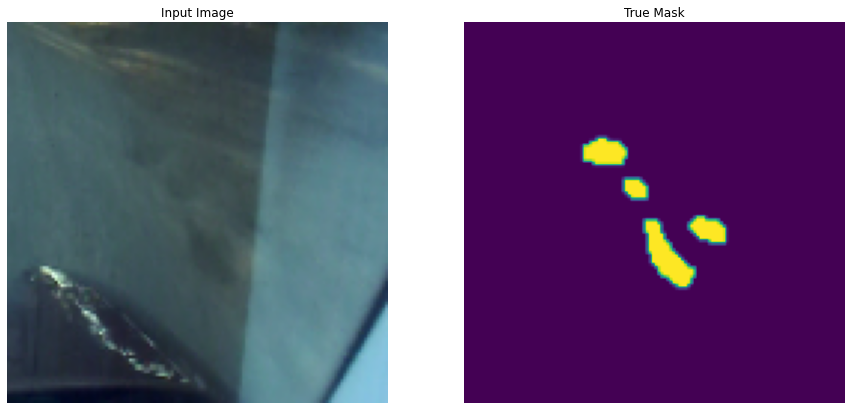

In [22]:
displayNDataset(train_batches, use_depth=DATA_TYPE)

### Show some Test/Validation Data

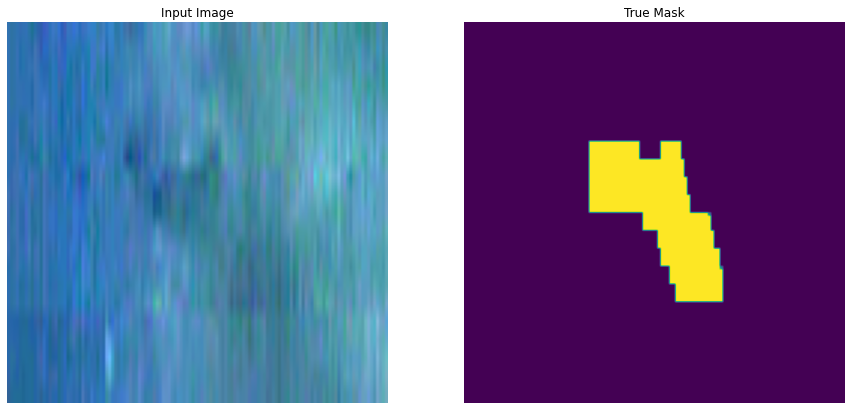

In [23]:
displayNDataset(test_batches, use_depth=DATA_TYPE)

### Show some Verification Data

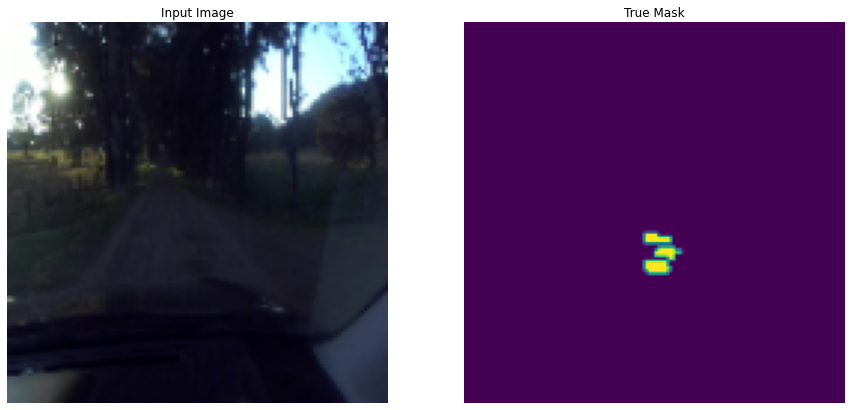

In [24]:
displayNDataset(ver_batches, use_depth=DATA_TYPE)

## Define Model

In [25]:
MODEL_NAME = f"{MODEL_TYPE}_{MODEL_MOD}"
if DATA_TYPE:
    MODEL_NAME +="_Depth"

# Imported variables include:
#   - MODEL_NAME
#   - model

if MODEL_NAME == 'MobileNetV2_Sequential':
    from MobileNetV2_Sequential import *
if MODEL_NAME == 'MobileNetV2_Sequential_Depth':
    from MobileNetV2_Sequential_Depth import *
if MODEL_NAME == 'MobileNetV2_UNet':
    from MobileNetV2_UNet import *
if MODEL_NAME == 'MobileNetV2_UNet_Depth':
    from MobileNetV2_UNet_Depth import *
if MODEL_NAME == 'VGG16_Sequential':
    from VGG16_Sequential import *
if MODEL_NAME == 'VGG16_Sequential_Depth':
    from VGG16_Sequential_Depth import *
if MODEL_NAME == 'VGG16_UNet':
    from VGG16_UNet import *
if MODEL_NAME == 'VGG16_UNet_Depth':
    from VGG16_UNet_Depth import *

block_11_expand_BN (None, 8, 8, 576)
block_12_expand_BN (None, 8, 8, 576)
block_13_expand_BN (None, 8, 8, 576)
Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 64, 64, 32)   864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 64, 64, 32)   128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 64, 64, 32)   0           bn_Conv1[0][0]   

In [26]:
if DEBUG:
    model.summary()

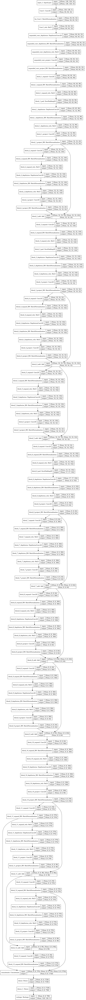

In [27]:
tf.keras.utils.plot_model(model, to_file=f"{MODEL_NAME}.png", show_shapes=True)

To compare to the printed out summary of the model, look at the resulting model architecture:

## Determine Folder Name

In [28]:
folder_name = ''

if DATASET_TYPE.split("_")[1] == "pothole" and MODIFIED_DATASET:
    folder_name += MOD_STR.capitalize()

folder_name += DATASET_TYPE.capitalize()
folder_name += "-"
folder_name += MODEL_NAME
print(folder_name)

Modified_Unsealed_pothole-MobileNetV2_Sequential


## Define Variables to be Measured

In [29]:
from tensorflow.keras import backend as bkEnd
# Note that type(t_.* ) == <class 'tensorflow.python.framework.ops.Tensor'>
from sklearn.metrics import confusion_matrix

def confusion_matrix(t_true, t_pred):
    t_true = bkEnd.round(bkEnd.clip(t_true, 0, 1))
    t_pred = bkEnd.round(bkEnd.clip(t_pred, 0, 1))
    not_true = bkEnd.ones(t_true.shape)-t_true
    not_pred = bkEnd.ones(t_pred.shape)-t_pred
    true_positives = bkEnd.sum(t_true*t_pred).numpy()
    true_negatives = bkEnd.sum(not_true*not_pred).numpy()
    false_positives = bkEnd.sum(not_true*t_pred).numpy()
    false_negatives = bkEnd.sum(t_true*not_pred).numpy()
    return {
        'tp': true_positives,
        'fp': false_positives,
        'fn': false_negatives,
        'tn': true_negatives }

def accuracy(t_true, t_pred):
    t_true = bkEnd.round(bkEnd.clip(t_true, 0, 1))
    t_pred = bkEnd.round(bkEnd.clip(t_pred, 0, 1))
    not_true = bkEnd.ones(t_true.shape)-t_true
    not_pred = bkEnd.ones(t_pred.shape)-t_pred
    true_positives = bkEnd.sum(t_true * t_pred)
    true_negatives = bkEnd.sum(not_true*not_pred)
    calc_accuracy = (true_positives+true_negatives) / bkEnd.sum(bkEnd.ones(t_true.shape))
    return calc_accuracy

def recall(t_true, t_pred):
    true_positives = bkEnd.sum(bkEnd.round(bkEnd.clip(t_true * t_pred, 0, 1)))
    possible_positives = bkEnd.sum(bkEnd.round(bkEnd.clip(t_true, 0, 1)))
    calc_recall = true_positives / (possible_positives + bkEnd.epsilon())
    return calc_recall

def precision(t_true, t_pred):
    true_positives = bkEnd.sum(bkEnd.round(bkEnd.clip(t_true * t_pred, 0, 1)))
    predicted_positives = bkEnd.sum(bkEnd.round(bkEnd.clip(t_pred, 0, 1)))
    calc_precision = true_positives / (predicted_positives + bkEnd.epsilon())
    return calc_precision

def f1(t_true, t_pred):
    calc_precision = precision(t_true, t_pred)
    calc_recall = recall(t_true, t_pred)
    calc_f1 = 2*((calc_precision*calc_recall)/(calc_precision+calc_recall+bkEnd.epsilon()))
    return calc_f1

## Define Result Displaying Functions

`create_mask` function, when running inference, assigns the channel with the highest value as a label to the pixel.

In [30]:
def obtainSampleImages(use_depth=False):
    for images, mask in test_batches.take(1):
        sample_mask = mask[0]
        debug("obtainSampleImages - INFO: sample_mask.shape = {sample_mask.shape}")

        if use_depth:
            sample_image = images[0][0]
            debug("obtainSampleImages - INFO: sample_image.shape = {sample_image.shape}")
            sample_depth = images[1][0]
            debug("obtainSampleImages - INFO: sample_depth.shape = {sample_depth.shape}")
            return sample_image, sample_depth, sample_mask

        sample_image = images[0]
        debug("obtainSampleImages - INFO: sample_image.shape = {sample_image.shape}")
        return sample_image, None, sample_mask
    
sample_image, sample_depth, sample_mask = obtainSampleImages(use_depth=DATA_TYPE)

In [31]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]

In [32]:
# Default to the test/varification dataset
def show_predictions(dataset=test_batches, n=1):
    for images, mask in dataset.take(n):
        pred_mask = model.predict(images)
        
        if DATA_TYPE:
            displayImages([images[0][0], images[1][0], mask[0], create_mask(pred_mask)], \
                          use_depth=DATA_TYPE)
            continue
        
        displayImages([images[0], mask[0], create_mask(pred_mask)], \
                      use_depth=DATA_TYPE)

## Compile the Model

Since this is a multiclass classification problem a `CategoricalCrossentropy` with `from_logits=True` is the standard loss function. Use `losses.SparseCategoricalCrossentropy(from_logits=True)` since the labels are scalar integers for each pixel instead of vectors of scores for each class.

In [33]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.002),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy', f1, precision, recall])

Try out the model to see what it predicts before training.

2021-11-03 11:09:50.208137: I tensorflow/stream_executor/cuda/cuda_dnn.cc:369] Loaded cuDNN version 8202
2021-11-03 11:09:50.470213: I tensorflow/core/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory


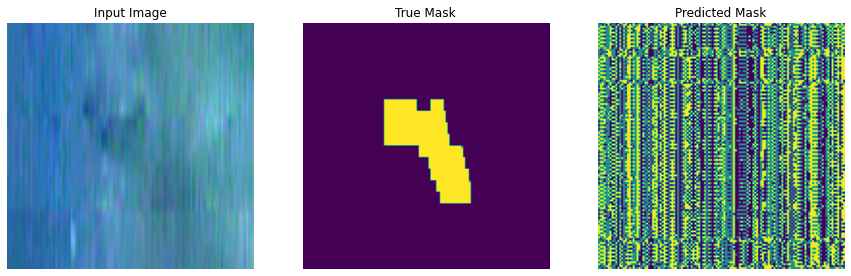

In [34]:
show_predictions()

Create the image:
- after_epoch_0.png

## Define Callbacks (for use during training)

The callback defined below is used to observe how the model improves while it is training.

In [35]:
EPOCHS = 500
VAL_SUBSPLITS = 1 # Originally 5
VALIDATION_STEPS = info.splits['test'].num_examples//BATCH_SIZE//VAL_SUBSPLITS
print(f"VALIDATION_STEPS = {VALIDATION_STEPS}")
print(f"info.splits['test'].num_examples = {info.splits['test'].num_examples}")

MONITOR = 'val_loss'
MODE = 'min'

VALIDATION_STEPS = 3
info.splits['test'].num_examples = 7


In [36]:
class DisplayCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs=None):
    #clear_output(wait=True)
    show_predictions()
    print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [37]:
# checkpoint filepath from https://machinelearningmastery.com/check-point-deep-learning-models-keras/
# :06.2f <- 0 pre-filled 6 char long value (including '.') with 2 decimal points float
checkpoint_filepath = WEIGHTS_FOLDER


if DATASET_TYPE.split("_")[1] == "pothole" and MODIFIED_DATASET:
    checkpoint_filepath += MOD_STR

checkpoint_filepath += DATASET_TYPE
checkpoint_filepath += "-"
checkpoint_filepath += MODEL_NAME
checkpoint_filepath += "-"
checkpoint_filepath += "weights-improvement-{epoch:04d}-{val_loss:.2f}-{val_accuracy:.2f}.hdf5"
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor=MONITOR,
    mode=MODE,
    verbose=1,
    save_best_only=True)

In [38]:
early_stopping_callback = tf.keras.callbacks.EarlyStopping(
        monitor=MONITOR,
        mode=MODE,
        verbose=1,
        patience=EPOCHS*0.1,)

## Train the Model 

Epoch 1/500
14/14 [==============================] - 3s 52ms/step - loss: 1.8029 - accuracy: 0.8062 - f1: 0.1853 - precision: 0.1039 - recall: 1.4418 - val_loss: 3.1497 - val_accuracy: 0.9120 - val_f1: 0.1599 - val_precision: 0.0873 - val_recall: 1.3978


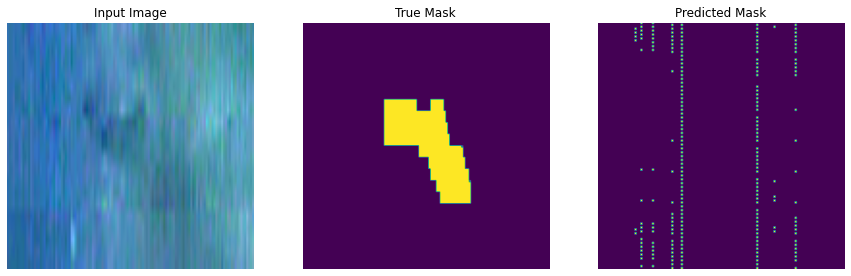


Sample Prediction after epoch 1


Epoch 00001: val_loss improved from inf to 3.14966, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0001-3.15-0.91.hdf5
Epoch 2/500
14/14 [==============================] - 0s 17ms/step - loss: 0.8064 - accuracy: 0.8624 - f1: 0.2163 - precision: 0.1204 - recall: 1.5580 - val_loss: 4.8660 - val_accuracy: 0.8886 - val_f1: 0.1464 - val_precision: 0.0802 - val_recall: 1.2284


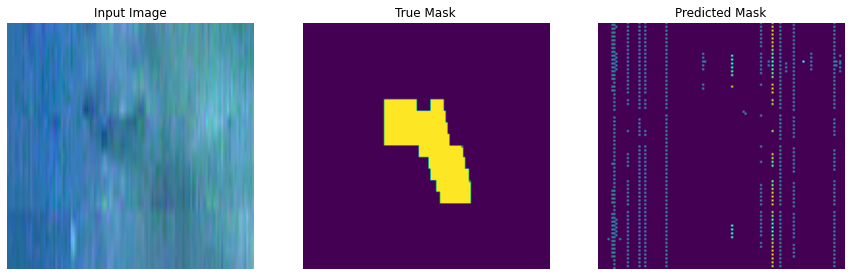


Sample Prediction after epoch 2


Epoch 00002: val_loss did not improve from 3.14966
Epoch 3/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3422 - accuracy: 0.8883 - f1: 0.1984 - precision: 0.1094 - recall: 1.5806 - val_loss: 5.8201 - val_accuracy: 0.8874 - val_f1: 0.1479 - val_precision: 0.0811 - val_recall: 1.2367


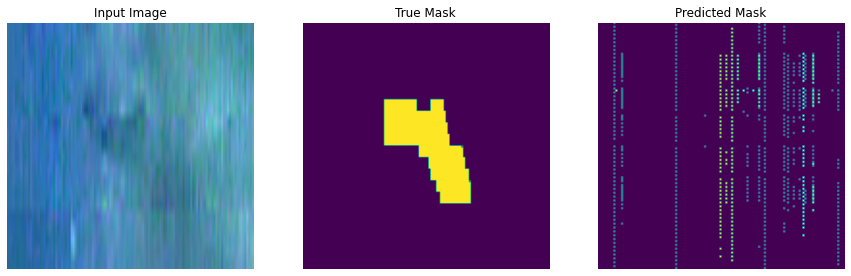


Sample Prediction after epoch 3


Epoch 00003: val_loss did not improve from 3.14966
Epoch 4/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3693 - accuracy: 0.8739 - f1: 0.1930 - precision: 0.1113 - recall: 1.3363 - val_loss: 2.7996 - val_accuracy: 0.9115 - val_f1: 0.1566 - val_precision: 0.0862 - val_recall: 1.2545


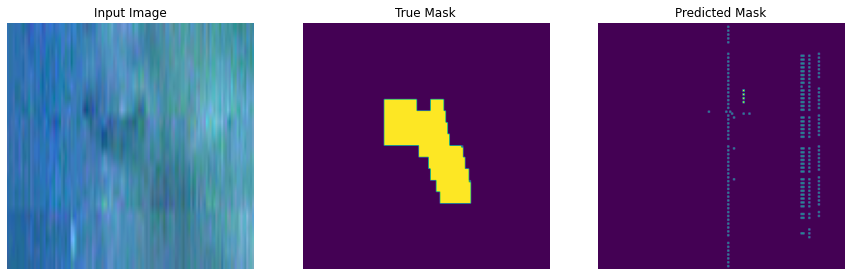


Sample Prediction after epoch 4


Epoch 00004: val_loss improved from 3.14966 to 2.79963, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0004-2.80-0.91.hdf5
Epoch 5/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3259 - accuracy: 0.8863 - f1: 0.1911 - precision: 0.1087 - recall: 1.4322 - val_loss: 3.2440 - val_accuracy: 0.9091 - val_f1: 0.1458 - val_precision: 0.0804 - val_recall: 1.1465


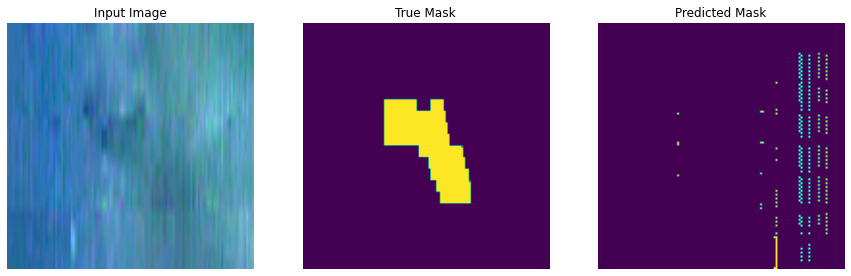


Sample Prediction after epoch 5


Epoch 00005: val_loss did not improve from 2.79963
Epoch 6/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3026 - accuracy: 0.8854 - f1: 0.1870 - precision: 0.1091 - recall: 1.3781 - val_loss: 3.9227 - val_accuracy: 0.9150 - val_f1: 0.1499 - val_precision: 0.0825 - val_recall: 1.2094


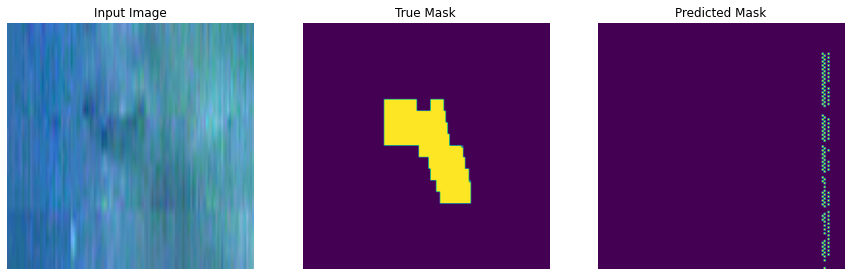


Sample Prediction after epoch 6


Epoch 00006: val_loss did not improve from 2.79963
Epoch 7/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3199 - accuracy: 0.8707 - f1: 0.2068 - precision: 0.1188 - recall: 1.3035 - val_loss: 3.9753 - val_accuracy: 0.9191 - val_f1: 0.1396 - val_precision: 0.0774 - val_recall: 1.0322


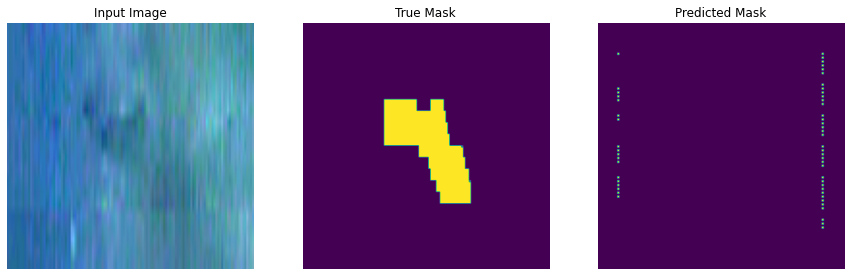


Sample Prediction after epoch 7


Epoch 00007: val_loss did not improve from 2.79963
Epoch 8/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2839 - accuracy: 0.8846 - f1: 0.1915 - precision: 0.1081 - recall: 1.2557 - val_loss: 2.0876 - val_accuracy: 0.9222 - val_f1: 0.1523 - val_precision: 0.0842 - val_recall: 1.1579


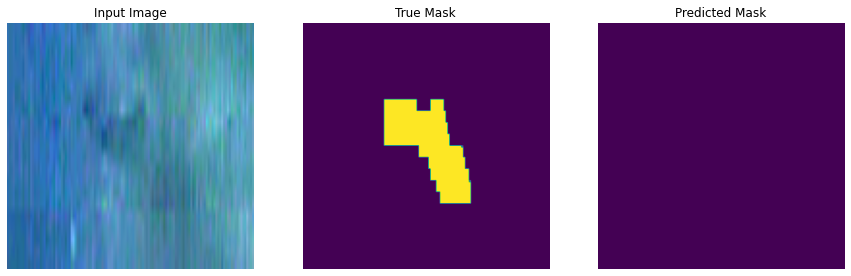


Sample Prediction after epoch 8


Epoch 00008: val_loss improved from 2.79963 to 2.08757, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0008-2.09-0.92.hdf5
Epoch 9/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2664 - accuracy: 0.8905 - f1: 0.1805 - precision: 0.1025 - recall: 1.3566 - val_loss: 1.4042 - val_accuracy: 0.9188 - val_f1: 0.1453 - val_precision: 0.0803 - val_recall: 1.1095


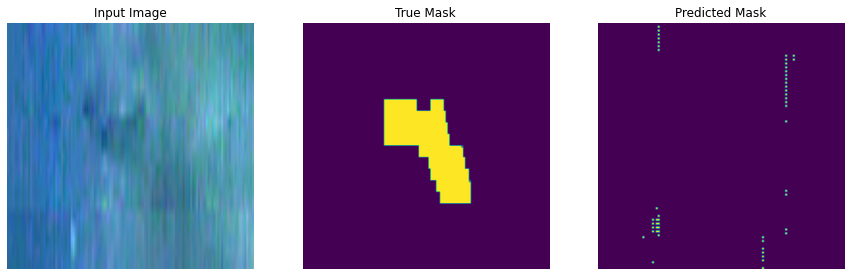


Sample Prediction after epoch 9


Epoch 00009: val_loss improved from 2.08757 to 1.40418, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0009-1.40-0.92.hdf5
Epoch 10/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1734 - accuracy: 0.9193 - f1: 0.1969 - precision: 0.1081 - recall: 1.3957 - val_loss: 2.2464 - val_accuracy: 0.9222 - val_f1: 0.1406 - val_precision: 0.0780 - val_recall: 1.0397


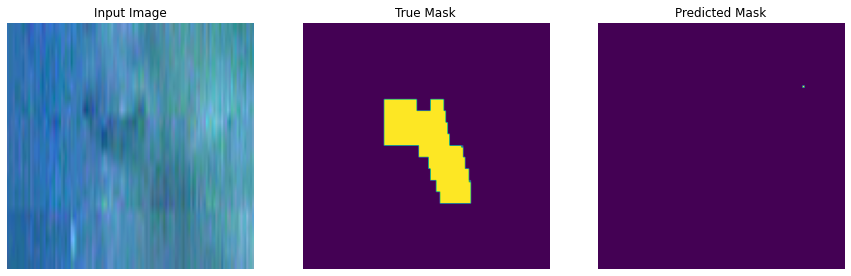


Sample Prediction after epoch 10


Epoch 00010: val_loss did not improve from 1.40418
Epoch 11/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2319 - accuracy: 0.9094 - f1: 0.1934 - precision: 0.1090 - recall: 1.3905 - val_loss: 1.3881 - val_accuracy: 0.9225 - val_f1: 0.1482 - val_precision: 0.0822 - val_recall: 1.0989


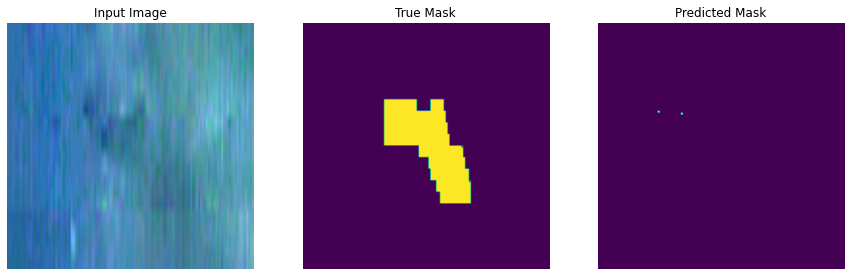


Sample Prediction after epoch 11


Epoch 00011: val_loss improved from 1.40418 to 1.38806, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0011-1.39-0.92.hdf5
Epoch 12/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2336 - accuracy: 0.9004 - f1: 0.2062 - precision: 0.1150 - recall: 1.3277 - val_loss: 2.3967 - val_accuracy: 0.9137 - val_f1: 0.1391 - val_precision: 0.0771 - val_recall: 1.0464


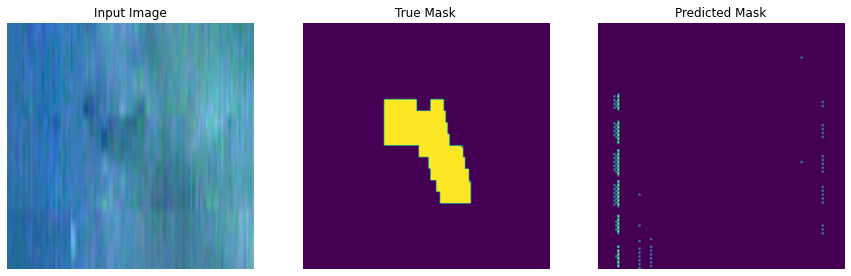


Sample Prediction after epoch 12


Epoch 00012: val_loss did not improve from 1.38806
Epoch 13/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2168 - accuracy: 0.8986 - f1: 0.1957 - precision: 0.1107 - recall: 1.2249 - val_loss: 2.2537 - val_accuracy: 0.9152 - val_f1: 0.1443 - val_precision: 0.0798 - val_recall: 1.1086


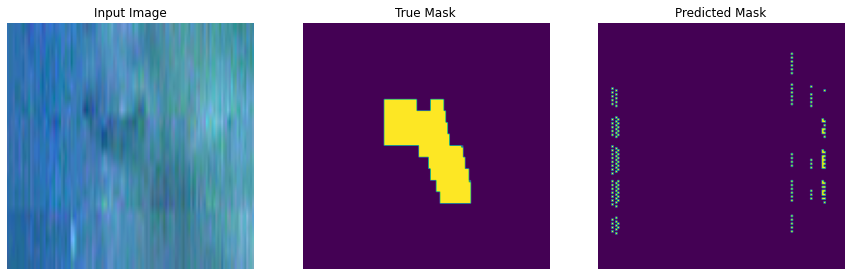


Sample Prediction after epoch 13


Epoch 00013: val_loss did not improve from 1.38806
Epoch 14/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1464 - accuracy: 0.9302 - f1: 0.1802 - precision: 0.1003 - recall: 1.2876 - val_loss: 2.6352 - val_accuracy: 0.9153 - val_f1: 0.1386 - val_precision: 0.0769 - val_recall: 1.0333


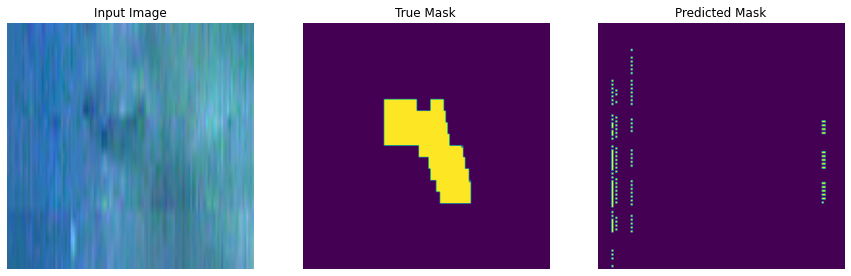


Sample Prediction after epoch 14


Epoch 00014: val_loss did not improve from 1.38806
Epoch 15/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1580 - accuracy: 0.9311 - f1: 0.1893 - precision: 0.1063 - recall: 1.3631 - val_loss: 3.6232 - val_accuracy: 0.9068 - val_f1: 0.1358 - val_precision: 0.0754 - val_recall: 1.0084


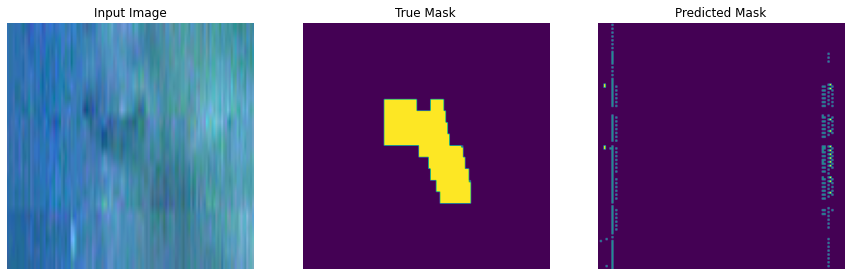


Sample Prediction after epoch 15


Epoch 00015: val_loss did not improve from 1.38806
Epoch 16/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1849 - accuracy: 0.9149 - f1: 0.1784 - precision: 0.1003 - recall: 1.2370 - val_loss: 1.4993 - val_accuracy: 0.9187 - val_f1: 0.1424 - val_precision: 0.0788 - val_recall: 1.0766


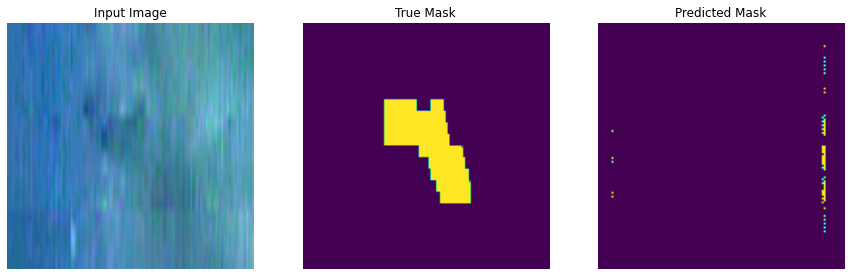


Sample Prediction after epoch 16


Epoch 00016: val_loss did not improve from 1.38806
Epoch 17/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1829 - accuracy: 0.9181 - f1: 0.1792 - precision: 0.1008 - recall: 1.1862 - val_loss: 2.1933 - val_accuracy: 0.9126 - val_f1: 0.1391 - val_precision: 0.0770 - val_recall: 1.0545


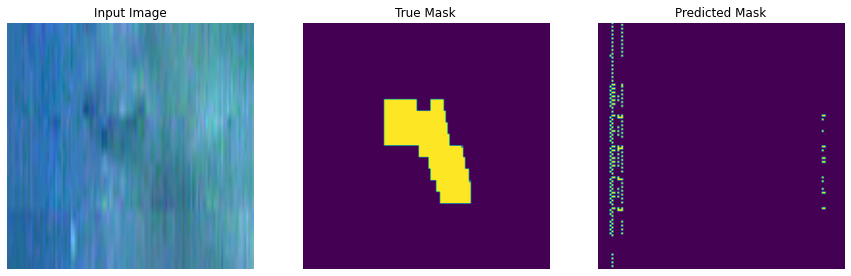


Sample Prediction after epoch 17


Epoch 00017: val_loss did not improve from 1.38806
Epoch 18/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3504 - accuracy: 0.8717 - f1: 0.2214 - precision: 0.1280 - recall: 1.3418 - val_loss: 1.3516 - val_accuracy: 0.9216 - val_f1: 0.1711 - val_precision: 0.0931 - val_recall: 1.5540


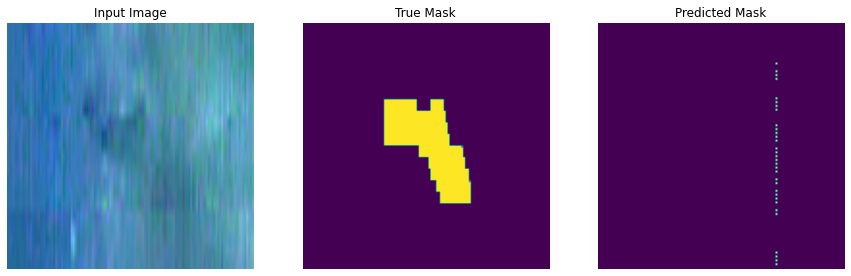


Sample Prediction after epoch 18


Epoch 00018: val_loss improved from 1.38806 to 1.35162, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0018-1.35-0.92.hdf5
Epoch 19/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2243 - accuracy: 0.9108 - f1: 0.2006 - precision: 0.1100 - recall: 1.7027 - val_loss: 1.9096 - val_accuracy: 0.9225 - val_f1: 0.1592 - val_precision: 0.0875 - val_recall: 1.2938


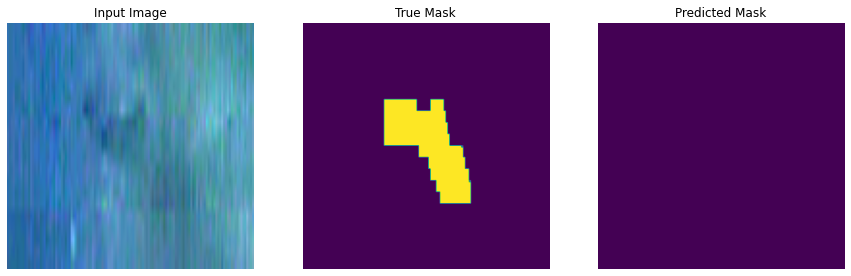


Sample Prediction after epoch 19


Epoch 00019: val_loss did not improve from 1.35162
Epoch 20/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1980 - accuracy: 0.9122 - f1: 0.2050 - precision: 0.1149 - recall: 1.4697 - val_loss: 1.4079 - val_accuracy: 0.9218 - val_f1: 0.1402 - val_precision: 0.0776 - val_recall: 1.0689


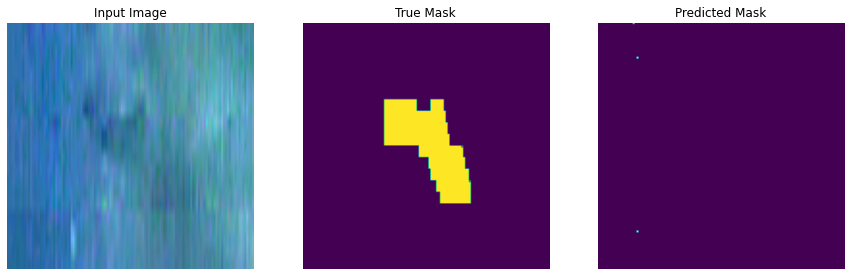


Sample Prediction after epoch 20


Epoch 00020: val_loss did not improve from 1.35162
Epoch 21/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3246 - accuracy: 0.8763 - f1: 0.2227 - precision: 0.1321 - recall: 1.3576 - val_loss: 2.7581 - val_accuracy: 0.9220 - val_f1: 0.1651 - val_precision: 0.0895 - val_recall: 1.5776


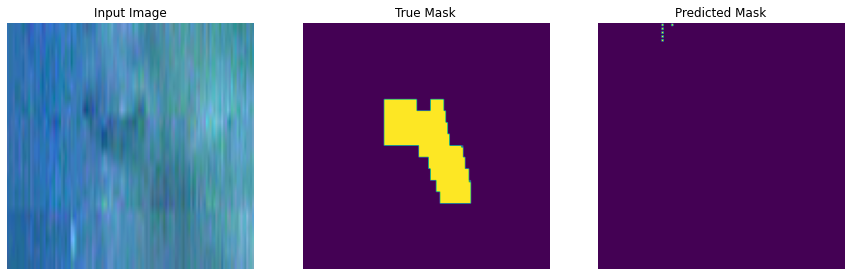


Sample Prediction after epoch 21


Epoch 00021: val_loss did not improve from 1.35162
Epoch 22/500
14/14 [==============================] - 0s 17ms/step - loss: 0.6994 - accuracy: 0.8623 - f1: 0.1935 - precision: 0.1071 - recall: 1.5210 - val_loss: 15.9415 - val_accuracy: 0.9218 - val_f1: 0.1424 - val_precision: 0.0789 - val_recall: 1.0743


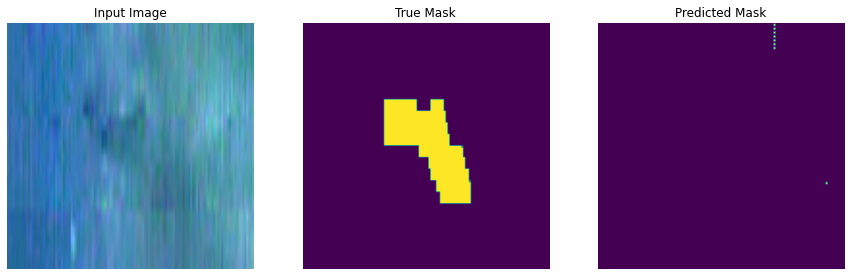


Sample Prediction after epoch 22


Epoch 00022: val_loss did not improve from 1.35162
Epoch 23/500
14/14 [==============================] - 0s 17ms/step - loss: 0.4396 - accuracy: 0.9002 - f1: 0.1858 - precision: 0.1034 - recall: 1.3789 - val_loss: 17.5870 - val_accuracy: 0.8949 - val_f1: 0.1432 - val_precision: 0.0789 - val_recall: 1.1381


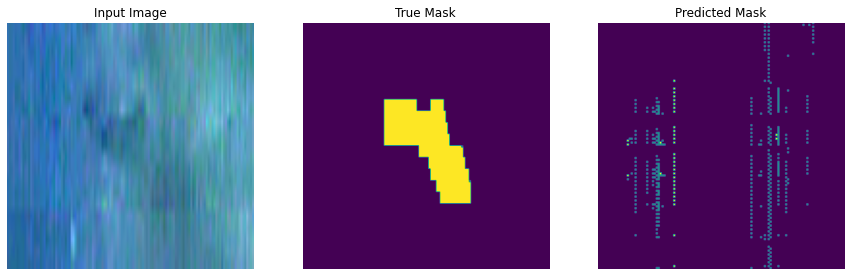


Sample Prediction after epoch 23


Epoch 00023: val_loss did not improve from 1.35162
Epoch 24/500
14/14 [==============================] - 0s 17ms/step - loss: 1.4159 - accuracy: 0.8501 - f1: 0.2121 - precision: 0.1196 - recall: 1.4221 - val_loss: 174.5024 - val_accuracy: 0.9193 - val_f1: 0.1377 - val_precision: 0.0761 - val_recall: 1.0548


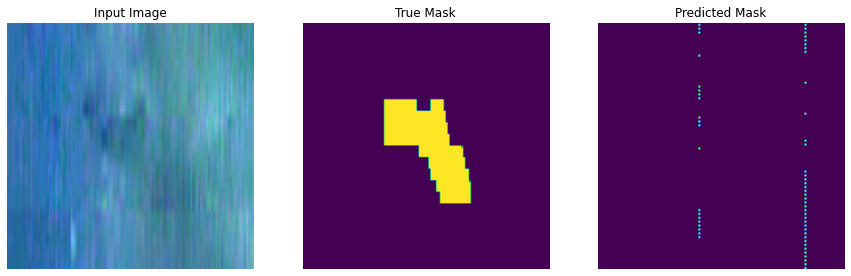


Sample Prediction after epoch 24


Epoch 00024: val_loss did not improve from 1.35162
Epoch 25/500
14/14 [==============================] - 0s 17ms/step - loss: 2.8535 - accuracy: 0.8237 - f1: 0.2438 - precision: 0.1384 - recall: 1.3271 - val_loss: 149.5405 - val_accuracy: 0.8874 - val_f1: 0.1350 - val_precision: 0.0741 - val_recall: 1.1046


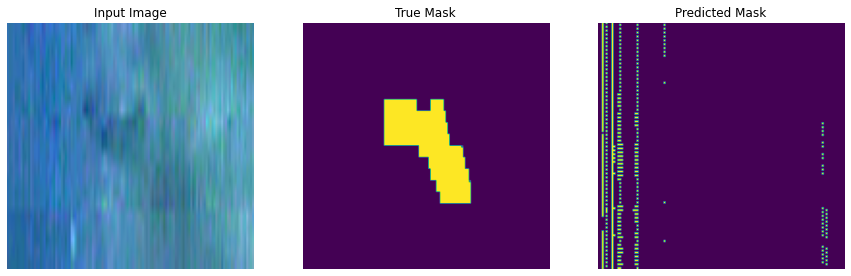


Sample Prediction after epoch 25


Epoch 00025: val_loss did not improve from 1.35162
Epoch 26/500
14/14 [==============================] - 0s 17ms/step - loss: 2.2079 - accuracy: 0.8269 - f1: 0.2036 - precision: 0.1227 - recall: 1.3469 - val_loss: 86.6866 - val_accuracy: 0.9119 - val_f1: 0.1385 - val_precision: 0.0765 - val_recall: 1.0708


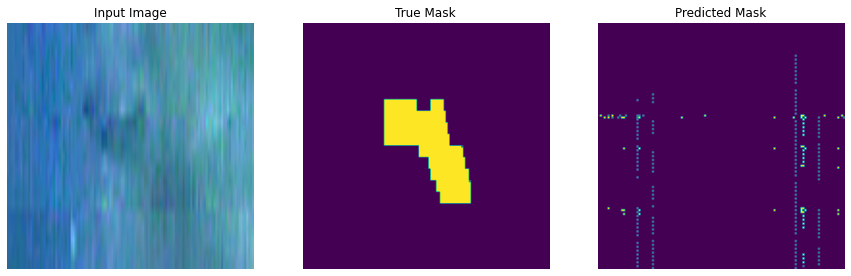


Sample Prediction after epoch 26


Epoch 00026: val_loss did not improve from 1.35162
Epoch 27/500
14/14 [==============================] - 0s 17ms/step - loss: 1.1923 - accuracy: 0.8613 - f1: 0.1840 - precision: 0.1056 - recall: 1.2963 - val_loss: 53.9284 - val_accuracy: 0.9216 - val_f1: 0.1442 - val_precision: 0.0799 - val_recall: 1.0873


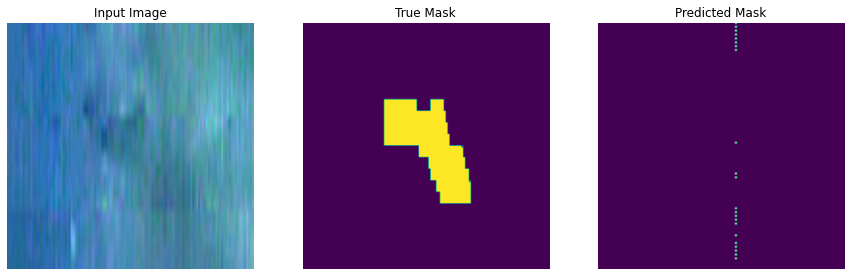


Sample Prediction after epoch 27


Epoch 00027: val_loss did not improve from 1.35162
Epoch 28/500
14/14 [==============================] - 0s 17ms/step - loss: 1.1768 - accuracy: 0.8368 - f1: 0.2059 - precision: 0.1202 - recall: 1.1779 - val_loss: 31.2275 - val_accuracy: 0.9204 - val_f1: 0.1437 - val_precision: 0.0795 - val_recall: 1.1002


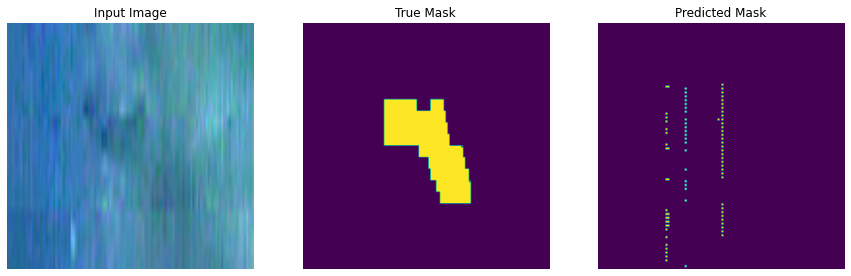


Sample Prediction after epoch 28


Epoch 00028: val_loss did not improve from 1.35162
Epoch 29/500
14/14 [==============================] - 0s 17ms/step - loss: 0.4991 - accuracy: 0.8525 - f1: 0.1836 - precision: 0.1059 - recall: 1.1350 - val_loss: 30.6319 - val_accuracy: 0.9220 - val_f1: 0.1360 - val_precision: 0.0753 - val_recall: 1.0181


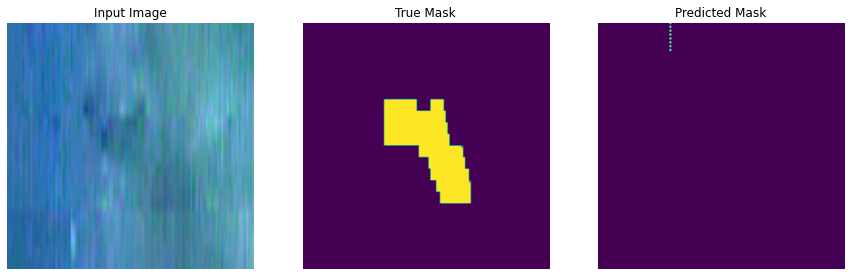


Sample Prediction after epoch 29


Epoch 00029: val_loss did not improve from 1.35162
Epoch 30/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2203 - accuracy: 0.9072 - f1: 0.1328 - precision: 0.0726 - recall: 1.1079 - val_loss: 28.2726 - val_accuracy: 0.9224 - val_f1: 0.1378 - val_precision: 0.0765 - val_recall: 1.0116


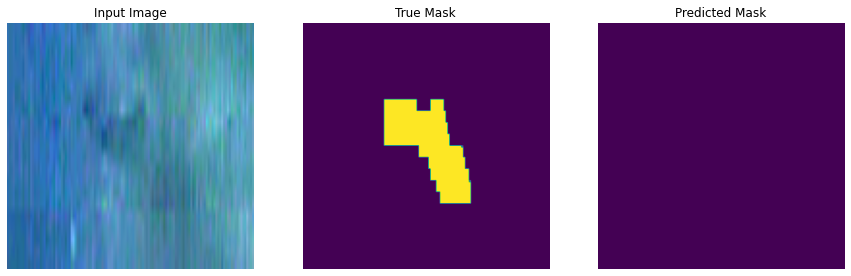


Sample Prediction after epoch 30


Epoch 00030: val_loss did not improve from 1.35162
Epoch 31/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2434 - accuracy: 0.9079 - f1: 0.1511 - precision: 0.0843 - recall: 0.9772 - val_loss: 23.0388 - val_accuracy: 0.9221 - val_f1: 0.1357 - val_precision: 0.0752 - val_recall: 1.0245


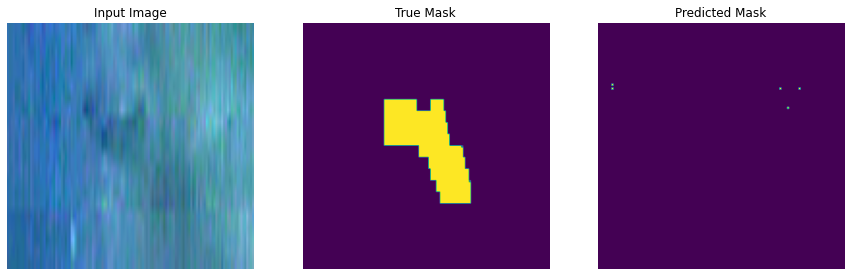


Sample Prediction after epoch 31


Epoch 00031: val_loss did not improve from 1.35162
Epoch 32/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2425 - accuracy: 0.8878 - f1: 0.1530 - precision: 0.0900 - recall: 0.8978 - val_loss: 21.4158 - val_accuracy: 0.9188 - val_f1: 0.1359 - val_precision: 0.0754 - val_recall: 1.0101


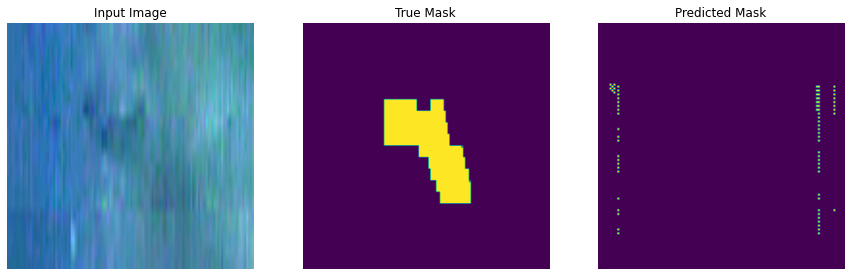


Sample Prediction after epoch 32


Epoch 00032: val_loss did not improve from 1.35162
Epoch 33/500
14/14 [==============================] - 0s 17ms/step - loss: 0.4302 - accuracy: 0.8605 - f1: 0.1992 - precision: 0.1187 - recall: 0.9616 - val_loss: 12.9189 - val_accuracy: 0.9225 - val_f1: 0.1395 - val_precision: 0.0774 - val_recall: 1.0331


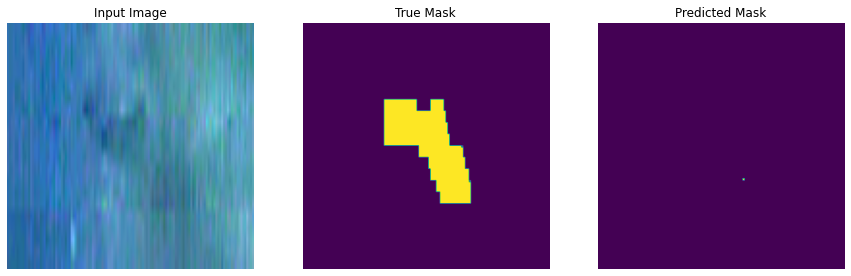


Sample Prediction after epoch 33


Epoch 00033: val_loss did not improve from 1.35162
Epoch 34/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2111 - accuracy: 0.9013 - f1: 0.1539 - precision: 0.0873 - recall: 1.0241 - val_loss: 14.3640 - val_accuracy: 0.9221 - val_f1: 0.1363 - val_precision: 0.0756 - val_recall: 1.0110


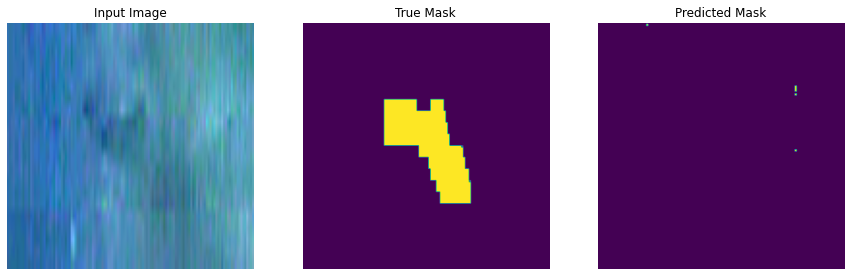


Sample Prediction after epoch 34


Epoch 00034: val_loss did not improve from 1.35162
Epoch 35/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2592 - accuracy: 0.8972 - f1: 0.1534 - precision: 0.0889 - recall: 0.9473 - val_loss: 11.0470 - val_accuracy: 0.9202 - val_f1: 0.1343 - val_precision: 0.0744 - val_recall: 1.0047


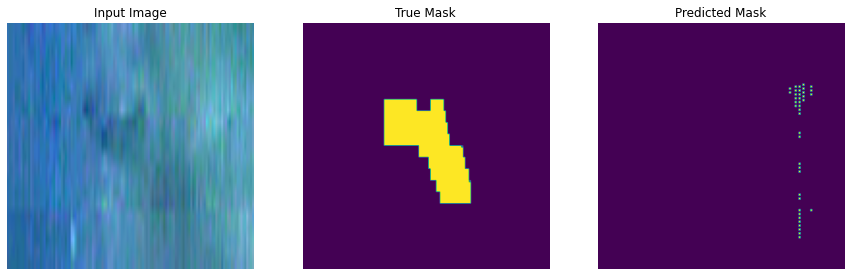


Sample Prediction after epoch 35


Epoch 00035: val_loss did not improve from 1.35162
Epoch 36/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1714 - accuracy: 0.9209 - f1: 0.1392 - precision: 0.0769 - recall: 1.0173 - val_loss: 8.8862 - val_accuracy: 0.9157 - val_f1: 0.1343 - val_precision: 0.0744 - val_recall: 1.0124


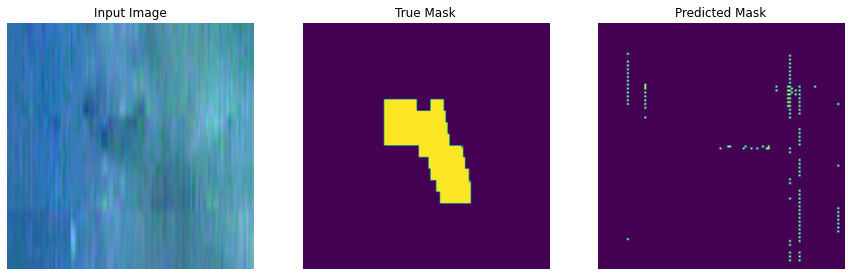


Sample Prediction after epoch 36


Epoch 00036: val_loss did not improve from 1.35162
Epoch 37/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2248 - accuracy: 0.9115 - f1: 0.1674 - precision: 0.0952 - recall: 1.0058 - val_loss: 11.8028 - val_accuracy: 0.8945 - val_f1: 0.1351 - val_precision: 0.0748 - val_recall: 1.0136


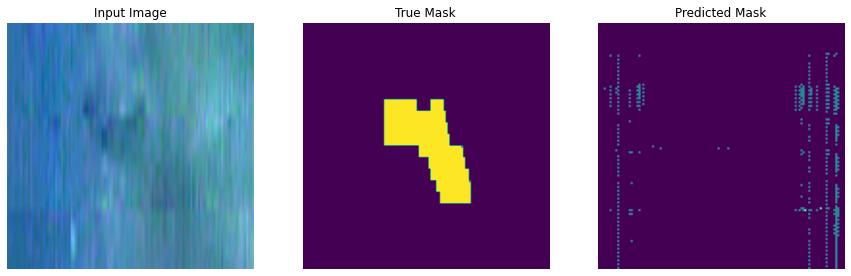


Sample Prediction after epoch 37


Epoch 00037: val_loss did not improve from 1.35162
Epoch 38/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2119 - accuracy: 0.9077 - f1: 0.1550 - precision: 0.0883 - recall: 0.9072 - val_loss: 9.7610 - val_accuracy: 0.9214 - val_f1: 0.1378 - val_precision: 0.0766 - val_recall: 1.0018


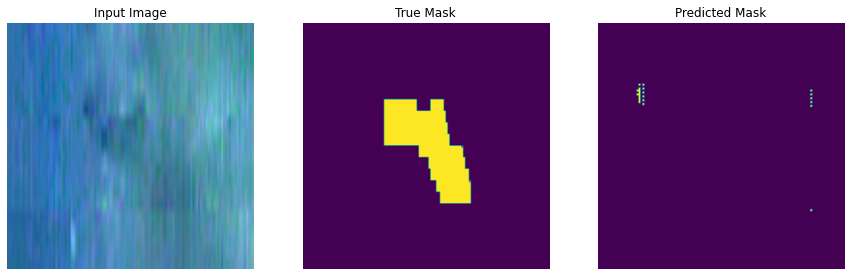


Sample Prediction after epoch 38


Epoch 00038: val_loss did not improve from 1.35162
Epoch 39/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2461 - accuracy: 0.9096 - f1: 0.1471 - precision: 0.0864 - recall: 0.9329 - val_loss: 5.4541 - val_accuracy: 0.9037 - val_f1: 0.1409 - val_precision: 0.0778 - val_recall: 1.0792


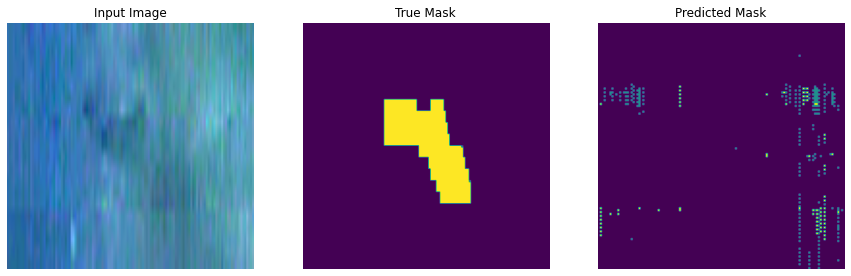


Sample Prediction after epoch 39


Epoch 00039: val_loss did not improve from 1.35162
Epoch 40/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1854 - accuracy: 0.9173 - f1: 0.1528 - precision: 0.0864 - recall: 0.8918 - val_loss: 4.4351 - val_accuracy: 0.8958 - val_f1: 0.1379 - val_precision: 0.0762 - val_recall: 1.0510


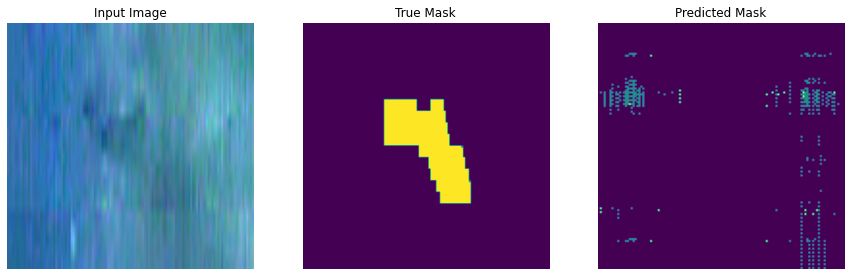


Sample Prediction after epoch 40


Epoch 00040: val_loss did not improve from 1.35162
Epoch 41/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1863 - accuracy: 0.9103 - f1: 0.1587 - precision: 0.0921 - recall: 0.9590 - val_loss: 4.8469 - val_accuracy: 0.8977 - val_f1: 0.1347 - val_precision: 0.0745 - val_recall: 1.0220


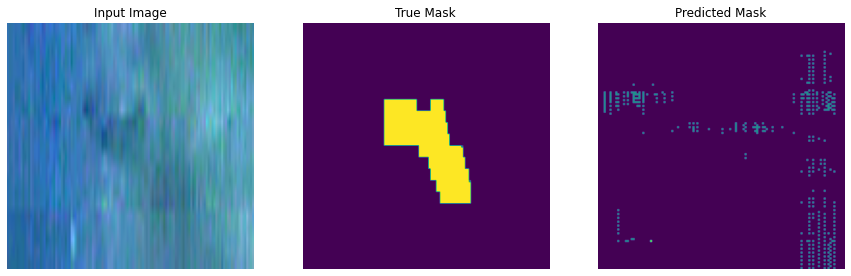


Sample Prediction after epoch 41


Epoch 00041: val_loss did not improve from 1.35162
Epoch 42/500
14/14 [==============================] - 0s 16ms/step - loss: 0.2191 - accuracy: 0.8966 - f1: 0.1589 - precision: 0.0953 - recall: 0.9101 - val_loss: 4.1991 - val_accuracy: 0.9211 - val_f1: 0.1373 - val_precision: 0.0761 - val_recall: 1.0217


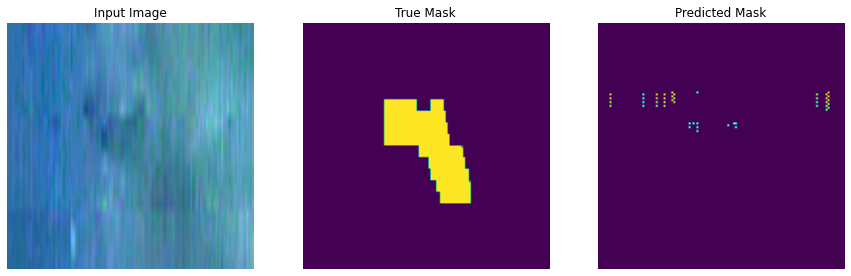


Sample Prediction after epoch 42


Epoch 00042: val_loss did not improve from 1.35162
Epoch 43/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2290 - accuracy: 0.9040 - f1: 0.1848 - precision: 0.1085 - recall: 1.0128 - val_loss: 2.8689 - val_accuracy: 0.9185 - val_f1: 0.1395 - val_precision: 0.0774 - val_recall: 1.0377


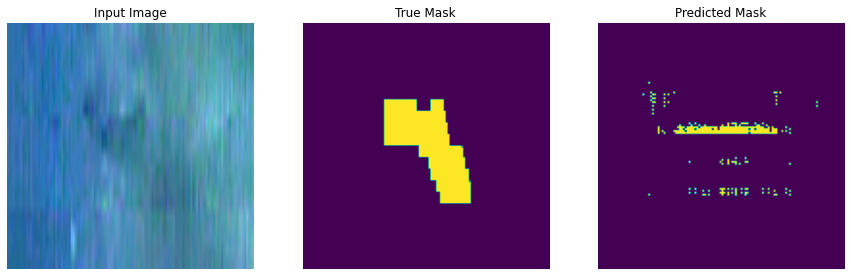


Sample Prediction after epoch 43


Epoch 00043: val_loss did not improve from 1.35162
Epoch 44/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1800 - accuracy: 0.9163 - f1: 0.1487 - precision: 0.0858 - recall: 0.8709 - val_loss: 2.6760 - val_accuracy: 0.9081 - val_f1: 0.1382 - val_precision: 0.0764 - val_recall: 1.0454


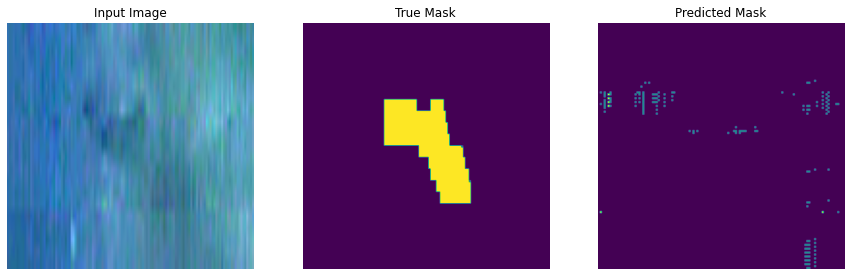


Sample Prediction after epoch 44


Epoch 00044: val_loss did not improve from 1.35162
Epoch 45/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1538 - accuracy: 0.9339 - f1: 0.1368 - precision: 0.0767 - recall: 0.9447 - val_loss: 2.9757 - val_accuracy: 0.8803 - val_f1: 0.1417 - val_precision: 0.0781 - val_recall: 1.0819


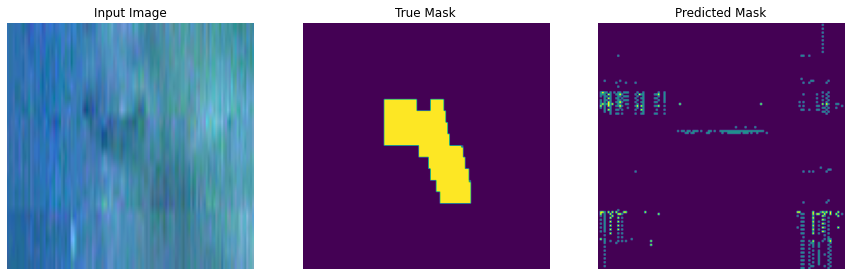


Sample Prediction after epoch 45


Epoch 00045: val_loss did not improve from 1.35162
Epoch 46/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1863 - accuracy: 0.9249 - f1: 0.1577 - precision: 0.0887 - recall: 0.9966 - val_loss: 3.1651 - val_accuracy: 0.8680 - val_f1: 0.1389 - val_precision: 0.0768 - val_recall: 1.0482


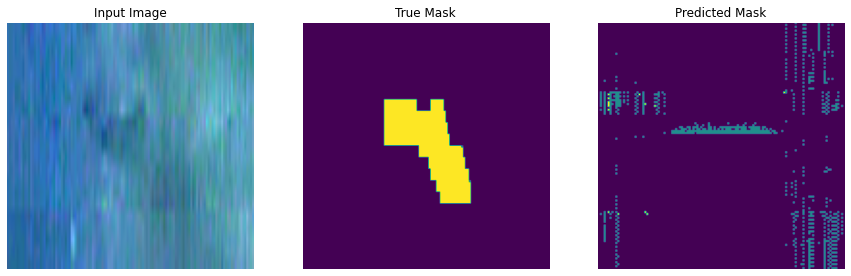


Sample Prediction after epoch 46


Epoch 00046: val_loss did not improve from 1.35162
Epoch 47/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1633 - accuracy: 0.9266 - f1: 0.1617 - precision: 0.0896 - recall: 0.9986 - val_loss: 2.1320 - val_accuracy: 0.9144 - val_f1: 0.1392 - val_precision: 0.0769 - val_recall: 1.0821


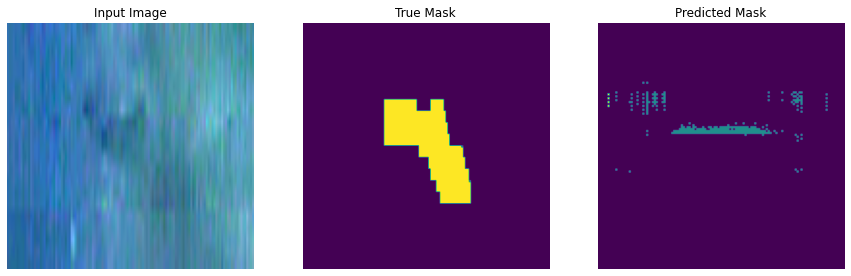


Sample Prediction after epoch 47


Epoch 00047: val_loss did not improve from 1.35162
Epoch 48/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1383 - accuracy: 0.9281 - f1: 0.1542 - precision: 0.0867 - recall: 1.0579 - val_loss: 2.3110 - val_accuracy: 0.9135 - val_f1: 0.1377 - val_precision: 0.0761 - val_recall: 1.0550


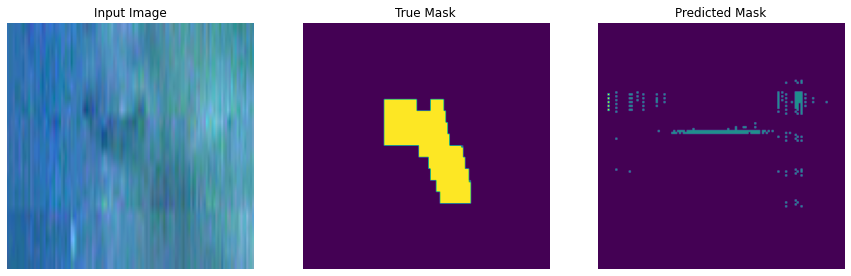


Sample Prediction after epoch 48


Epoch 00048: val_loss did not improve from 1.35162
Epoch 49/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2747 - accuracy: 0.9012 - f1: 0.1721 - precision: 0.1003 - recall: 0.9987 - val_loss: 1.0282 - val_accuracy: 0.8856 - val_f1: 0.1408 - val_precision: 0.0777 - val_recall: 1.1168


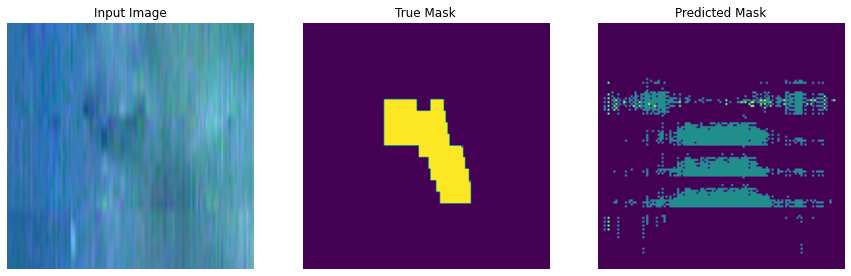


Sample Prediction after epoch 49


Epoch 00049: val_loss improved from 1.35162 to 1.02821, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0049-1.03-0.89.hdf5
Epoch 50/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2236 - accuracy: 0.9133 - f1: 0.1739 - precision: 0.1000 - recall: 1.0316 - val_loss: 2.0794 - val_accuracy: 0.8262 - val_f1: 0.1433 - val_precision: 0.0787 - val_recall: 1.1537


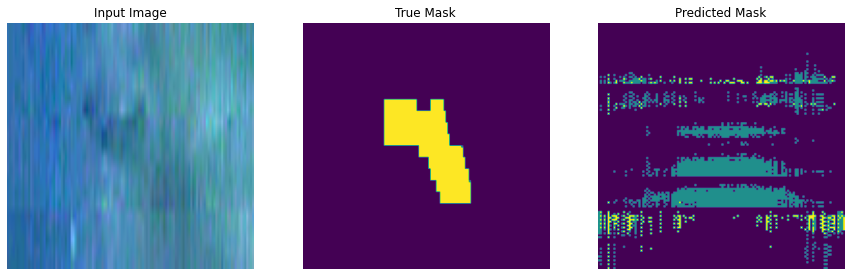


Sample Prediction after epoch 50


Epoch 00050: val_loss did not improve from 1.02821
Epoch 51/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1980 - accuracy: 0.9127 - f1: 0.1562 - precision: 0.0876 - recall: 1.0420 - val_loss: 3.4259 - val_accuracy: 0.7918 - val_f1: 0.1467 - val_precision: 0.0802 - val_recall: 1.2070


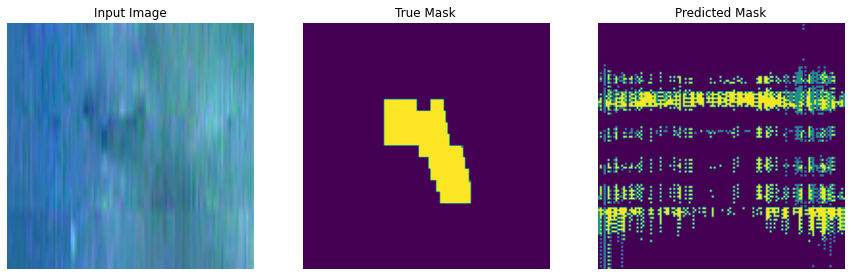


Sample Prediction after epoch 51


Epoch 00051: val_loss did not improve from 1.02821
Epoch 52/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2448 - accuracy: 0.8848 - f1: 0.1894 - precision: 0.1132 - recall: 1.0395 - val_loss: 2.3059 - val_accuracy: 0.8871 - val_f1: 0.1394 - val_precision: 0.0772 - val_recall: 1.0460


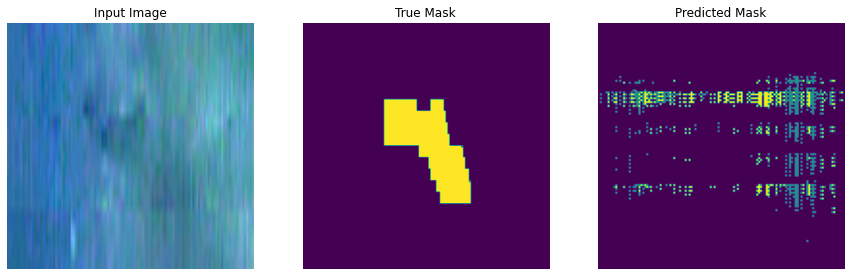


Sample Prediction after epoch 52


Epoch 00052: val_loss did not improve from 1.02821
Epoch 53/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1896 - accuracy: 0.9254 - f1: 0.1386 - precision: 0.0792 - recall: 0.9553 - val_loss: 2.6104 - val_accuracy: 0.8874 - val_f1: 0.1390 - val_precision: 0.0768 - val_recall: 1.0692


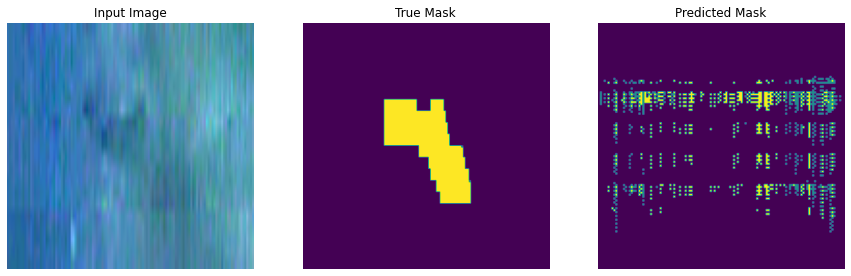


Sample Prediction after epoch 53


Epoch 00053: val_loss did not improve from 1.02821
Epoch 54/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1215 - accuracy: 0.9427 - f1: 0.1398 - precision: 0.0767 - recall: 1.0614 - val_loss: 2.5667 - val_accuracy: 0.9222 - val_f1: 0.1392 - val_precision: 0.0773 - val_recall: 1.0203


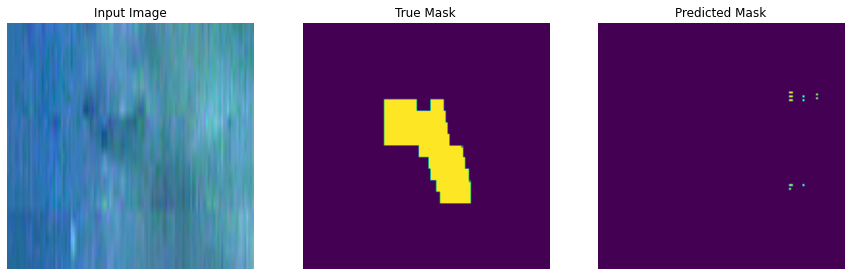


Sample Prediction after epoch 54


Epoch 00054: val_loss did not improve from 1.02821
Epoch 55/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1376 - accuracy: 0.9359 - f1: 0.1624 - precision: 0.0915 - recall: 1.1491 - val_loss: 2.3531 - val_accuracy: 0.9211 - val_f1: 0.1376 - val_precision: 0.0764 - val_recall: 1.0097


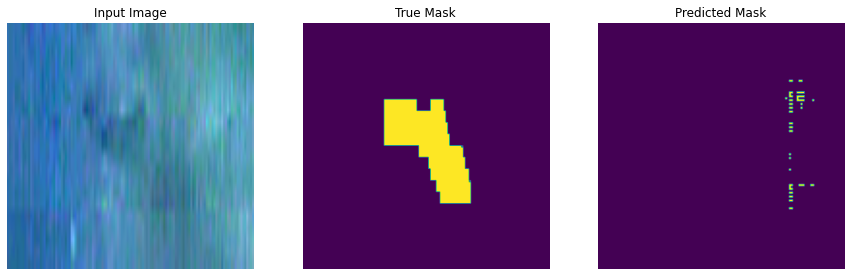


Sample Prediction after epoch 55


Epoch 00055: val_loss did not improve from 1.02821
Epoch 56/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1561 - accuracy: 0.9278 - f1: 0.1749 - precision: 0.0992 - recall: 1.0083 - val_loss: 1.4564 - val_accuracy: 0.9090 - val_f1: 0.1379 - val_precision: 0.0763 - val_recall: 1.0285


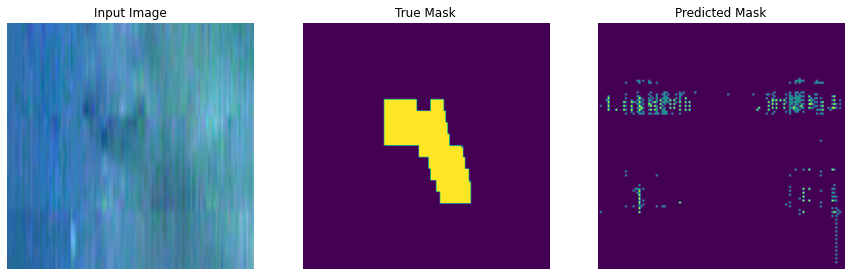


Sample Prediction after epoch 56


Epoch 00056: val_loss did not improve from 1.02821
Epoch 57/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1533 - accuracy: 0.9251 - f1: 0.1579 - precision: 0.0909 - recall: 0.9349 - val_loss: 1.9163 - val_accuracy: 0.9002 - val_f1: 0.1404 - val_precision: 0.0775 - val_recall: 1.0875


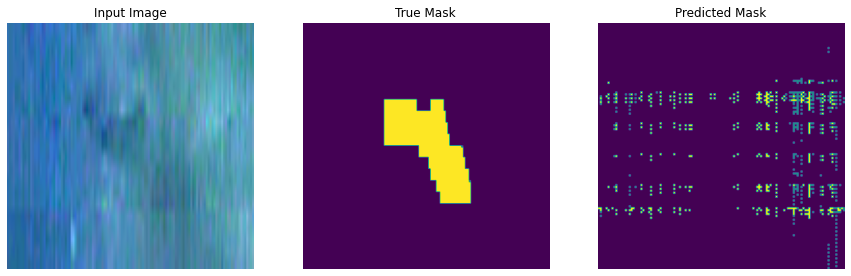


Sample Prediction after epoch 57


Epoch 00057: val_loss did not improve from 1.02821
Epoch 58/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2278 - accuracy: 0.9051 - f1: 0.1649 - precision: 0.0979 - recall: 0.9203 - val_loss: 1.2248 - val_accuracy: 0.8674 - val_f1: 0.1411 - val_precision: 0.0779 - val_recall: 1.0880


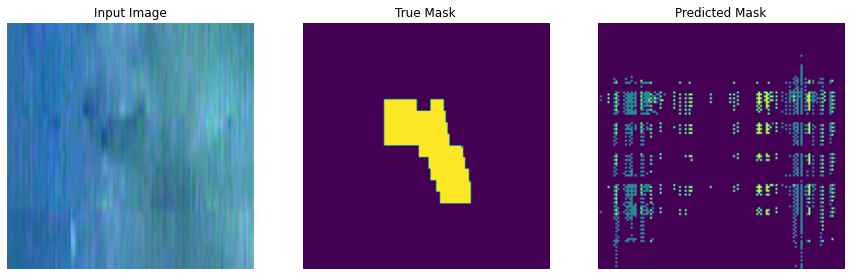


Sample Prediction after epoch 58


Epoch 00058: val_loss did not improve from 1.02821
Epoch 59/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1928 - accuracy: 0.9060 - f1: 0.1674 - precision: 0.0967 - recall: 0.9571 - val_loss: 0.6019 - val_accuracy: 0.9172 - val_f1: 0.1382 - val_precision: 0.0767 - val_recall: 1.0179


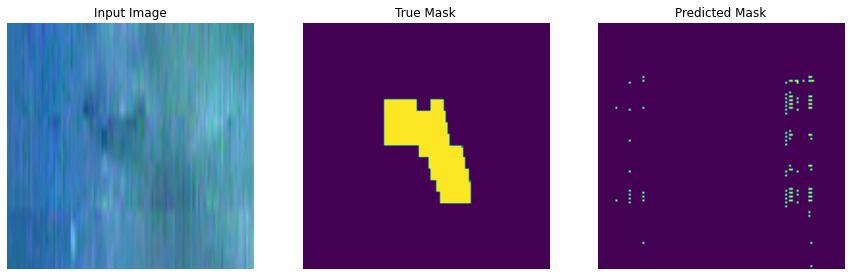


Sample Prediction after epoch 59


Epoch 00059: val_loss improved from 1.02821 to 0.60194, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0059-0.60-0.92.hdf5
Epoch 60/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2135 - accuracy: 0.9085 - f1: 0.1703 - precision: 0.0997 - recall: 0.9746 - val_loss: 0.5892 - val_accuracy: 0.8978 - val_f1: 0.1361 - val_precision: 0.0754 - val_recall: 1.0252


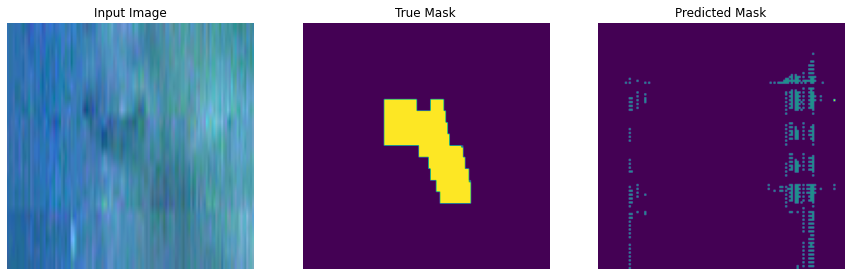


Sample Prediction after epoch 60


Epoch 00060: val_loss improved from 0.60194 to 0.58921, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0060-0.59-0.90.hdf5
Epoch 61/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1695 - accuracy: 0.9205 - f1: 0.1578 - precision: 0.0890 - recall: 0.9802 - val_loss: 0.7255 - val_accuracy: 0.8998 - val_f1: 0.1351 - val_precision: 0.0748 - val_recall: 1.0216


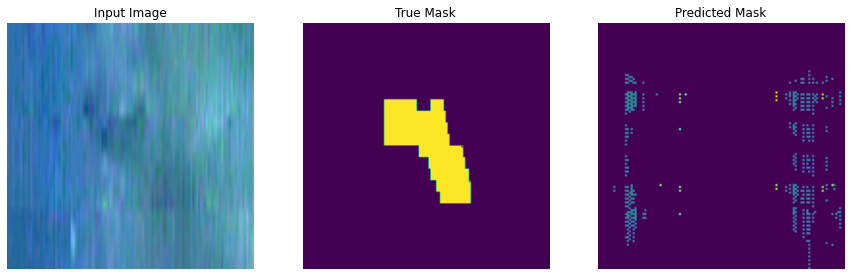


Sample Prediction after epoch 61


Epoch 00061: val_loss did not improve from 0.58921
Epoch 62/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2082 - accuracy: 0.9260 - f1: 0.1624 - precision: 0.0925 - recall: 0.9726 - val_loss: 0.5972 - val_accuracy: 0.9137 - val_f1: 0.1397 - val_precision: 0.0775 - val_recall: 1.0305


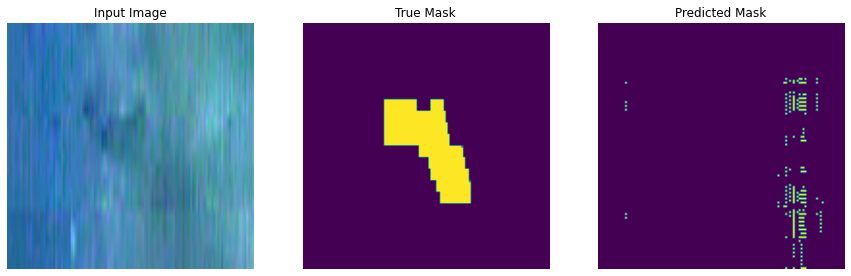


Sample Prediction after epoch 62


Epoch 00062: val_loss did not improve from 0.58921
Epoch 63/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1788 - accuracy: 0.9189 - f1: 0.1699 - precision: 0.0961 - recall: 1.0867 - val_loss: 0.3972 - val_accuracy: 0.9234 - val_f1: 0.1496 - val_precision: 0.0828 - val_recall: 1.1303


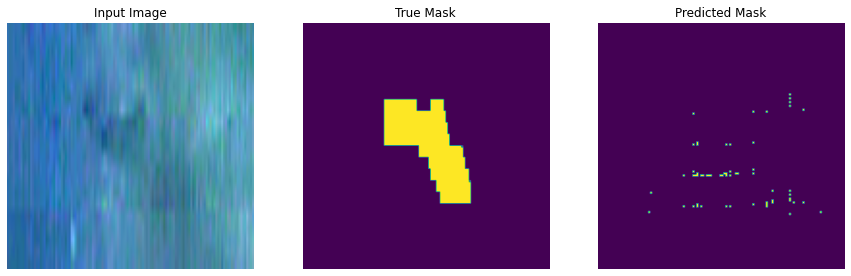


Sample Prediction after epoch 63


Epoch 00063: val_loss improved from 0.58921 to 0.39723, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0063-0.40-0.92.hdf5
Epoch 64/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1449 - accuracy: 0.9358 - f1: 0.1475 - precision: 0.0814 - recall: 0.9863 - val_loss: 0.5816 - val_accuracy: 0.9155 - val_f1: 0.1389 - val_precision: 0.0771 - val_recall: 1.0237


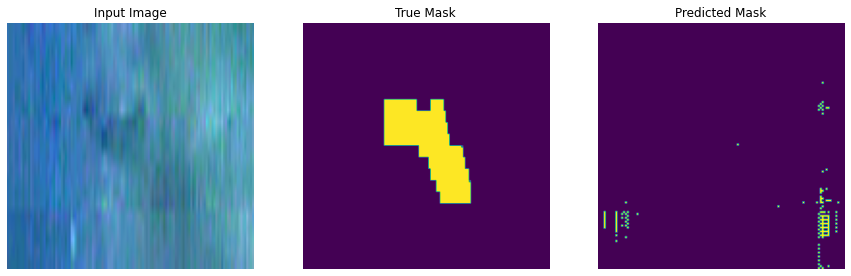


Sample Prediction after epoch 64


Epoch 00064: val_loss did not improve from 0.39723
Epoch 65/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1434 - accuracy: 0.9328 - f1: 0.1668 - precision: 0.0956 - recall: 0.9792 - val_loss: 0.4246 - val_accuracy: 0.9192 - val_f1: 0.1438 - val_precision: 0.0798 - val_recall: 1.0625


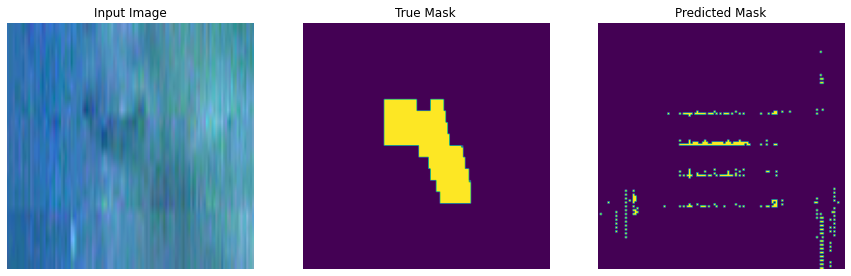


Sample Prediction after epoch 65


Epoch 00065: val_loss did not improve from 0.39723
Epoch 66/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1673 - accuracy: 0.9268 - f1: 0.1545 - precision: 0.0877 - recall: 1.0334 - val_loss: 0.3248 - val_accuracy: 0.9181 - val_f1: 0.1445 - val_precision: 0.0802 - val_recall: 1.0634


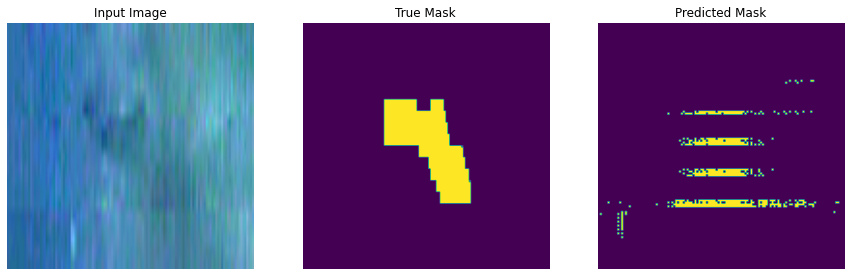


Sample Prediction after epoch 66


Epoch 00066: val_loss improved from 0.39723 to 0.32478, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0066-0.32-0.92.hdf5
Epoch 67/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1496 - accuracy: 0.9309 - f1: 0.1502 - precision: 0.0849 - recall: 0.9275 - val_loss: 0.3702 - val_accuracy: 0.9139 - val_f1: 0.1418 - val_precision: 0.0787 - val_recall: 1.0466


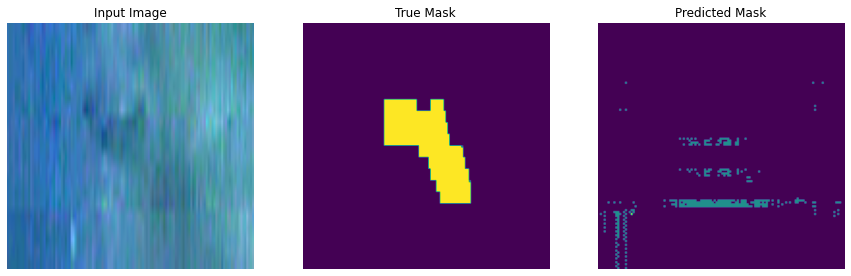


Sample Prediction after epoch 67


Epoch 00067: val_loss did not improve from 0.32478
Epoch 68/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2040 - accuracy: 0.9301 - f1: 0.1428 - precision: 0.0829 - recall: 0.9914 - val_loss: 0.3356 - val_accuracy: 0.8922 - val_f1: 0.1439 - val_precision: 0.0795 - val_recall: 1.1028


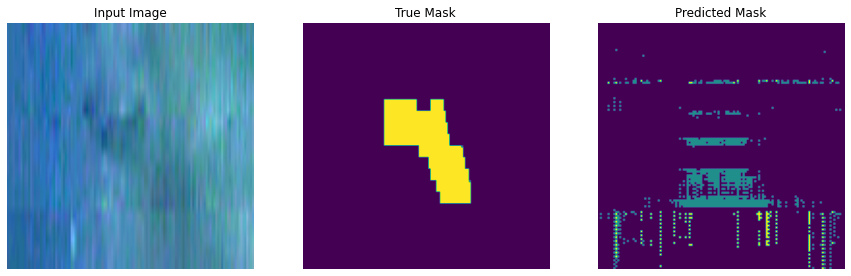


Sample Prediction after epoch 68


Epoch 00068: val_loss did not improve from 0.32478
Epoch 69/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1502 - accuracy: 0.9364 - f1: 0.1457 - precision: 0.0814 - recall: 1.0876 - val_loss: 0.2859 - val_accuracy: 0.8865 - val_f1: 0.1508 - val_precision: 0.0832 - val_recall: 1.1816


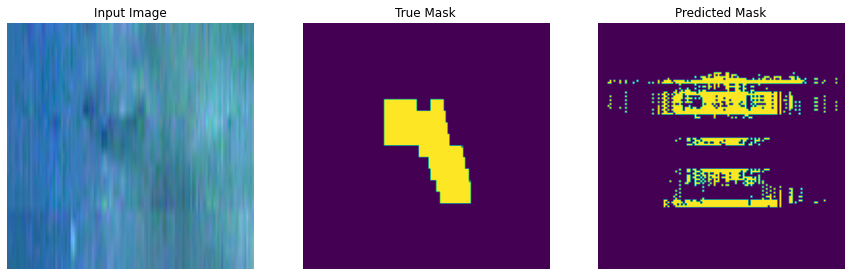


Sample Prediction after epoch 69


Epoch 00069: val_loss improved from 0.32478 to 0.28591, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0069-0.29-0.89.hdf5
Epoch 70/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1557 - accuracy: 0.9303 - f1: 0.1631 - precision: 0.0919 - recall: 1.1171 - val_loss: 0.2536 - val_accuracy: 0.8999 - val_f1: 0.1481 - val_precision: 0.0818 - val_recall: 1.1519


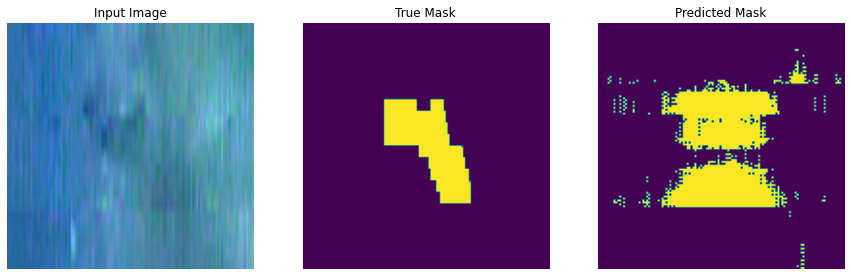


Sample Prediction after epoch 70


Epoch 00070: val_loss improved from 0.28591 to 0.25363, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0070-0.25-0.90.hdf5
Epoch 71/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1494 - accuracy: 0.9287 - f1: 0.1699 - precision: 0.0968 - recall: 1.0855 - val_loss: 0.2678 - val_accuracy: 0.8853 - val_f1: 0.1436 - val_precision: 0.0796 - val_recall: 1.0868


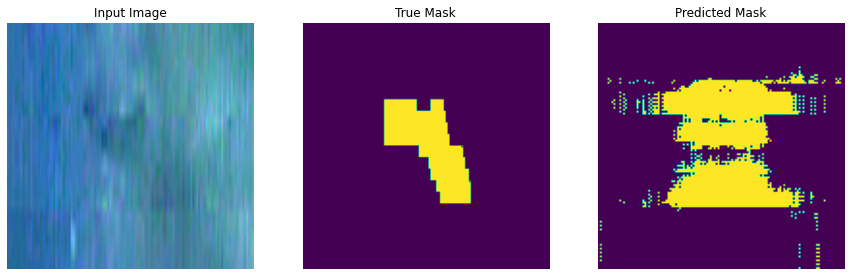


Sample Prediction after epoch 71


Epoch 00071: val_loss did not improve from 0.25363
Epoch 72/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1391 - accuracy: 0.9329 - f1: 0.1475 - precision: 0.0824 - recall: 1.0076 - val_loss: 0.2566 - val_accuracy: 0.9080 - val_f1: 0.1389 - val_precision: 0.0770 - val_recall: 1.0306


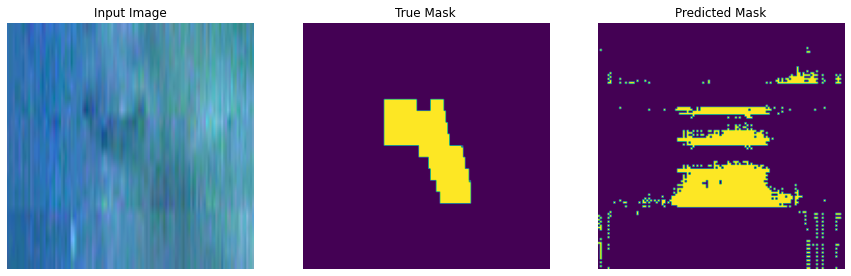


Sample Prediction after epoch 72


Epoch 00072: val_loss did not improve from 0.25363
Epoch 73/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2442 - accuracy: 0.9143 - f1: 0.1639 - precision: 0.0980 - recall: 1.0606 - val_loss: 0.3023 - val_accuracy: 0.8997 - val_f1: 0.1591 - val_precision: 0.0877 - val_recall: 1.2590


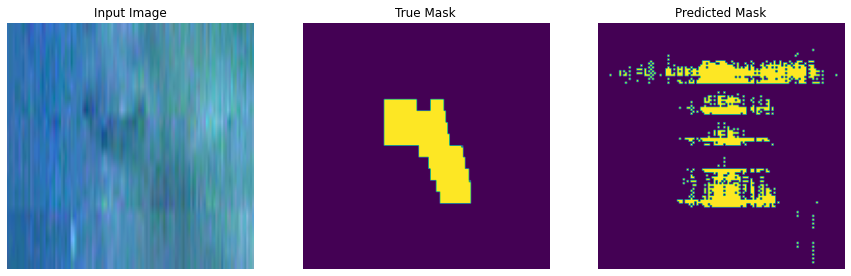


Sample Prediction after epoch 73


Epoch 00073: val_loss did not improve from 0.25363
Epoch 74/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1313 - accuracy: 0.9389 - f1: 0.1613 - precision: 0.0889 - recall: 1.2795 - val_loss: 0.2326 - val_accuracy: 0.9174 - val_f1: 0.1624 - val_precision: 0.0894 - val_recall: 1.3019


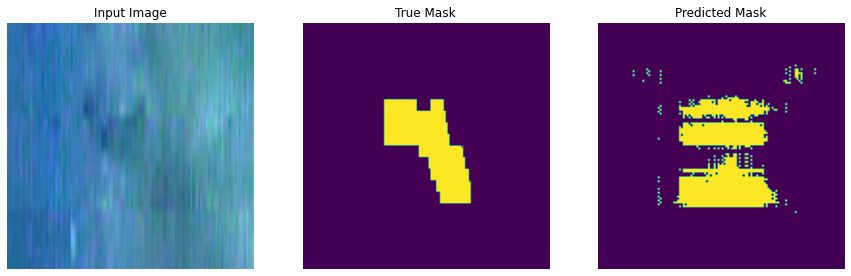


Sample Prediction after epoch 74


Epoch 00074: val_loss improved from 0.25363 to 0.23256, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0074-0.23-0.92.hdf5
Epoch 75/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1662 - accuracy: 0.9256 - f1: 0.1845 - precision: 0.1035 - recall: 1.1937 - val_loss: 0.2756 - val_accuracy: 0.9009 - val_f1: 0.1516 - val_precision: 0.0838 - val_recall: 1.1466


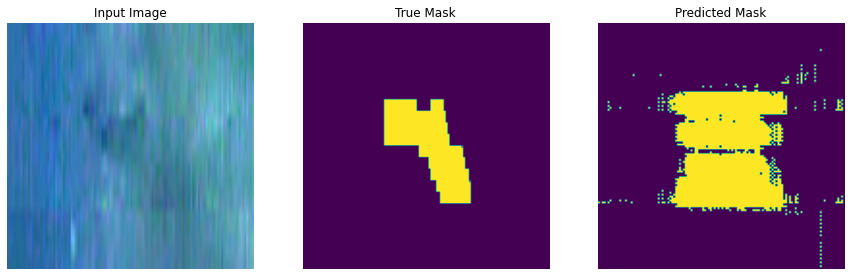


Sample Prediction after epoch 75


Epoch 00075: val_loss did not improve from 0.23256
Epoch 76/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2193 - accuracy: 0.9087 - f1: 0.1670 - precision: 0.0998 - recall: 0.9795 - val_loss: 0.2168 - val_accuracy: 0.9202 - val_f1: 0.1439 - val_precision: 0.0797 - val_recall: 1.0814


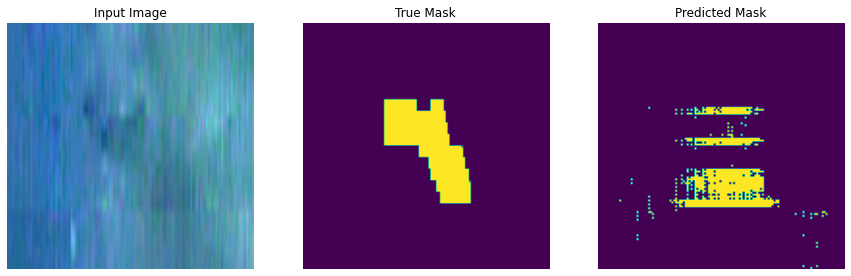


Sample Prediction after epoch 76


Epoch 00076: val_loss improved from 0.23256 to 0.21678, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0076-0.22-0.92.hdf5
Epoch 77/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1234 - accuracy: 0.9403 - f1: 0.1301 - precision: 0.0741 - recall: 1.0153 - val_loss: 0.2105 - val_accuracy: 0.9202 - val_f1: 0.1563 - val_precision: 0.0864 - val_recall: 1.1937


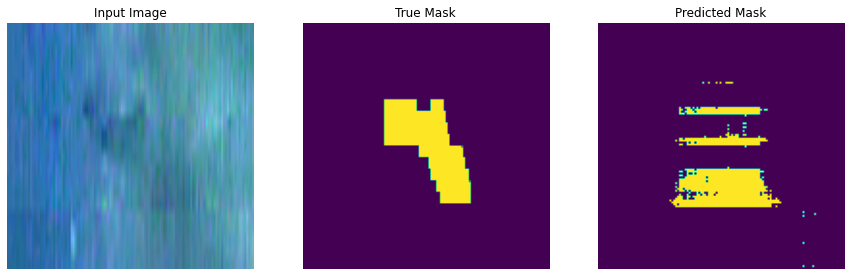


Sample Prediction after epoch 77


Epoch 00077: val_loss improved from 0.21678 to 0.21050, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0077-0.21-0.92.hdf5
Epoch 78/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1025 - accuracy: 0.9468 - f1: 0.1386 - precision: 0.0774 - recall: 1.0424 - val_loss: 0.2646 - val_accuracy: 0.9157 - val_f1: 0.1499 - val_precision: 0.0830 - val_recall: 1.1316


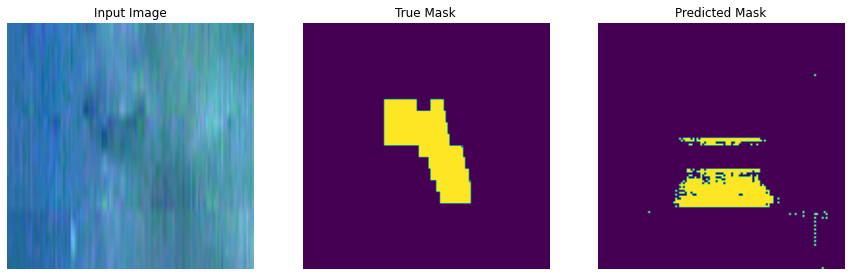


Sample Prediction after epoch 78


Epoch 00078: val_loss did not improve from 0.21050
Epoch 79/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2307 - accuracy: 0.9149 - f1: 0.1779 - precision: 0.1059 - recall: 0.9948 - val_loss: 0.3206 - val_accuracy: 0.9071 - val_f1: 0.1466 - val_precision: 0.0811 - val_recall: 1.1080


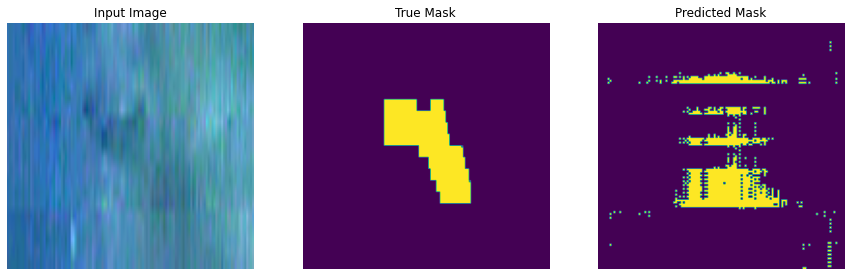


Sample Prediction after epoch 79


Epoch 00079: val_loss did not improve from 0.21050
Epoch 80/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1709 - accuracy: 0.9237 - f1: 0.1802 - precision: 0.1049 - recall: 1.0209 - val_loss: 0.2804 - val_accuracy: 0.9149 - val_f1: 0.1527 - val_precision: 0.0846 - val_recall: 1.1475


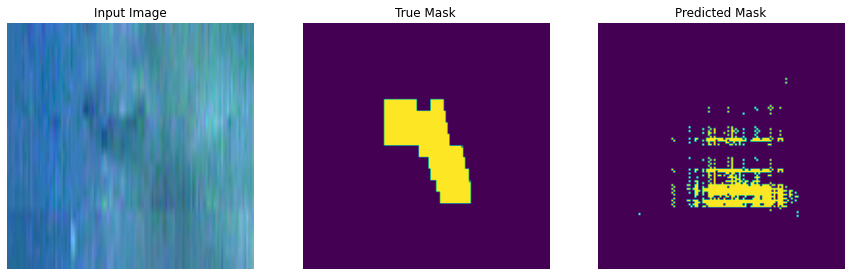


Sample Prediction after epoch 80


Epoch 00080: val_loss did not improve from 0.21050
Epoch 81/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1690 - accuracy: 0.9263 - f1: 0.1708 - precision: 0.0978 - recall: 1.0393 - val_loss: 0.3742 - val_accuracy: 0.9177 - val_f1: 0.1495 - val_precision: 0.0828 - val_recall: 1.1315


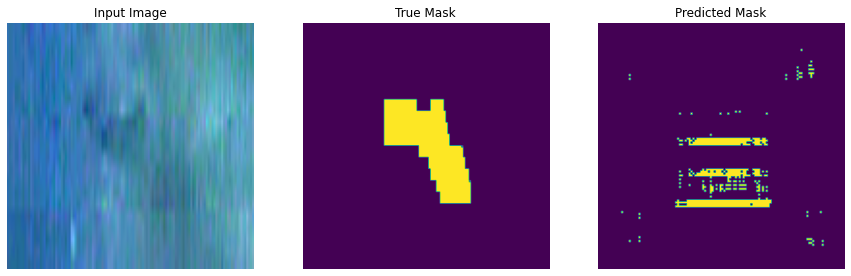


Sample Prediction after epoch 81


Epoch 00081: val_loss did not improve from 0.21050
Epoch 82/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1239 - accuracy: 0.9386 - f1: 0.1549 - precision: 0.0880 - recall: 0.9935 - val_loss: 0.2693 - val_accuracy: 0.9173 - val_f1: 0.1591 - val_precision: 0.0879 - val_recall: 1.2194


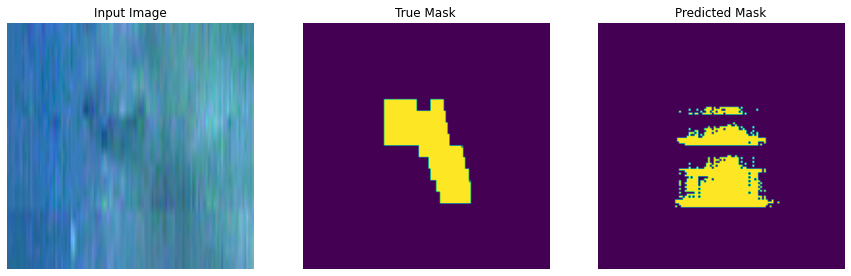


Sample Prediction after epoch 82


Epoch 00082: val_loss did not improve from 0.21050
Epoch 83/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1072 - accuracy: 0.9446 - f1: 0.1443 - precision: 0.0811 - recall: 1.0430 - val_loss: 0.2503 - val_accuracy: 0.9179 - val_f1: 0.1604 - val_precision: 0.0887 - val_recall: 1.2171


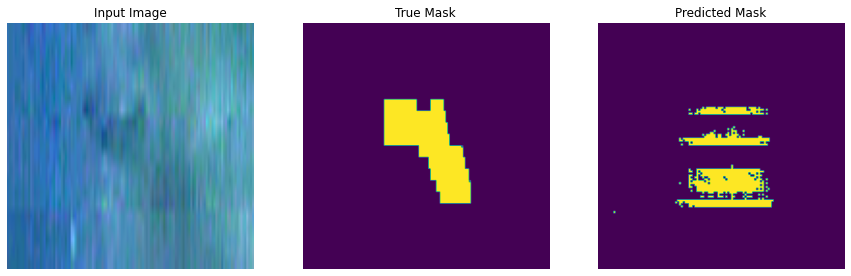


Sample Prediction after epoch 83


Epoch 00083: val_loss did not improve from 0.21050
Epoch 84/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1060 - accuracy: 0.9447 - f1: 0.1544 - precision: 0.0863 - recall: 1.0728 - val_loss: 0.2612 - val_accuracy: 0.9165 - val_f1: 0.1598 - val_precision: 0.0884 - val_recall: 1.2169


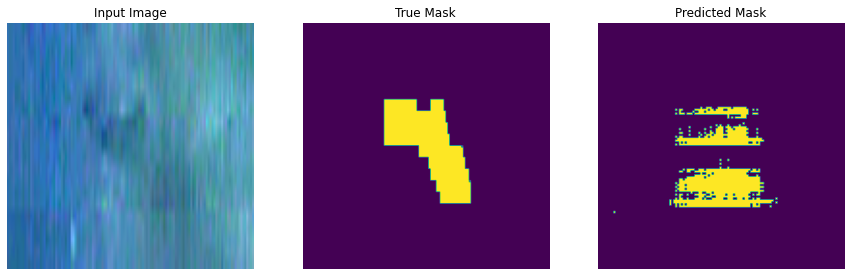


Sample Prediction after epoch 84


Epoch 00084: val_loss did not improve from 0.21050
Epoch 85/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1420 - accuracy: 0.9307 - f1: 0.1519 - precision: 0.0872 - recall: 1.0360 - val_loss: 0.3466 - val_accuracy: 0.9209 - val_f1: 0.1545 - val_precision: 0.0854 - val_recall: 1.1963


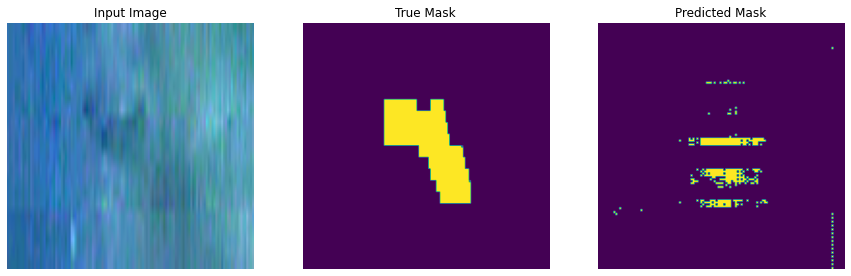


Sample Prediction after epoch 85


Epoch 00085: val_loss did not improve from 0.21050
Epoch 86/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1605 - accuracy: 0.9213 - f1: 0.1821 - precision: 0.1068 - recall: 0.9843 - val_loss: 0.2819 - val_accuracy: 0.9176 - val_f1: 0.1572 - val_precision: 0.0869 - val_recall: 1.2119


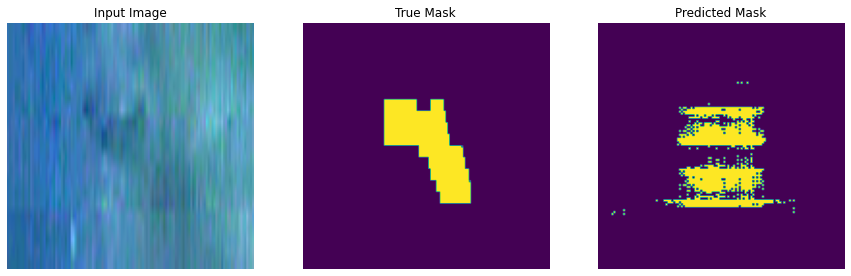


Sample Prediction after epoch 86


Epoch 00086: val_loss did not improve from 0.21050
Epoch 87/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1589 - accuracy: 0.9212 - f1: 0.1500 - precision: 0.0850 - recall: 0.9604 - val_loss: 0.3638 - val_accuracy: 0.9241 - val_f1: 0.1509 - val_precision: 0.0835 - val_recall: 1.1463


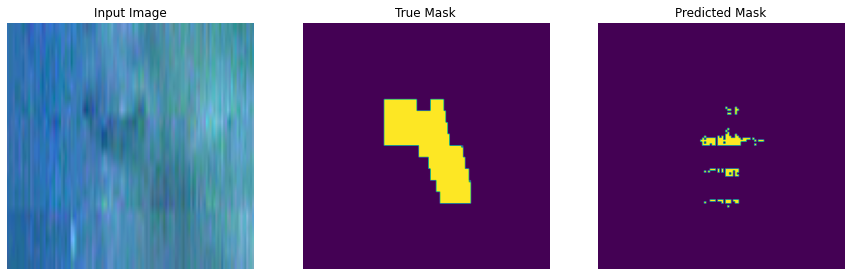


Sample Prediction after epoch 87


Epoch 00087: val_loss did not improve from 0.21050
Epoch 88/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1082 - accuracy: 0.9432 - f1: 0.1478 - precision: 0.0832 - recall: 1.0605 - val_loss: 0.2960 - val_accuracy: 0.9238 - val_f1: 0.1515 - val_precision: 0.0840 - val_recall: 1.1316


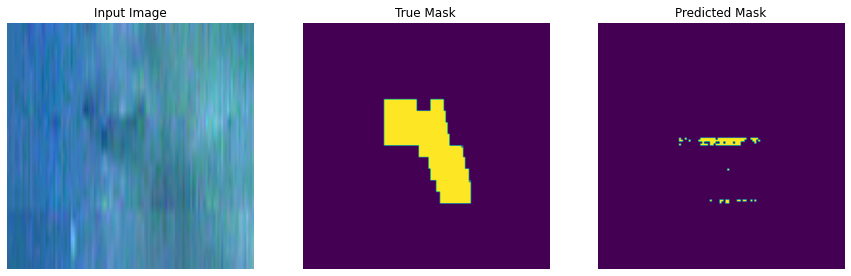


Sample Prediction after epoch 88


Epoch 00088: val_loss did not improve from 0.21050
Epoch 89/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1708 - accuracy: 0.9322 - f1: 0.1557 - precision: 0.0901 - recall: 0.9750 - val_loss: 0.3182 - val_accuracy: 0.9226 - val_f1: 0.1517 - val_precision: 0.0840 - val_recall: 1.1317


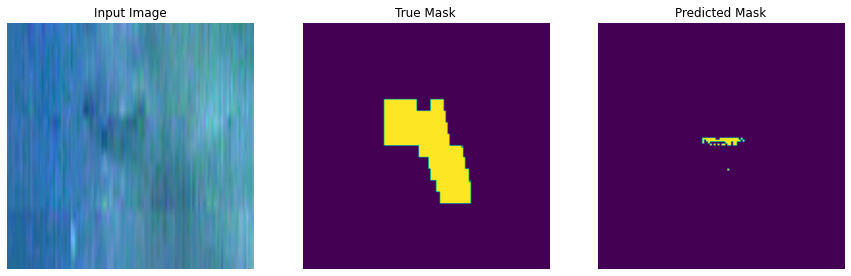


Sample Prediction after epoch 89


Epoch 00089: val_loss did not improve from 0.21050
Epoch 90/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1484 - accuracy: 0.9321 - f1: 0.1748 - precision: 0.0979 - recall: 1.1706 - val_loss: 0.3087 - val_accuracy: 0.9192 - val_f1: 0.1550 - val_precision: 0.0857 - val_recall: 1.2017


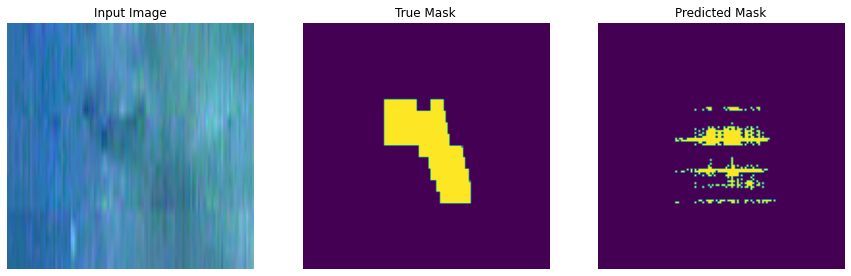


Sample Prediction after epoch 90


Epoch 00090: val_loss did not improve from 0.21050
Epoch 91/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1384 - accuracy: 0.9411 - f1: 0.1457 - precision: 0.0828 - recall: 1.0206 - val_loss: 0.3494 - val_accuracy: 0.9227 - val_f1: 0.1464 - val_precision: 0.0812 - val_recall: 1.0882


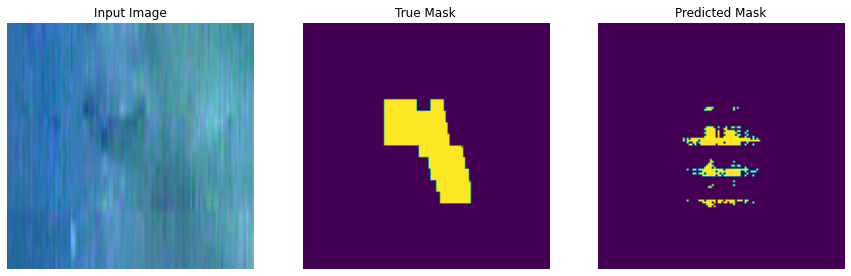


Sample Prediction after epoch 91


Epoch 00091: val_loss did not improve from 0.21050
Epoch 92/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1542 - accuracy: 0.9238 - f1: 0.1736 - precision: 0.0997 - recall: 0.9251 - val_loss: 0.6119 - val_accuracy: 0.9225 - val_f1: 0.1388 - val_precision: 0.0771 - val_recall: 1.0136


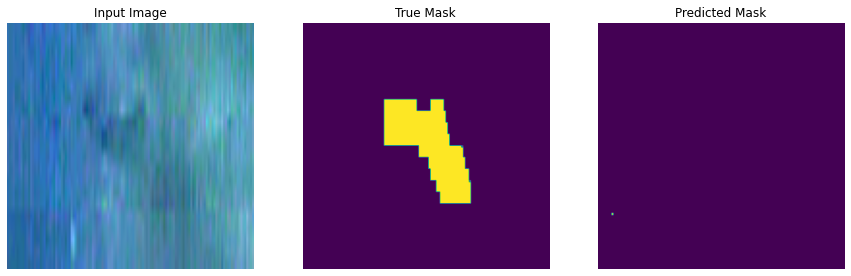


Sample Prediction after epoch 92


Epoch 00092: val_loss did not improve from 0.21050
Epoch 93/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1444 - accuracy: 0.9310 - f1: 0.1629 - precision: 0.0926 - recall: 1.0270 - val_loss: 0.3228 - val_accuracy: 0.9235 - val_f1: 0.1465 - val_precision: 0.0811 - val_recall: 1.1082


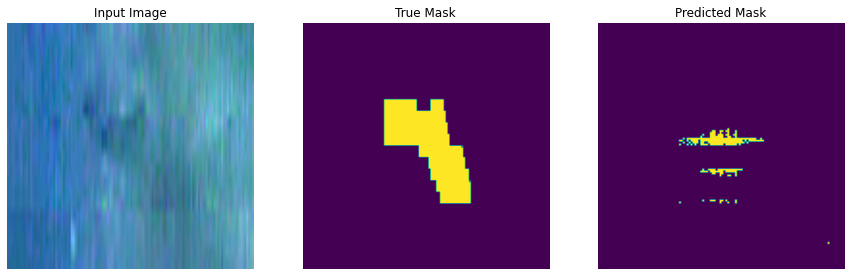


Sample Prediction after epoch 93


Epoch 00093: val_loss did not improve from 0.21050
Epoch 94/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1403 - accuracy: 0.9329 - f1: 0.1760 - precision: 0.1019 - recall: 1.0330 - val_loss: 0.2546 - val_accuracy: 0.9177 - val_f1: 0.1462 - val_precision: 0.0810 - val_recall: 1.1009


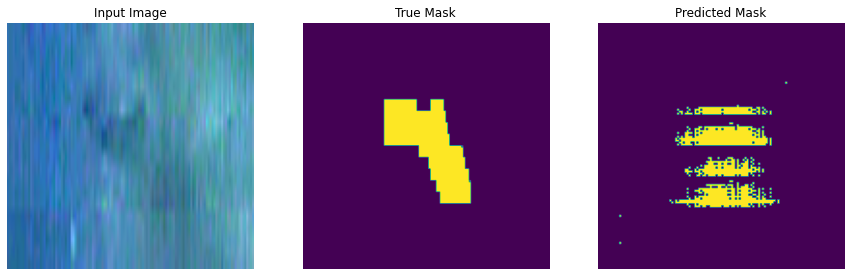


Sample Prediction after epoch 94


Epoch 00094: val_loss did not improve from 0.21050
Epoch 95/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1182 - accuracy: 0.9392 - f1: 0.1490 - precision: 0.0847 - recall: 1.0861 - val_loss: 0.2508 - val_accuracy: 0.9002 - val_f1: 0.1555 - val_precision: 0.0860 - val_recall: 1.1769


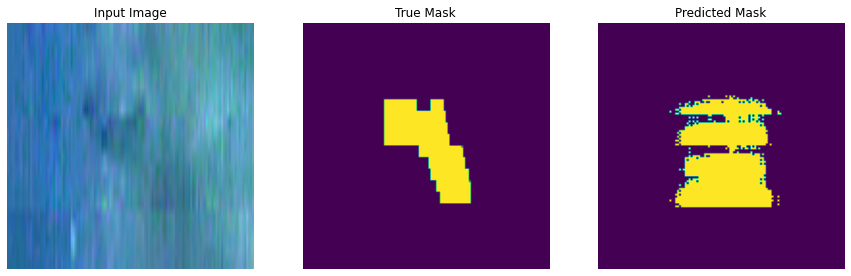


Sample Prediction after epoch 95


Epoch 00095: val_loss did not improve from 0.21050
Epoch 96/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1496 - accuracy: 0.9335 - f1: 0.1651 - precision: 0.0956 - recall: 1.0155 - val_loss: 0.2813 - val_accuracy: 0.9142 - val_f1: 0.1449 - val_precision: 0.0803 - val_recall: 1.0907


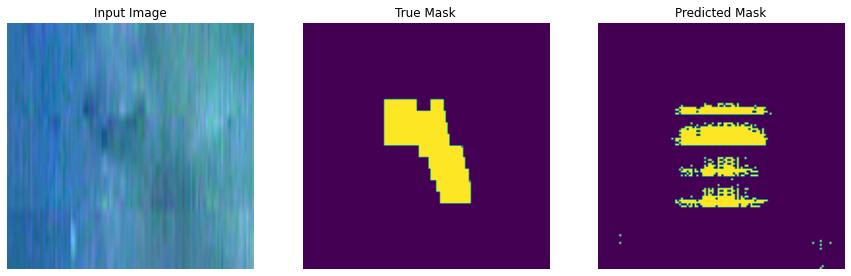


Sample Prediction after epoch 96


Epoch 00096: val_loss did not improve from 0.21050
Epoch 97/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1225 - accuracy: 0.9385 - f1: 0.1420 - precision: 0.0794 - recall: 1.0000 - val_loss: 0.2338 - val_accuracy: 0.9072 - val_f1: 0.1565 - val_precision: 0.0866 - val_recall: 1.1860


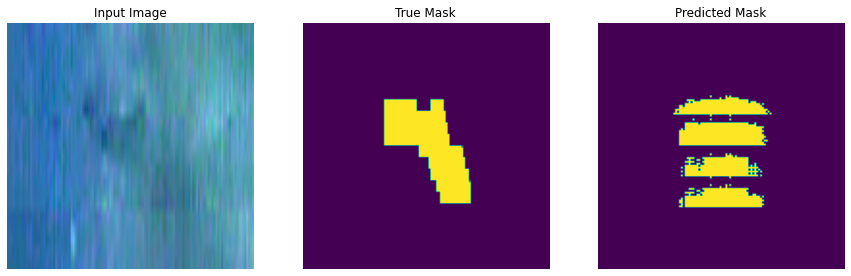


Sample Prediction after epoch 97


Epoch 00097: val_loss did not improve from 0.21050
Epoch 98/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2072 - accuracy: 0.9163 - f1: 0.1845 - precision: 0.1094 - recall: 1.0063 - val_loss: 0.2649 - val_accuracy: 0.9109 - val_f1: 0.1464 - val_precision: 0.0811 - val_recall: 1.0989


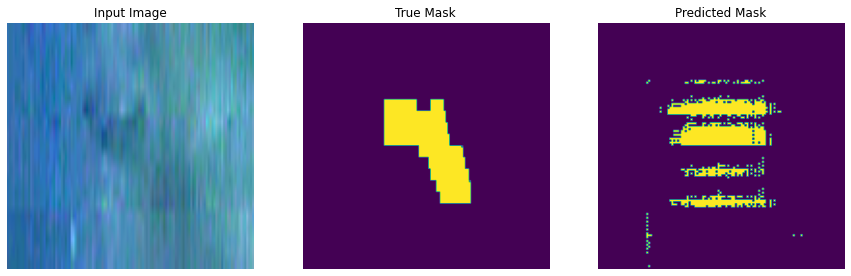


Sample Prediction after epoch 98


Epoch 00098: val_loss did not improve from 0.21050
Epoch 99/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1404 - accuracy: 0.9321 - f1: 0.1472 - precision: 0.0830 - recall: 0.9983 - val_loss: 0.2255 - val_accuracy: 0.9230 - val_f1: 0.1542 - val_precision: 0.0853 - val_recall: 1.1717


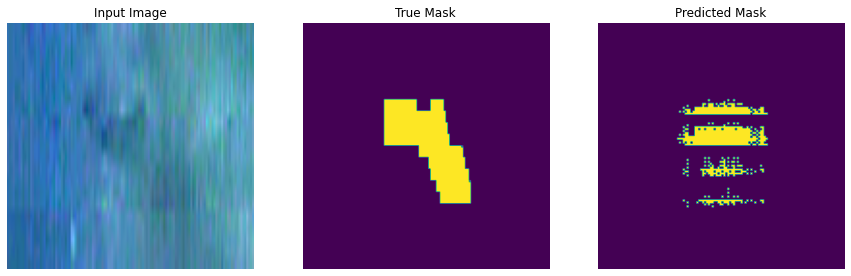


Sample Prediction after epoch 99


Epoch 00099: val_loss did not improve from 0.21050
Epoch 100/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1703 - accuracy: 0.9207 - f1: 0.1755 - precision: 0.1014 - recall: 1.0348 - val_loss: 0.3679 - val_accuracy: 0.9214 - val_f1: 0.1469 - val_precision: 0.0814 - val_recall: 1.1016


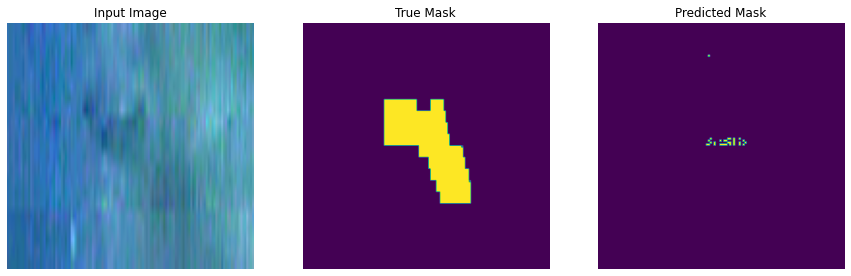


Sample Prediction after epoch 100


Epoch 00100: val_loss did not improve from 0.21050
Epoch 101/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1573 - accuracy: 0.9240 - f1: 0.1820 - precision: 0.1039 - recall: 1.0773 - val_loss: 0.2005 - val_accuracy: 0.9169 - val_f1: 0.1501 - val_precision: 0.0832 - val_recall: 1.1275


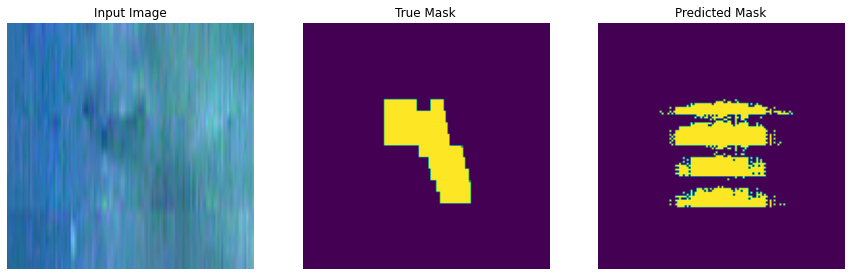


Sample Prediction after epoch 101


Epoch 00101: val_loss improved from 0.21050 to 0.20051, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0101-0.20-0.92.hdf5
Epoch 102/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1877 - accuracy: 0.9157 - f1: 0.1738 - precision: 0.1050 - recall: 1.0412 - val_loss: 0.2340 - val_accuracy: 0.8871 - val_f1: 0.1444 - val_precision: 0.0800 - val_recall: 1.1047


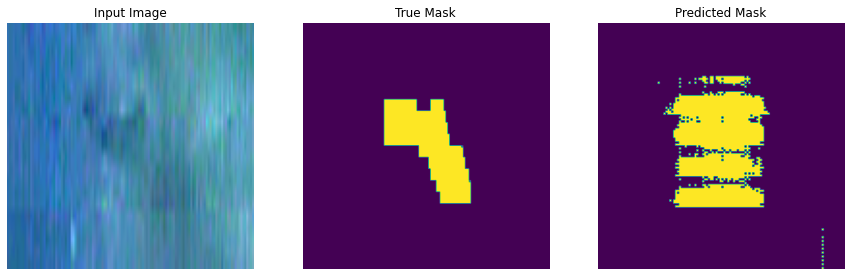


Sample Prediction after epoch 102


Epoch 00102: val_loss did not improve from 0.20051
Epoch 103/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1430 - accuracy: 0.9397 - f1: 0.1491 - precision: 0.0849 - recall: 0.9832 - val_loss: 0.3037 - val_accuracy: 0.9179 - val_f1: 0.1491 - val_precision: 0.0826 - val_recall: 1.1258


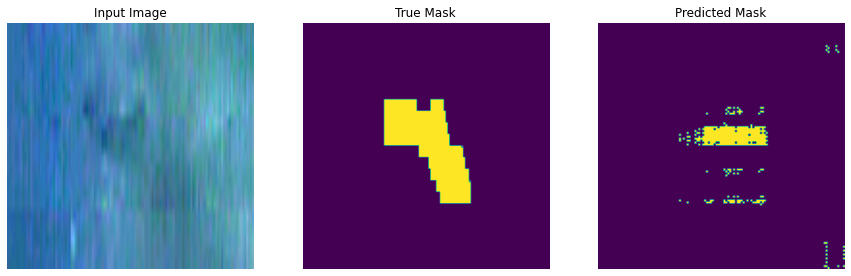


Sample Prediction after epoch 103


Epoch 00103: val_loss did not improve from 0.20051
Epoch 104/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1076 - accuracy: 0.9456 - f1: 0.1361 - precision: 0.0750 - recall: 0.9865 - val_loss: 0.2125 - val_accuracy: 0.9159 - val_f1: 0.1644 - val_precision: 0.0908 - val_recall: 1.2767


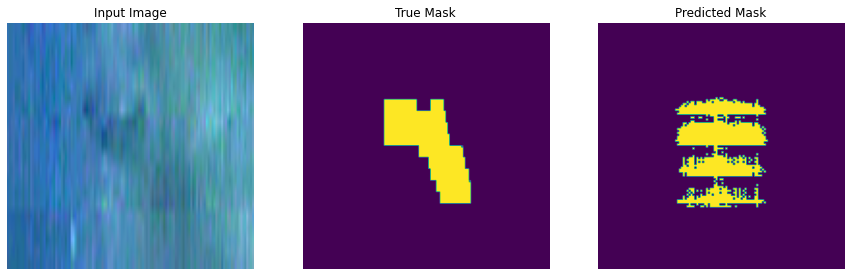


Sample Prediction after epoch 104


Epoch 00104: val_loss did not improve from 0.20051
Epoch 105/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1169 - accuracy: 0.9401 - f1: 0.1524 - precision: 0.0873 - recall: 1.0664 - val_loss: 0.2199 - val_accuracy: 0.9168 - val_f1: 0.1632 - val_precision: 0.0901 - val_recall: 1.2671


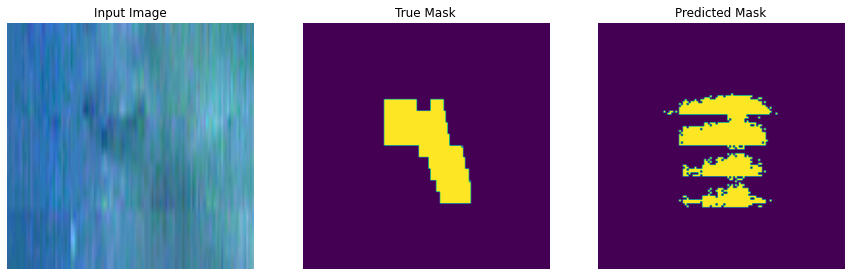


Sample Prediction after epoch 105


Epoch 00105: val_loss did not improve from 0.20051
Epoch 106/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1159 - accuracy: 0.9417 - f1: 0.1550 - precision: 0.0874 - recall: 1.0888 - val_loss: 0.2213 - val_accuracy: 0.9021 - val_f1: 0.1554 - val_precision: 0.0859 - val_recall: 1.2000


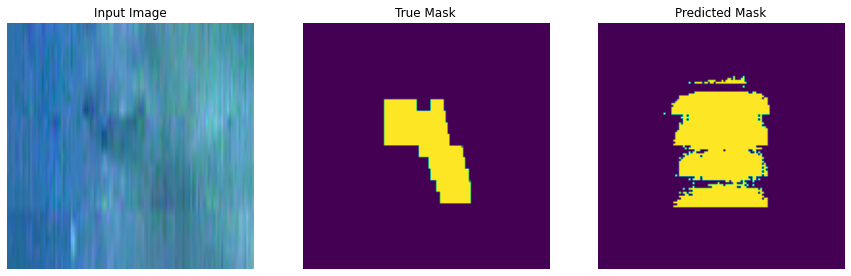


Sample Prediction after epoch 106


Epoch 00106: val_loss did not improve from 0.20051
Epoch 107/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1130 - accuracy: 0.9397 - f1: 0.1653 - precision: 0.0935 - recall: 1.0355 - val_loss: 0.1921 - val_accuracy: 0.9103 - val_f1: 0.1515 - val_precision: 0.0840 - val_recall: 1.1423


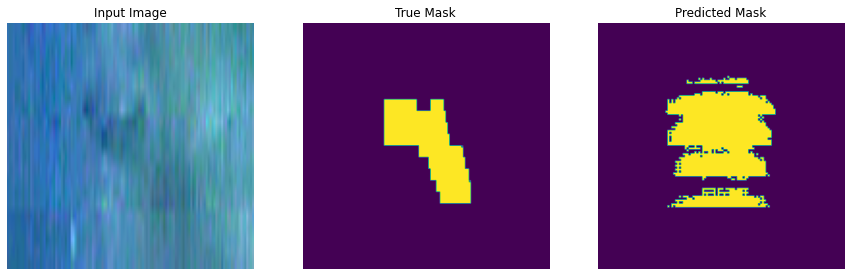


Sample Prediction after epoch 107


Epoch 00107: val_loss improved from 0.20051 to 0.19209, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0107-0.19-0.91.hdf5
Epoch 108/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1326 - accuracy: 0.9319 - f1: 0.1668 - precision: 0.0959 - recall: 0.9561 - val_loss: 0.2527 - val_accuracy: 0.8845 - val_f1: 0.1492 - val_precision: 0.0828 - val_recall: 1.1142


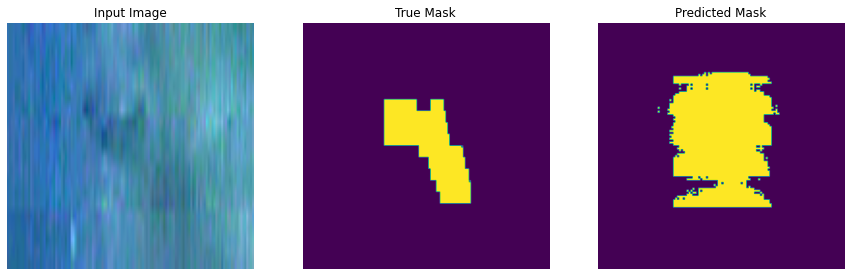


Sample Prediction after epoch 108


Epoch 00108: val_loss did not improve from 0.19209
Epoch 109/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1076 - accuracy: 0.9434 - f1: 0.1498 - precision: 0.0835 - recall: 1.0181 - val_loss: 0.2020 - val_accuracy: 0.9134 - val_f1: 0.1509 - val_precision: 0.0837 - val_recall: 1.1291


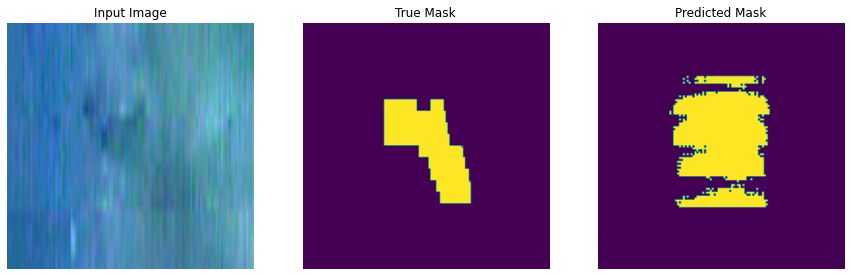


Sample Prediction after epoch 109


Epoch 00109: val_loss did not improve from 0.19209
Epoch 110/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1492 - accuracy: 0.9255 - f1: 0.1727 - precision: 0.1008 - recall: 0.9970 - val_loss: 0.2215 - val_accuracy: 0.9030 - val_f1: 0.1461 - val_precision: 0.0810 - val_recall: 1.1004


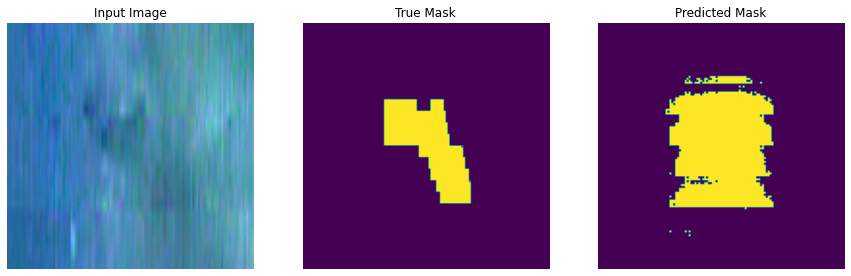


Sample Prediction after epoch 110


Epoch 00110: val_loss did not improve from 0.19209
Epoch 111/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1124 - accuracy: 0.9382 - f1: 0.1516 - precision: 0.0856 - recall: 0.9909 - val_loss: 0.2058 - val_accuracy: 0.9043 - val_f1: 0.1456 - val_precision: 0.0808 - val_recall: 1.0814


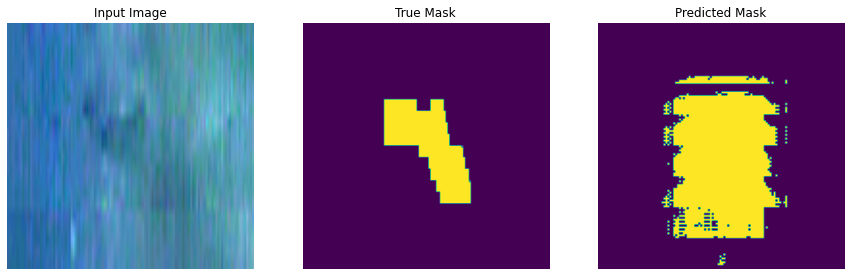


Sample Prediction after epoch 111


Epoch 00111: val_loss did not improve from 0.19209
Epoch 112/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1318 - accuracy: 0.9360 - f1: 0.1680 - precision: 0.0971 - recall: 1.0035 - val_loss: 0.3070 - val_accuracy: 0.8665 - val_f1: 0.1374 - val_precision: 0.0765 - val_recall: 0.9864


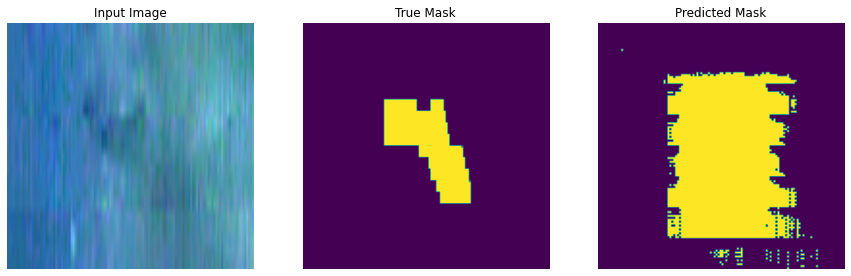


Sample Prediction after epoch 112


Epoch 00112: val_loss did not improve from 0.19209
Epoch 113/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0965 - accuracy: 0.9519 - f1: 0.1394 - precision: 0.0772 - recall: 1.0665 - val_loss: 0.2738 - val_accuracy: 0.8856 - val_f1: 0.1373 - val_precision: 0.0763 - val_recall: 1.0116


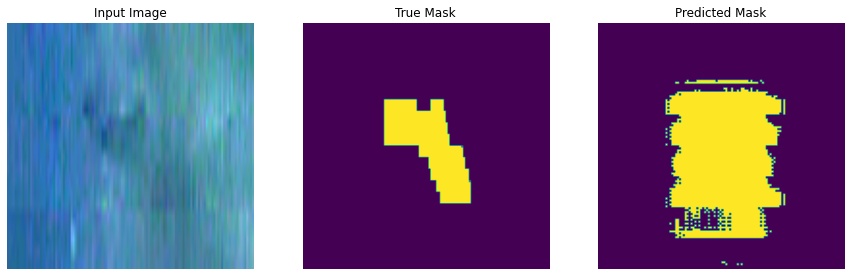


Sample Prediction after epoch 113


Epoch 00113: val_loss did not improve from 0.19209
Epoch 114/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1259 - accuracy: 0.9382 - f1: 0.1669 - precision: 0.0937 - recall: 1.0451 - val_loss: 0.3085 - val_accuracy: 0.8789 - val_f1: 0.1348 - val_precision: 0.0750 - val_recall: 0.9843


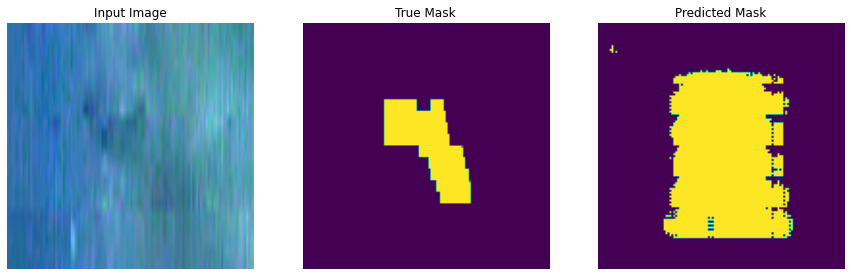


Sample Prediction after epoch 114


Epoch 00114: val_loss did not improve from 0.19209
Epoch 115/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1049 - accuracy: 0.9443 - f1: 0.1549 - precision: 0.0874 - recall: 1.0302 - val_loss: 0.2961 - val_accuracy: 0.8769 - val_f1: 0.1372 - val_precision: 0.0762 - val_recall: 1.0149


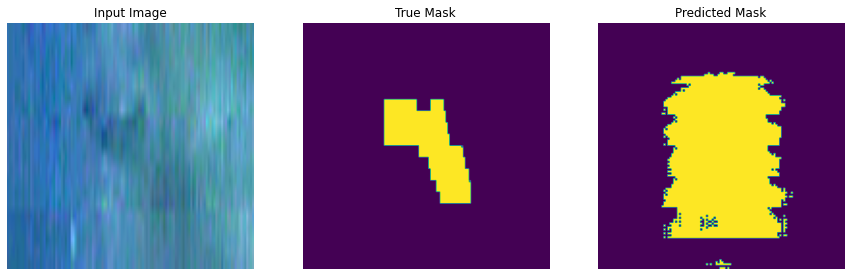


Sample Prediction after epoch 115


Epoch 00115: val_loss did not improve from 0.19209
Epoch 116/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1173 - accuracy: 0.9377 - f1: 0.1546 - precision: 0.0893 - recall: 1.0189 - val_loss: 0.2328 - val_accuracy: 0.9007 - val_f1: 0.1432 - val_precision: 0.0796 - val_recall: 1.0425


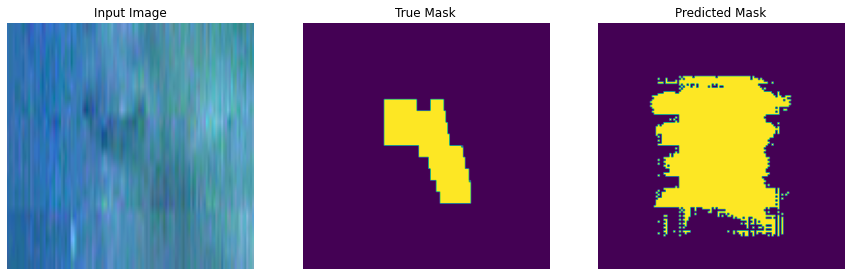


Sample Prediction after epoch 116


Epoch 00116: val_loss did not improve from 0.19209
Epoch 117/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1382 - accuracy: 0.9356 - f1: 0.1700 - precision: 0.0990 - recall: 1.0104 - val_loss: 0.1739 - val_accuracy: 0.9272 - val_f1: 0.1402 - val_precision: 0.0778 - val_recall: 1.0479


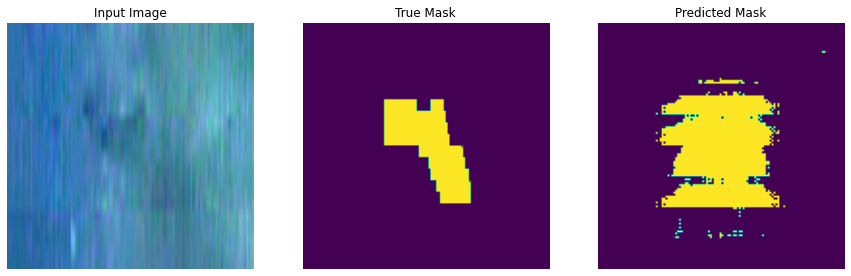


Sample Prediction after epoch 117


Epoch 00117: val_loss improved from 0.19209 to 0.17387, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0117-0.17-0.93.hdf5
Epoch 118/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1156 - accuracy: 0.9416 - f1: 0.1553 - precision: 0.0889 - recall: 1.0898 - val_loss: 0.1700 - val_accuracy: 0.9329 - val_f1: 0.1531 - val_precision: 0.0846 - val_recall: 1.1812


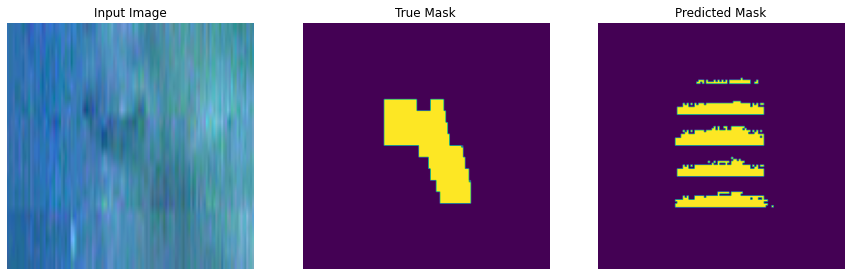


Sample Prediction after epoch 118


Epoch 00118: val_loss improved from 0.17387 to 0.17000, saving model to ../weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0118-0.17-0.93.hdf5
Epoch 119/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1158 - accuracy: 0.9358 - f1: 0.1783 - precision: 0.1010 - recall: 1.0570 - val_loss: 0.2047 - val_accuracy: 0.9086 - val_f1: 0.1478 - val_precision: 0.0816 - val_recall: 1.1868


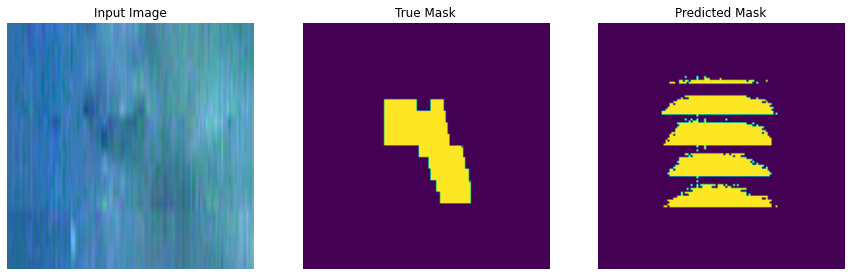


Sample Prediction after epoch 119


Epoch 00119: val_loss did not improve from 0.17000
Epoch 120/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1248 - accuracy: 0.9372 - f1: 0.1670 - precision: 0.0945 - recall: 1.0384 - val_loss: 0.2407 - val_accuracy: 0.8964 - val_f1: 0.1517 - val_precision: 0.0840 - val_recall: 1.1586


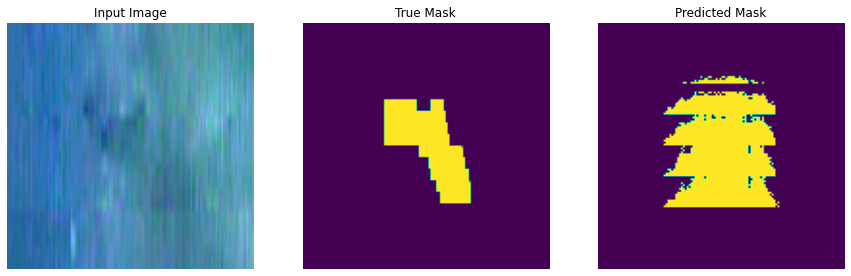


Sample Prediction after epoch 120


Epoch 00120: val_loss did not improve from 0.17000
Epoch 121/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1112 - accuracy: 0.9438 - f1: 0.1439 - precision: 0.0815 - recall: 1.0641 - val_loss: 0.2160 - val_accuracy: 0.9087 - val_f1: 0.1476 - val_precision: 0.0819 - val_recall: 1.1007


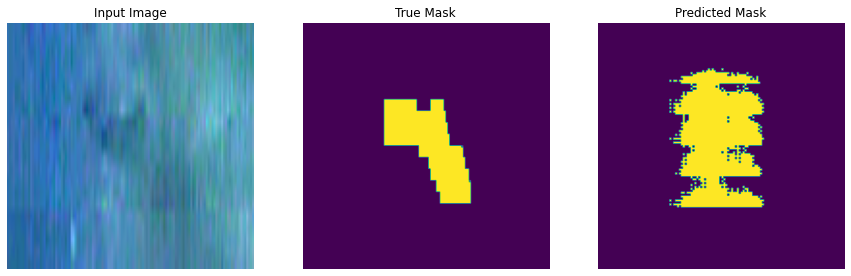


Sample Prediction after epoch 121


Epoch 00121: val_loss did not improve from 0.17000
Epoch 122/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1158 - accuracy: 0.9385 - f1: 0.1537 - precision: 0.0863 - recall: 1.0064 - val_loss: 0.1896 - val_accuracy: 0.9145 - val_f1: 0.1488 - val_precision: 0.0825 - val_recall: 1.1286


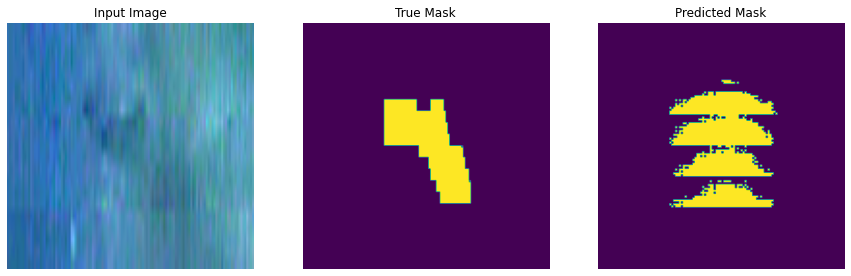


Sample Prediction after epoch 122


Epoch 00122: val_loss did not improve from 0.17000
Epoch 123/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1573 - accuracy: 0.9233 - f1: 0.1632 - precision: 0.0950 - recall: 1.0485 - val_loss: 0.3057 - val_accuracy: 0.8642 - val_f1: 0.1296 - val_precision: 0.0721 - val_recall: 0.9489


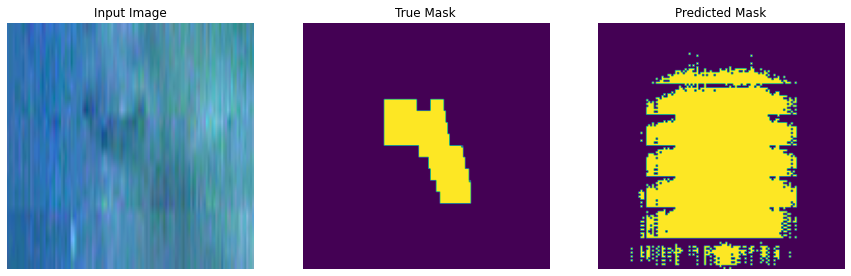


Sample Prediction after epoch 123


Epoch 00123: val_loss did not improve from 0.17000
Epoch 124/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1377 - accuracy: 0.9364 - f1: 0.1569 - precision: 0.0891 - recall: 1.0383 - val_loss: 0.3787 - val_accuracy: 0.8360 - val_f1: 0.1348 - val_precision: 0.0748 - val_recall: 0.9948


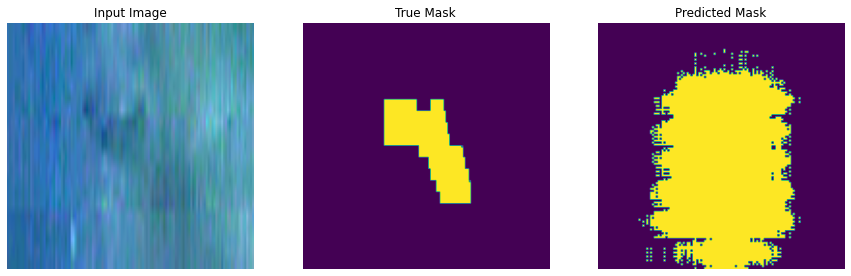


Sample Prediction after epoch 124


Epoch 00124: val_loss did not improve from 0.17000
Epoch 125/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1580 - accuracy: 0.9249 - f1: 0.1742 - precision: 0.1013 - recall: 1.0464 - val_loss: 0.3283 - val_accuracy: 0.8525 - val_f1: 0.1323 - val_precision: 0.0735 - val_recall: 0.9658


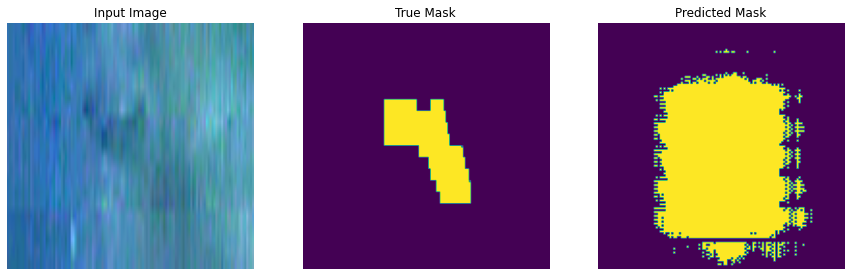


Sample Prediction after epoch 125


Epoch 00125: val_loss did not improve from 0.17000
Epoch 126/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1143 - accuracy: 0.9428 - f1: 0.1377 - precision: 0.0759 - recall: 1.0183 - val_loss: 0.3084 - val_accuracy: 0.8549 - val_f1: 0.1311 - val_precision: 0.0727 - val_recall: 0.9758


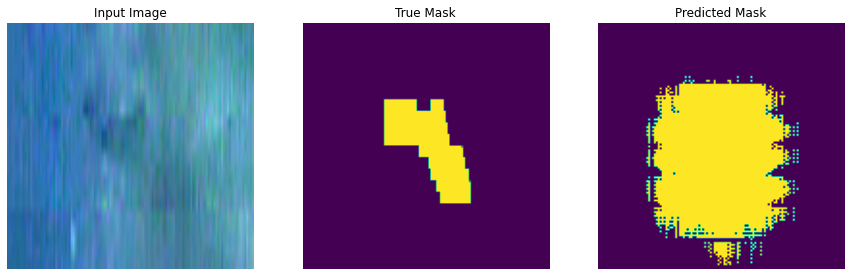


Sample Prediction after epoch 126


Epoch 00126: val_loss did not improve from 0.17000
Epoch 127/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1228 - accuracy: 0.9393 - f1: 0.1559 - precision: 0.0889 - recall: 1.0356 - val_loss: 0.1988 - val_accuracy: 0.9149 - val_f1: 0.1237 - val_precision: 0.0688 - val_recall: 0.9012


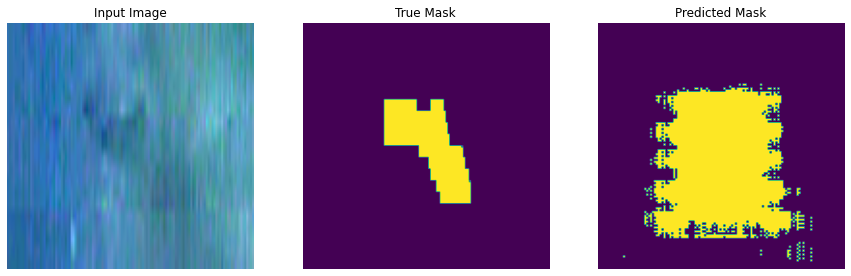


Sample Prediction after epoch 127


Epoch 00127: val_loss did not improve from 0.17000
Epoch 128/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1297 - accuracy: 0.9335 - f1: 0.1722 - precision: 0.0996 - recall: 1.0079 - val_loss: 0.2037 - val_accuracy: 0.9077 - val_f1: 0.1309 - val_precision: 0.0728 - val_recall: 0.9443


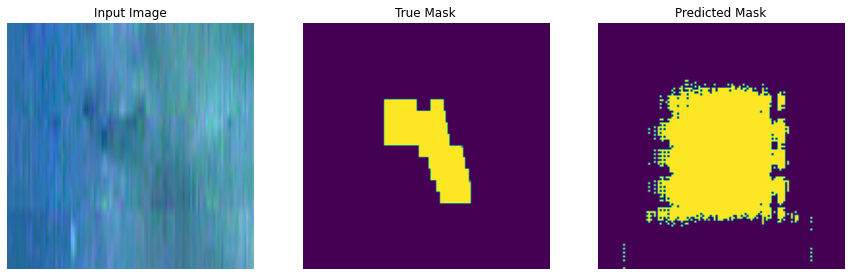


Sample Prediction after epoch 128


Epoch 00128: val_loss did not improve from 0.17000
Epoch 129/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1276 - accuracy: 0.9354 - f1: 0.1586 - precision: 0.0916 - recall: 1.0086 - val_loss: 0.2230 - val_accuracy: 0.8972 - val_f1: 0.1328 - val_precision: 0.0740 - val_recall: 0.9448


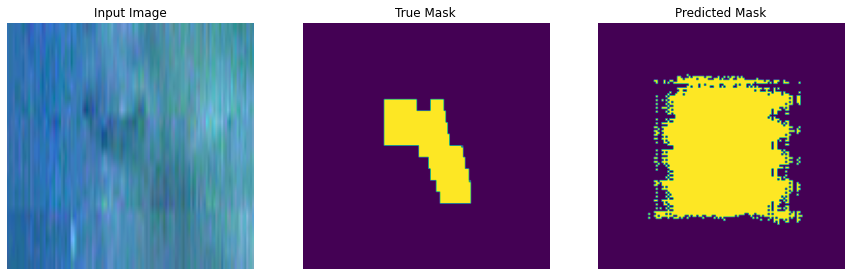


Sample Prediction after epoch 129


Epoch 00129: val_loss did not improve from 0.17000
Epoch 130/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1250 - accuracy: 0.9356 - f1: 0.1621 - precision: 0.0937 - recall: 0.9409 - val_loss: 0.2088 - val_accuracy: 0.9115 - val_f1: 0.1430 - val_precision: 0.0796 - val_recall: 1.0022


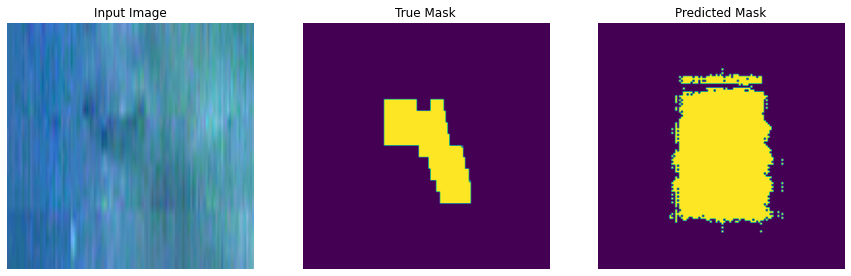


Sample Prediction after epoch 130


Epoch 00130: val_loss did not improve from 0.17000
Epoch 131/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0911 - accuracy: 0.9504 - f1: 0.1464 - precision: 0.0809 - recall: 1.0595 - val_loss: 0.2134 - val_accuracy: 0.9062 - val_f1: 0.1500 - val_precision: 0.0833 - val_recall: 1.0727


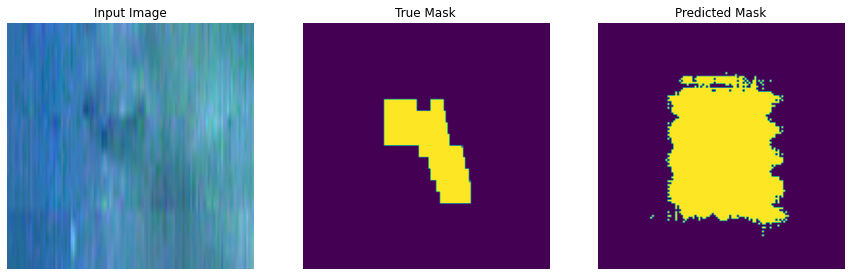


Sample Prediction after epoch 131


Epoch 00131: val_loss did not improve from 0.17000
Epoch 132/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1275 - accuracy: 0.9385 - f1: 0.1693 - precision: 0.0989 - recall: 1.0972 - val_loss: 0.2138 - val_accuracy: 0.8969 - val_f1: 0.1482 - val_precision: 0.0823 - val_recall: 1.0757


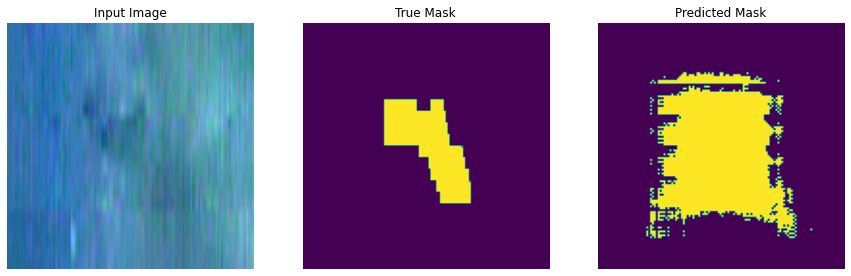


Sample Prediction after epoch 132


Epoch 00132: val_loss did not improve from 0.17000
Epoch 133/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2146 - accuracy: 0.9108 - f1: 0.1751 - precision: 0.1020 - recall: 1.0251 - val_loss: 0.2422 - val_accuracy: 0.9087 - val_f1: 0.1520 - val_precision: 0.0840 - val_recall: 1.1495


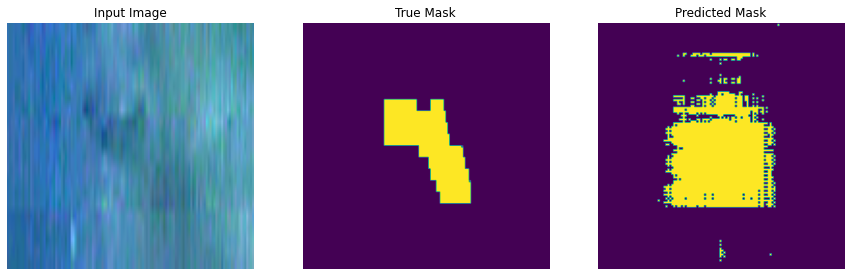


Sample Prediction after epoch 133


Epoch 00133: val_loss did not improve from 0.17000
Epoch 134/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2187 - accuracy: 0.9059 - f1: 0.1863 - precision: 0.1087 - recall: 1.2198 - val_loss: 0.4060 - val_accuracy: 0.8595 - val_f1: 0.1368 - val_precision: 0.0759 - val_recall: 1.0170


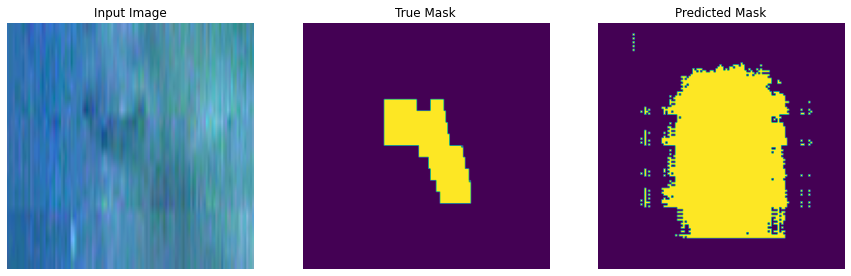


Sample Prediction after epoch 134


Epoch 00134: val_loss did not improve from 0.17000
Epoch 135/500
14/14 [==============================] - 0s 17ms/step - loss: 0.2177 - accuracy: 0.9109 - f1: 0.2021 - precision: 0.1168 - recall: 1.1376 - val_loss: 0.2498 - val_accuracy: 0.9074 - val_f1: 0.1310 - val_precision: 0.0725 - val_recall: 0.9971


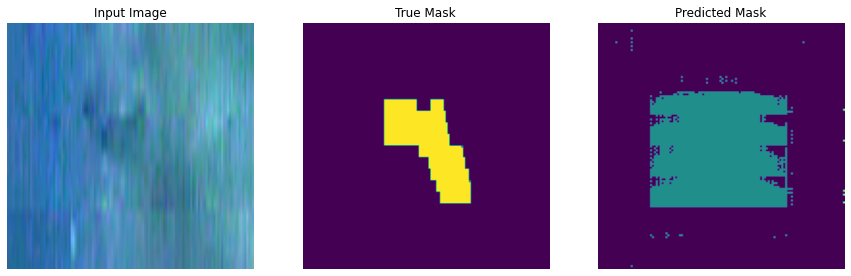


Sample Prediction after epoch 135


Epoch 00135: val_loss did not improve from 0.17000
Epoch 136/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1715 - accuracy: 0.9280 - f1: 0.1844 - precision: 0.1044 - recall: 1.2233 - val_loss: 0.2723 - val_accuracy: 0.8912 - val_f1: 0.1442 - val_precision: 0.0798 - val_recall: 1.0785


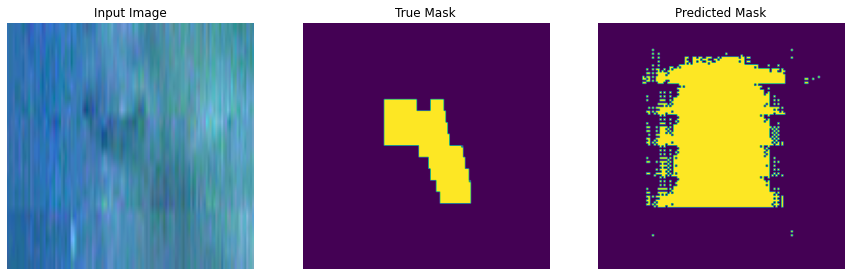


Sample Prediction after epoch 136


Epoch 00136: val_loss did not improve from 0.17000
Epoch 137/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1283 - accuracy: 0.9355 - f1: 0.1818 - precision: 0.1036 - recall: 1.1618 - val_loss: 0.2800 - val_accuracy: 0.8971 - val_f1: 0.1434 - val_precision: 0.0797 - val_recall: 1.0415


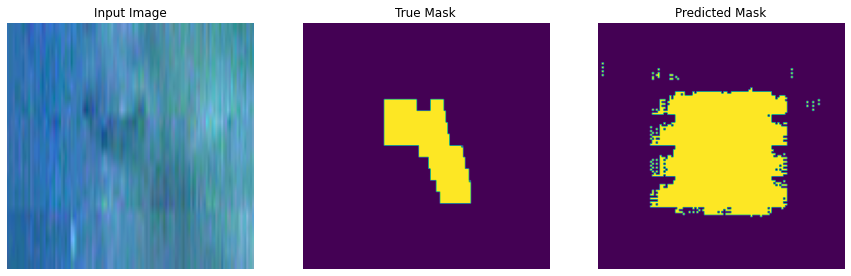


Sample Prediction after epoch 137


Epoch 00137: val_loss did not improve from 0.17000
Epoch 138/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1106 - accuracy: 0.9417 - f1: 0.1648 - precision: 0.0931 - recall: 1.1159 - val_loss: 0.2527 - val_accuracy: 0.9059 - val_f1: 0.1412 - val_precision: 0.0785 - val_recall: 1.0246


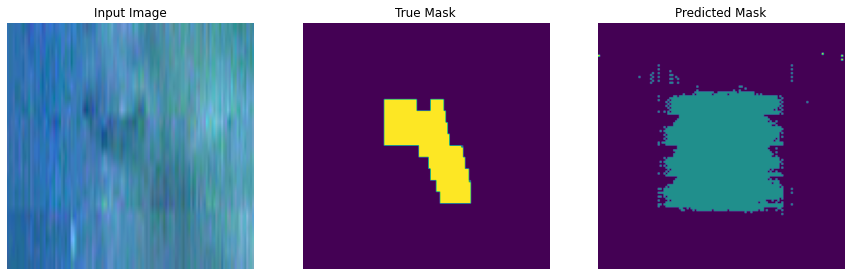


Sample Prediction after epoch 138


Epoch 00138: val_loss did not improve from 0.17000
Epoch 139/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1153 - accuracy: 0.9434 - f1: 0.1559 - precision: 0.0865 - recall: 1.0902 - val_loss: 0.3194 - val_accuracy: 0.8854 - val_f1: 0.1373 - val_precision: 0.0763 - val_recall: 1.0057


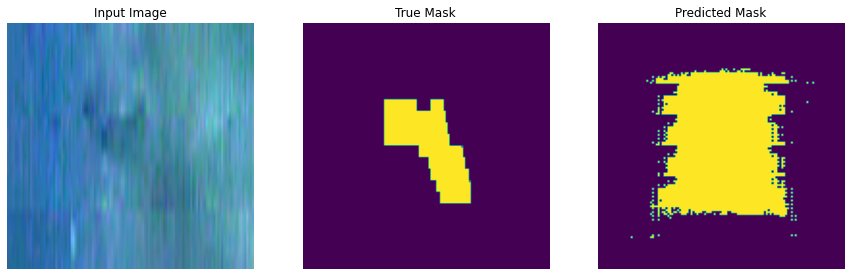


Sample Prediction after epoch 139


Epoch 00139: val_loss did not improve from 0.17000
Epoch 140/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1096 - accuracy: 0.9465 - f1: 0.1446 - precision: 0.0806 - recall: 1.0377 - val_loss: 0.2874 - val_accuracy: 0.9078 - val_f1: 0.1415 - val_precision: 0.0786 - val_recall: 1.0319


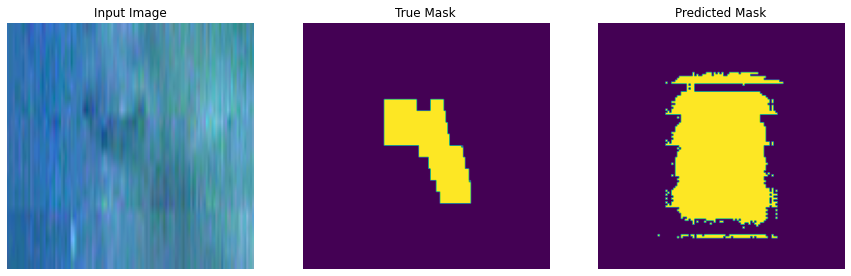


Sample Prediction after epoch 140


Epoch 00140: val_loss did not improve from 0.17000
Epoch 141/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1969 - accuracy: 0.9168 - f1: 0.1778 - precision: 0.1052 - recall: 1.0326 - val_loss: 0.3628 - val_accuracy: 0.8675 - val_f1: 0.1352 - val_precision: 0.0751 - val_recall: 0.9929


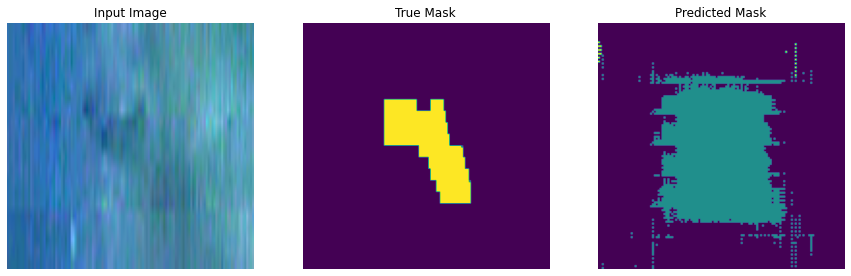


Sample Prediction after epoch 141


Epoch 00141: val_loss did not improve from 0.17000
Epoch 142/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1265 - accuracy: 0.9392 - f1: 0.1483 - precision: 0.0834 - recall: 1.0020 - val_loss: 0.3774 - val_accuracy: 0.8831 - val_f1: 0.1516 - val_precision: 0.0841 - val_recall: 1.1089


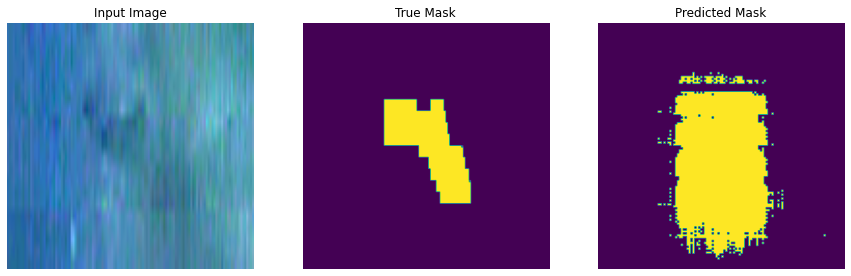


Sample Prediction after epoch 142


Epoch 00142: val_loss did not improve from 0.17000
Epoch 143/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1164 - accuracy: 0.9405 - f1: 0.1668 - precision: 0.0966 - recall: 1.0371 - val_loss: 0.3855 - val_accuracy: 0.9094 - val_f1: 0.1468 - val_precision: 0.0814 - val_recall: 1.0930


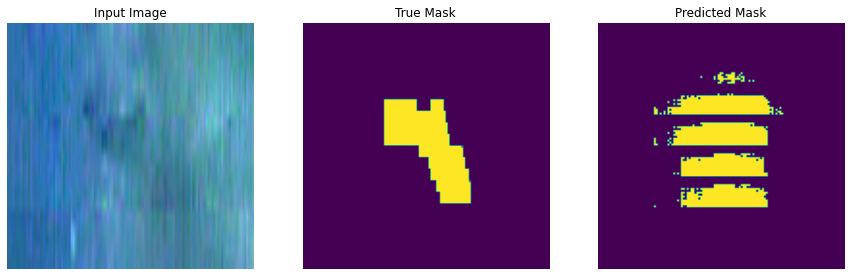


Sample Prediction after epoch 143


Epoch 00143: val_loss did not improve from 0.17000
Epoch 144/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1083 - accuracy: 0.9446 - f1: 0.1453 - precision: 0.0814 - recall: 1.1183 - val_loss: 0.3386 - val_accuracy: 0.9219 - val_f1: 0.1532 - val_precision: 0.0847 - val_recall: 1.1903


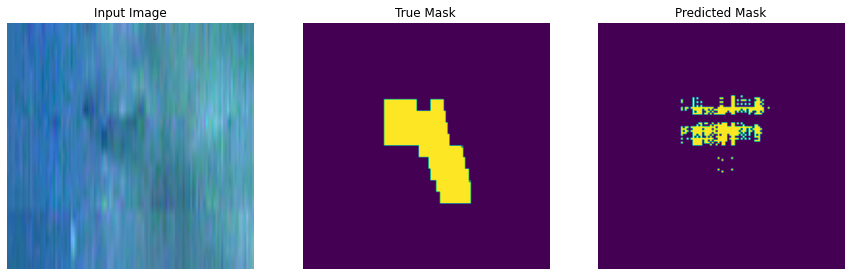


Sample Prediction after epoch 144


Epoch 00144: val_loss did not improve from 0.17000
Epoch 145/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0977 - accuracy: 0.9468 - f1: 0.1436 - precision: 0.0801 - recall: 1.0736 - val_loss: 0.2965 - val_accuracy: 0.9244 - val_f1: 0.1479 - val_precision: 0.0819 - val_recall: 1.1269


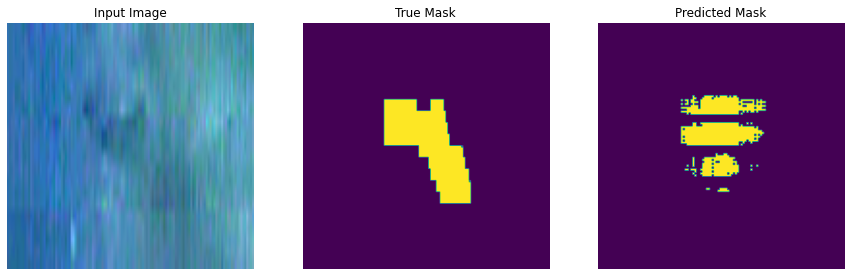


Sample Prediction after epoch 145


Epoch 00145: val_loss did not improve from 0.17000
Epoch 146/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1244 - accuracy: 0.9399 - f1: 0.1624 - precision: 0.0943 - recall: 1.0245 - val_loss: 0.2173 - val_accuracy: 0.9191 - val_f1: 0.1515 - val_precision: 0.0839 - val_recall: 1.1433


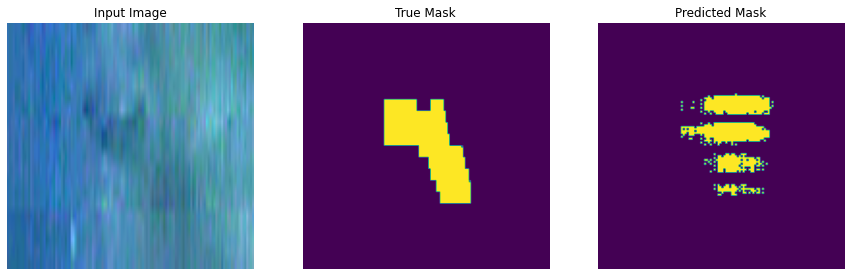


Sample Prediction after epoch 146


Epoch 00146: val_loss did not improve from 0.17000
Epoch 147/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1077 - accuracy: 0.9415 - f1: 0.1701 - precision: 0.0951 - recall: 0.9784 - val_loss: 0.3736 - val_accuracy: 0.9234 - val_f1: 0.1515 - val_precision: 0.0839 - val_recall: 1.1561


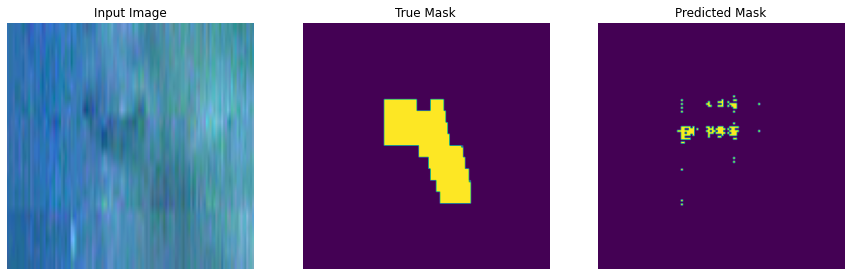


Sample Prediction after epoch 147


Epoch 00147: val_loss did not improve from 0.17000
Epoch 148/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1555 - accuracy: 0.9370 - f1: 0.1571 - precision: 0.0930 - recall: 1.0100 - val_loss: 0.2816 - val_accuracy: 0.9227 - val_f1: 0.1383 - val_precision: 0.0769 - val_recall: 1.0087


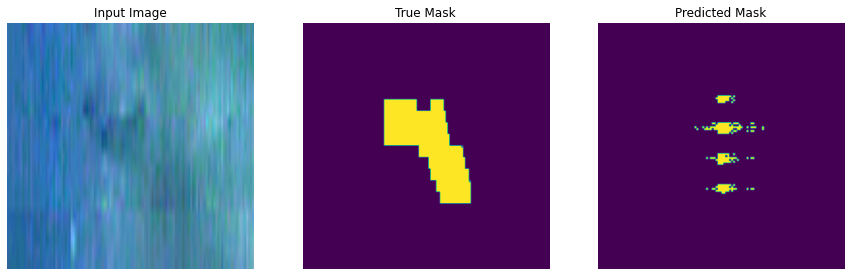


Sample Prediction after epoch 148


Epoch 00148: val_loss did not improve from 0.17000
Epoch 149/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1060 - accuracy: 0.9428 - f1: 0.1476 - precision: 0.0832 - recall: 0.9922 - val_loss: 0.4280 - val_accuracy: 0.9225 - val_f1: 0.1386 - val_precision: 0.0771 - val_recall: 1.0026


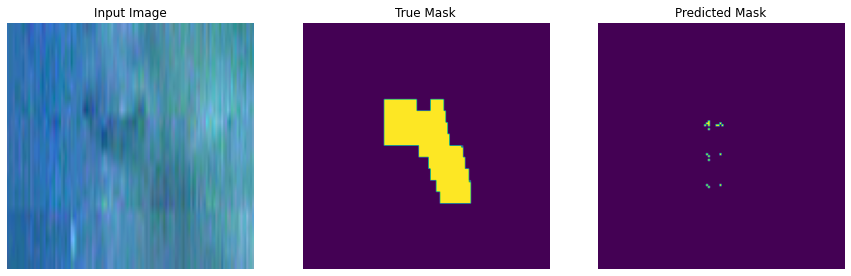


Sample Prediction after epoch 149


Epoch 00149: val_loss did not improve from 0.17000
Epoch 150/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1179 - accuracy: 0.9390 - f1: 0.1673 - precision: 0.0959 - recall: 0.9906 - val_loss: 0.4298 - val_accuracy: 0.9224 - val_f1: 0.1380 - val_precision: 0.0767 - val_recall: 1.0062


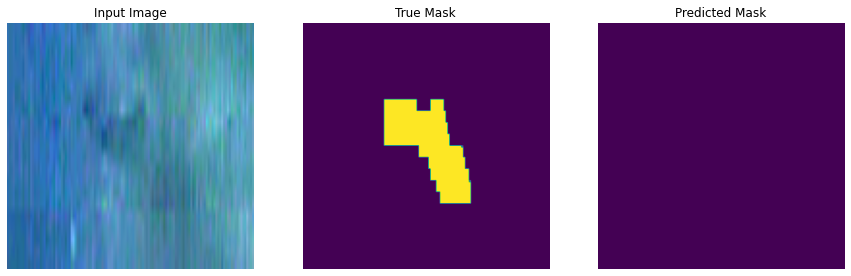


Sample Prediction after epoch 150


Epoch 00150: val_loss did not improve from 0.17000
Epoch 151/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1147 - accuracy: 0.9397 - f1: 0.1621 - precision: 0.0920 - recall: 1.0284 - val_loss: 0.3542 - val_accuracy: 0.9114 - val_f1: 0.1303 - val_precision: 0.0728 - val_recall: 0.8880


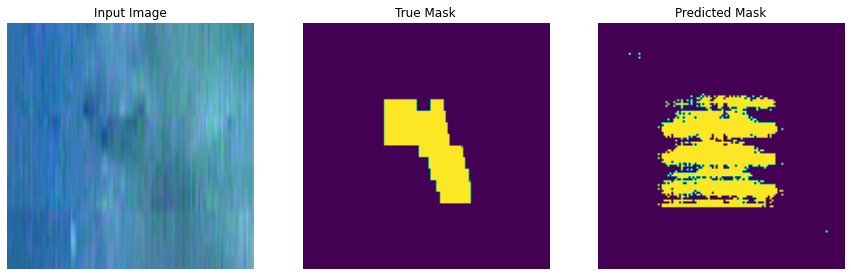


Sample Prediction after epoch 151


Epoch 00151: val_loss did not improve from 0.17000
Epoch 152/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1120 - accuracy: 0.9402 - f1: 0.1635 - precision: 0.0941 - recall: 0.9818 - val_loss: 0.4041 - val_accuracy: 0.9089 - val_f1: 0.1356 - val_precision: 0.0755 - val_recall: 0.9542


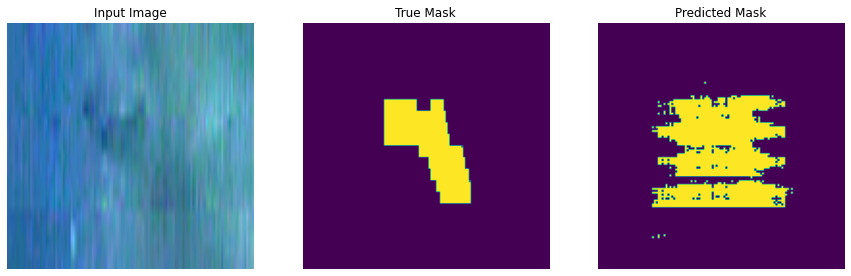


Sample Prediction after epoch 152


Epoch 00152: val_loss did not improve from 0.17000
Epoch 153/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1225 - accuracy: 0.9327 - f1: 0.1811 - precision: 0.1044 - recall: 0.9973 - val_loss: 0.3083 - val_accuracy: 0.9101 - val_f1: 0.1392 - val_precision: 0.0774 - val_recall: 1.0063


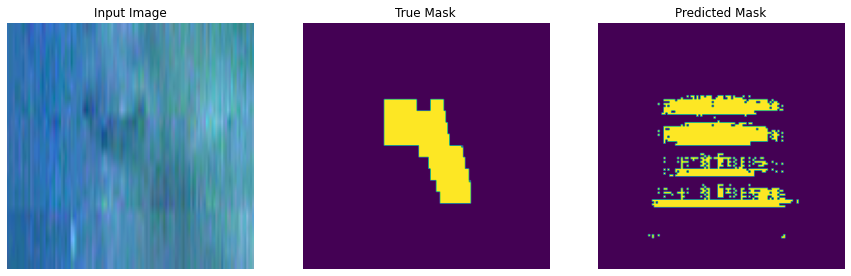


Sample Prediction after epoch 153


Epoch 00153: val_loss did not improve from 0.17000
Epoch 154/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0882 - accuracy: 0.9514 - f1: 0.1445 - precision: 0.0813 - recall: 1.0622 - val_loss: 0.3279 - val_accuracy: 0.9091 - val_f1: 0.1401 - val_precision: 0.0779 - val_recall: 1.0133


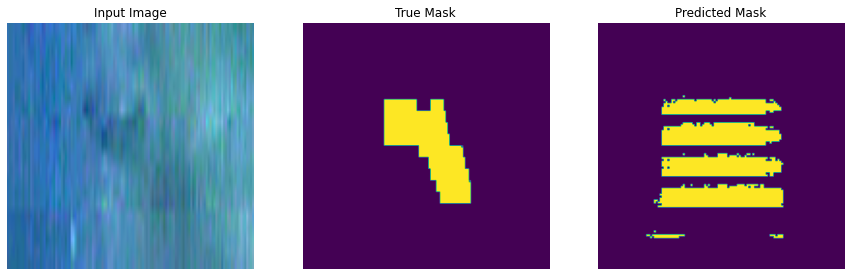


Sample Prediction after epoch 154


Epoch 00154: val_loss did not improve from 0.17000
Epoch 155/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1606 - accuracy: 0.9243 - f1: 0.1954 - precision: 0.1153 - recall: 1.0125 - val_loss: 0.4972 - val_accuracy: 0.8955 - val_f1: 0.1385 - val_precision: 0.0771 - val_recall: 0.9688


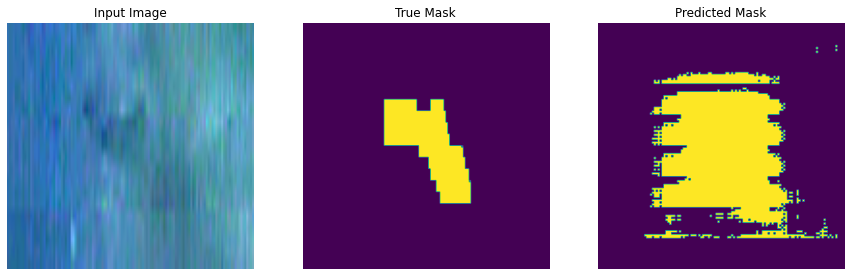


Sample Prediction after epoch 155


Epoch 00155: val_loss did not improve from 0.17000
Epoch 156/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1193 - accuracy: 0.9424 - f1: 0.1523 - precision: 0.0863 - recall: 0.9953 - val_loss: 0.4047 - val_accuracy: 0.8642 - val_f1: 0.1409 - val_precision: 0.0783 - val_recall: 1.0181


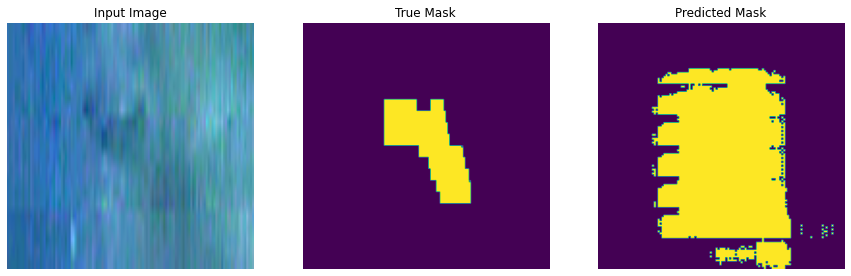


Sample Prediction after epoch 156


Epoch 00156: val_loss did not improve from 0.17000
Epoch 157/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1018 - accuracy: 0.9477 - f1: 0.1528 - precision: 0.0856 - recall: 1.0471 - val_loss: 0.2976 - val_accuracy: 0.8891 - val_f1: 0.1356 - val_precision: 0.0755 - val_recall: 0.9796


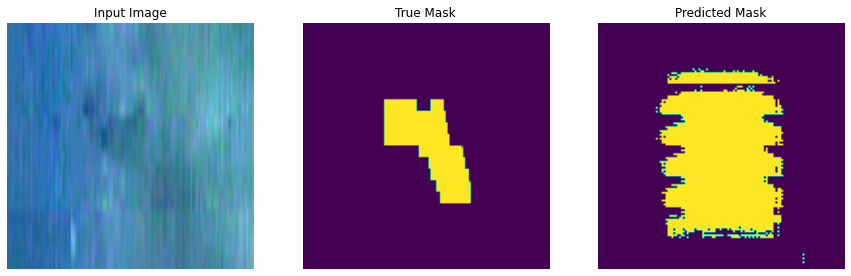


Sample Prediction after epoch 157


Epoch 00157: val_loss did not improve from 0.17000
Epoch 158/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1109 - accuracy: 0.9414 - f1: 0.1631 - precision: 0.0932 - recall: 1.0116 - val_loss: 0.3041 - val_accuracy: 0.8925 - val_f1: 0.1334 - val_precision: 0.0740 - val_recall: 0.9948


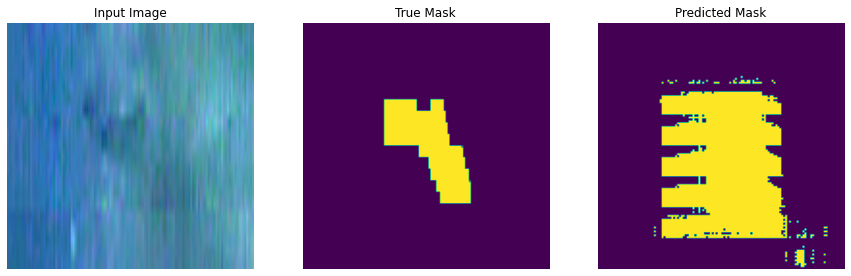


Sample Prediction after epoch 158


Epoch 00158: val_loss did not improve from 0.17000
Epoch 159/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0990 - accuracy: 0.9503 - f1: 0.1484 - precision: 0.0832 - recall: 1.0191 - val_loss: 0.2415 - val_accuracy: 0.9043 - val_f1: 0.1392 - val_precision: 0.0773 - val_recall: 1.0201


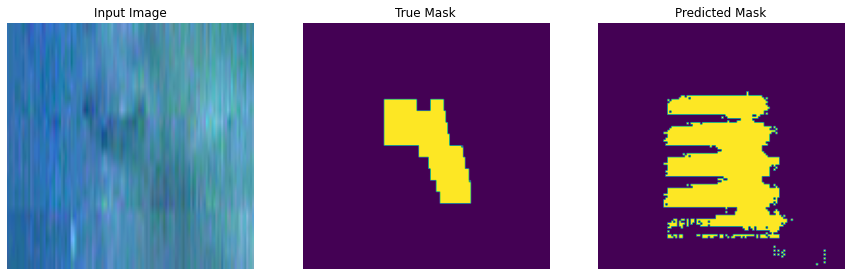


Sample Prediction after epoch 159


Epoch 00159: val_loss did not improve from 0.17000
Epoch 160/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1534 - accuracy: 0.9276 - f1: 0.1746 - precision: 0.1020 - recall: 1.0019 - val_loss: 0.3283 - val_accuracy: 0.8644 - val_f1: 0.1177 - val_precision: 0.0656 - val_recall: 0.8702


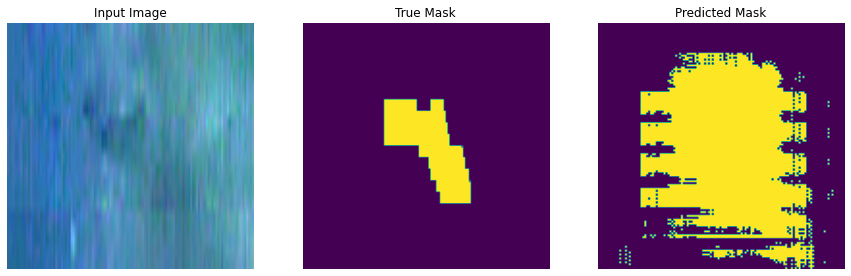


Sample Prediction after epoch 160


Epoch 00160: val_loss did not improve from 0.17000
Epoch 161/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1546 - accuracy: 0.9233 - f1: 0.1739 - precision: 0.1013 - recall: 0.9725 - val_loss: 0.2117 - val_accuracy: 0.9125 - val_f1: 0.1365 - val_precision: 0.0759 - val_recall: 0.9856


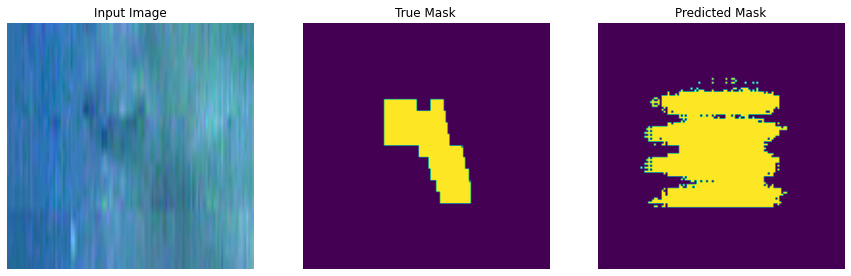


Sample Prediction after epoch 161


Epoch 00161: val_loss did not improve from 0.17000
Epoch 162/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1099 - accuracy: 0.9417 - f1: 0.1511 - precision: 0.0838 - recall: 1.0666 - val_loss: 0.1963 - val_accuracy: 0.9212 - val_f1: 0.1349 - val_precision: 0.0750 - val_recall: 0.9896


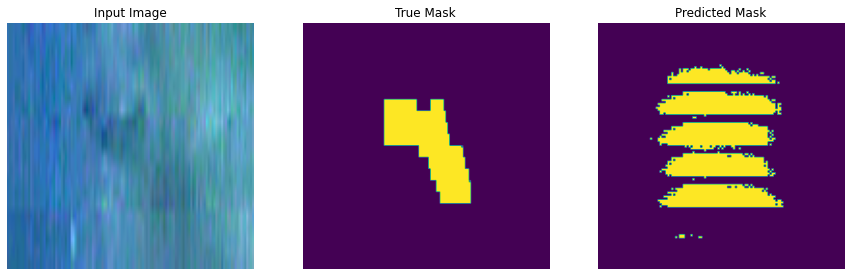


Sample Prediction after epoch 162


Epoch 00162: val_loss did not improve from 0.17000
Epoch 163/500
14/14 [==============================] - 0s 17ms/step - loss: 0.0986 - accuracy: 0.9497 - f1: 0.1460 - precision: 0.0815 - recall: 1.0549 - val_loss: 0.1948 - val_accuracy: 0.9180 - val_f1: 0.1340 - val_precision: 0.0745 - val_recall: 1.0046


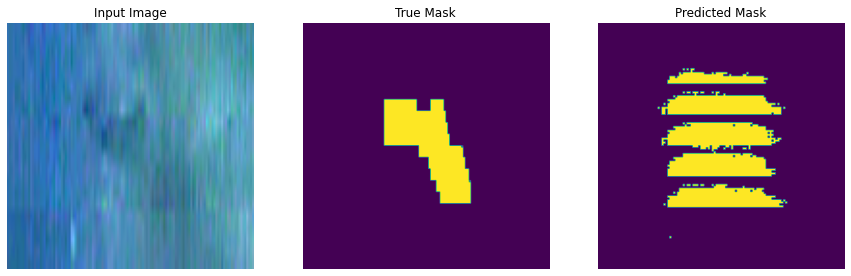


Sample Prediction after epoch 163


Epoch 00163: val_loss did not improve from 0.17000
Epoch 164/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1199 - accuracy: 0.9347 - f1: 0.1919 - precision: 0.1116 - recall: 0.9703 - val_loss: 0.2558 - val_accuracy: 0.8966 - val_f1: 0.1349 - val_precision: 0.0751 - val_recall: 1.0033


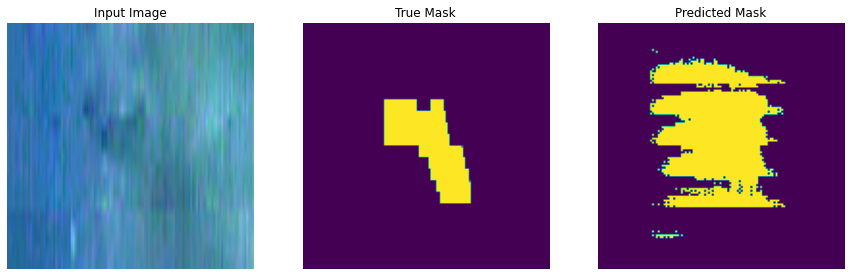


Sample Prediction after epoch 164


Epoch 00164: val_loss did not improve from 0.17000
Epoch 165/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1195 - accuracy: 0.9371 - f1: 0.1781 - precision: 0.1041 - recall: 1.0641 - val_loss: 0.1946 - val_accuracy: 0.9287 - val_f1: 0.1407 - val_precision: 0.0782 - val_recall: 1.0344


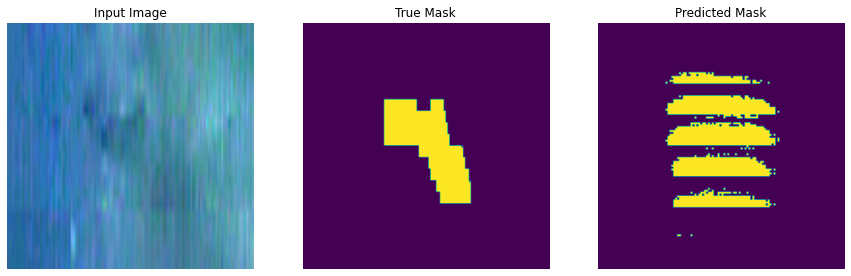


Sample Prediction after epoch 165


Epoch 00165: val_loss did not improve from 0.17000
Epoch 166/500
14/14 [==============================] - 0s 17ms/step - loss: 0.1072 - accuracy: 0.9420 - f1: 0.1627 - precision: 0.0921 - recall: 1.0097 - val_loss: 0.1753 - val_accuracy: 0.9413 - val_f1: 0.1427 - val_precision: 0.0792 - val_recall: 1.0585


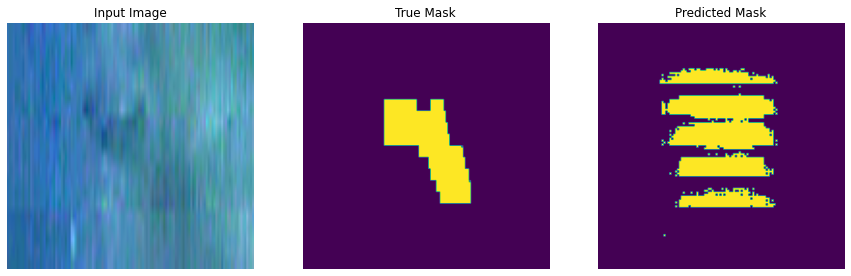


Sample Prediction after epoch 166


Epoch 00166: val_loss did not improve from 0.17000
Epoch 167/500
14/14 [==============================] - 0s 17ms/step - loss: 0.3911 - accuracy: 0.8885 - f1: 0.2006 - precision: 0.1207 - recall: 1.1207 - val_loss: 1.0916 - val_accuracy: 0.8850 - val_f1: 0.1559 - val_precision: 0.0851 - val_recall: 1.3597


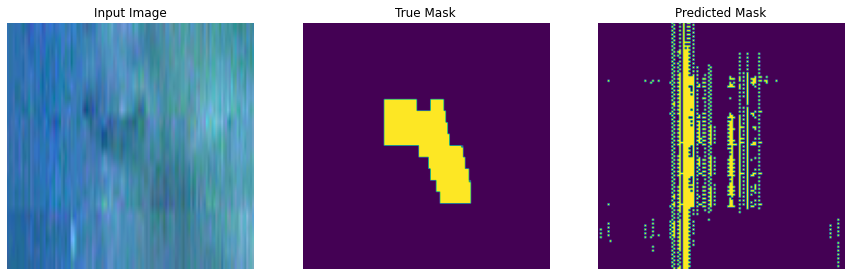


Sample Prediction after epoch 167


Epoch 00167: val_loss did not improve from 0.17000
Epoch 168/500
14/14 [==============================] - 0s 17ms/step - loss: 4.2672 - accuracy: 0.8181 - f1: 0.1945 - precision: 0.1098 - recall: 1.2730 - val_loss: 18.1269 - val_accuracy: 0.9080 - val_f1: 0.1450 - val_precision: 0.0802 - val_recall: 1.1147


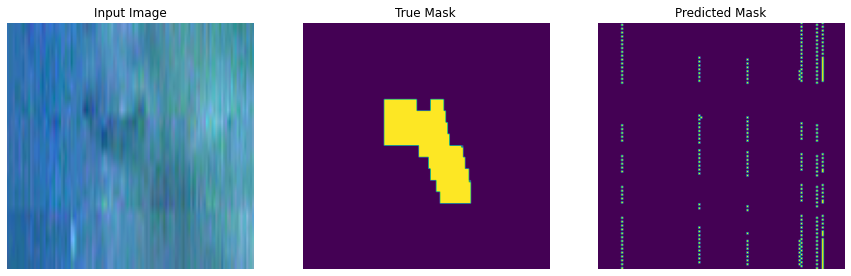


Sample Prediction after epoch 168


Epoch 00168: val_loss did not improve from 0.17000
Epoch 00168: early stopping


In [39]:
CALLBACKS = [
    DisplayCallback(),
    early_stopping_callback,
    model_checkpoint_callback,
]

model_history = model.fit(train_batches, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_steps=VALIDATION_STEPS,
                          validation_data=test_batches,
                          callbacks=CALLBACKS)

### Plot the measured model measurement

In [40]:
figure_size_cm = (45, 25)
figure_size_inches = (figure_size_cm[0]/2.54, figure_size_cm[1]/2.54)

epochs_num = [(e+1) for e in model_history.epoch]
xticks_to_show = 15
xtick_num = [(e+1) for e in model_history.epoch if e%(epochs_num[-1]//(xticks_to_show-1)) == 0]
xtick_num.append(epochs_num[-1])
ytick_stepping = 5

modelMeasurement(variable=loss)


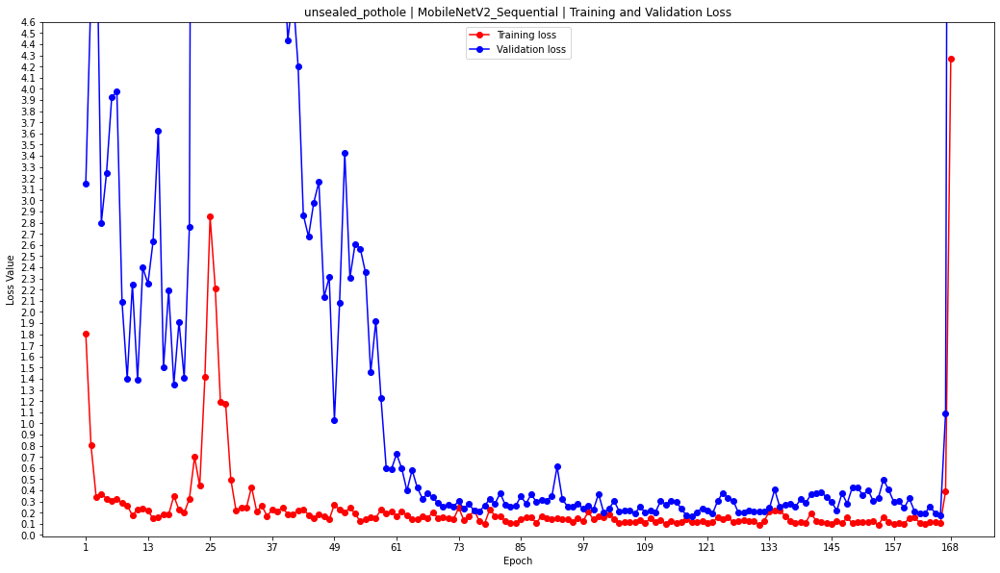

From the graph above:
min_vals = [0.08818908035755157, 0.16999591886997223]
min_val = 0.08818908035755157
max_vals = [4.267167568206787, 174.50238037109375]
max_val = 4.5

modelMeasurement(variable=accuracy)


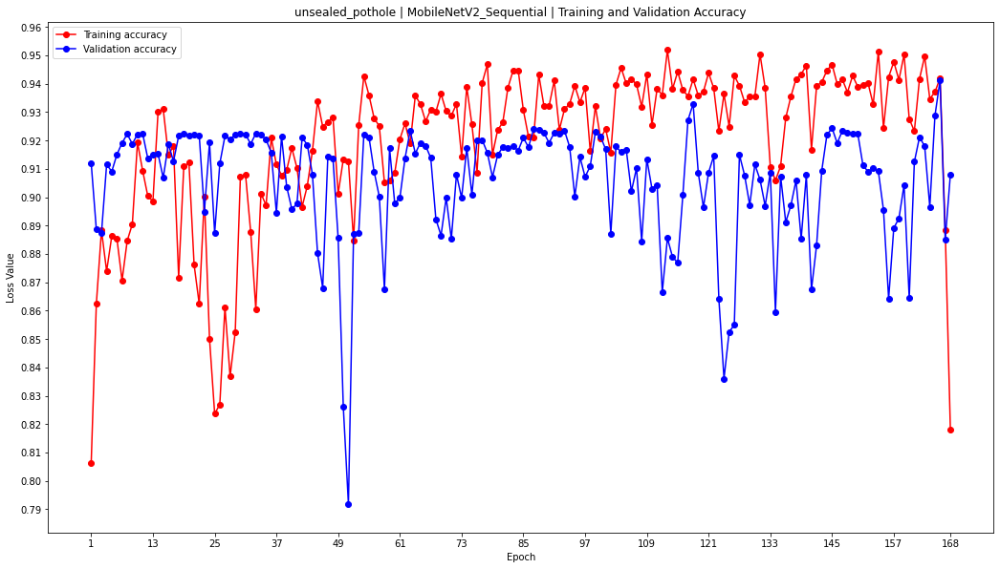

From the graph above:
min_vals = [0.8062286376953125, 0.7917887568473816]
min_val = 0.7917887568473816
max_vals = [0.9518541693687439, 0.9413350224494934]
max_val = 0.9518541693687439

precision_recall_f1()


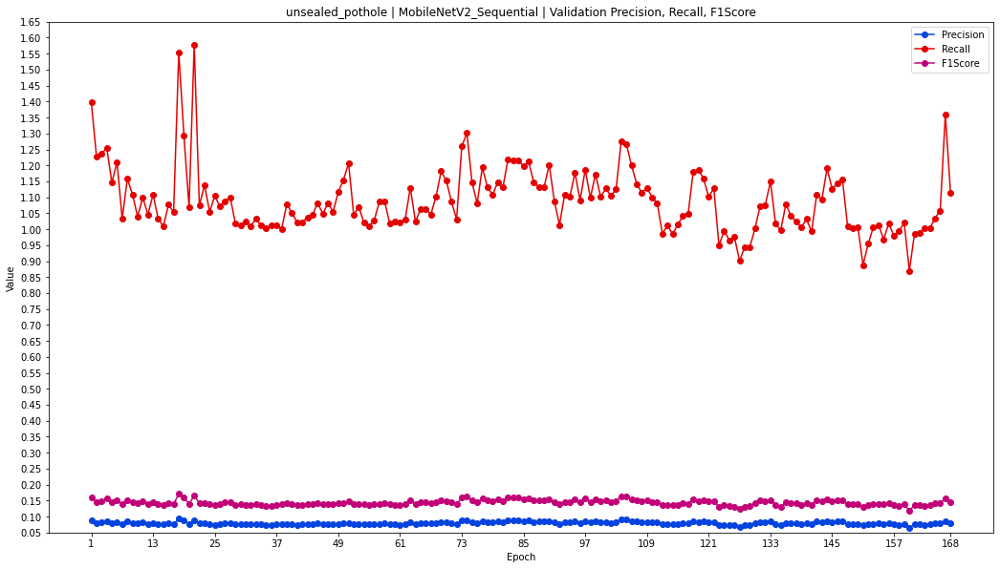

From the graph above:
min_vals = [0.06560521572828293, 0.8701906800270081, 0.11772666126489639]
min_val = 0.06560521572828293
max_vals = [0.09306594729423523, 1.5776335000991821, 0.1711398810148239]
max_val = 1.5776335000991821



In [45]:
variable = 'precision'
from math import floor, ceil

def modelMeasurement(variable='loss', ytick_step=ytick_stepping):
    print(f"modelMeasurement(variable={variable})")
    v = model_history.history[variable]
    val_v = model_history.history[f'val_{variable}']

    #print("Creating plot...")
    plt.figure(figsize=figure_size_inches)
    plt.plot(epochs_num, v, '-ro', label=f'Training {variable}')
    plt.plot(epochs_num, val_v, '-bo', label=f'Validation {variable}')
    plt.title(f'{DATASET_TYPE} | {MODEL_NAME} | Training and Validation {variable.capitalize()}')
    plt.xticks(xtick_num)

    #print("Determining min_vals...")
    min_vals = [min(v), min(val_v)]
    min_val = min(min_vals)
    #print(f"min_val = {min_val}")

    #print("Determining max_vals...")
    max_vals = [max(v), max(val_v)]
    max_val = max(max_vals)
    #print(f"max_val = {max_val}")
    
    new_val = max_val
    new_val = 4.5
    if max_val > new_val:
        max_val = new_val
    
    #print("Determining ytick_ticks...")
    ytick_ticks = [y*0.01 for y in range(floor(min_val*100)-1*ytick_step, ceil(max_val*100)+2*ytick_step) if y%ytick_step == 0]

    #print("Plotting yticks...")
    plt.yticks(ytick_ticks)
    plt.xlabel('Epoch')
    plt.ylabel('Loss Value')
    plt.ylim([min_val-0.01*ytick_step, max_val+0.01*ytick_step])
    plt.legend()
    plt.show()

    print("From the graph above:")
    print(f"min_vals = {min_vals}")
    print(f"min_val = {min_val}")
    print(f"max_vals = {max_vals}")
    print(f"max_val = {max_val}")
    print()
    
def precision_recall_f1(ytick_step=ytick_stepping):
    print(f"precision_recall_f1()")
    # Validation Precision, Recall, F1Score
    figure_title = f'{DATASET_TYPE} | {MODEL_NAME} | Validation Precision, Recall, F1Score'
    val_p = model_history.history['val_precision']
    val_r = model_history.history['val_recall']
    val_f = model_history.history['val_f1']

    plt.figure(figsize=figure_size_inches)
    plt.plot(epochs_num, val_p, '-o', \
             color='xkcd:blue', label='Precision')
    plt.plot(epochs_num, val_r, '-o', \
            color='xkcd:red', label='Recall')
    plt.plot(epochs_num, val_f, '-o', \
            color='xkcd:magenta', label='F1Score')
    plt.title(figure_title)
    plt.xticks(xtick_num)

    #print("Determining min_vals...")
    min_vals = [min(val_p), min(val_r), min(val_f)]
    min_val = min(min_vals)
    #print(f"min_val = {min_val}")

    #print("Determining max_vals...")
    max_vals = [max(val_p), max(val_r), max(val_f)]
    max_val = max(max_vals)
    #print(f"max_val = {max_val}")
    
    #print("Determining ytick_ticks...")
    ytick_ticks = [y*0.01 for y in range(floor(min_val*100)-1*ytick_step, ceil(max_val*100)+2*ytick_step) if y%ytick_step == 0]
    ##print(ytick_ticks)
    
    #print("Plotting yticks...")
    plt.yticks(ytick_ticks)
    plt.xlabel('Epoch')
    plt.ylabel('Value')
    plt.ylim([min_val-0.01*ytick_step, max_val+0.01*ytick_step])
    plt.ylim([ytick_ticks[0], ytick_ticks[-1]])
    plt.legend()
    plt.show()

    print("From the graph above:")
    print(f"min_vals = {min_vals}")
    print(f"min_val = {min_val}")
    print(f"max_vals = {max_vals}")
    print(f"max_val = {max_val}")
    print()

modelMeasurement(variable='loss', ytick_step=10)
modelMeasurement(variable='accuracy', ytick_step=1)
precision_recall_f1()

Create the plots:
- training_and_validation_loss.png
- training_and_validation_accuracy.png
- validation_precision_recall_f1score.png

In [42]:
ERROR HERE!

SyntaxError: invalid syntax (2341246408.py, line 1)

## Time and Measure Predictions

TODO: Manually find the checkpoint filepath and update the strings below to reflect it.

In [46]:
# The model weights (that are considered the best)
# are loaded into the model.
checkpoint_filepath = '../weights/new_modified_saved_weights/'
checkpoint_filepath += 'modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0118-0.17-0.93.hdf5'

print(checkpoint_filepath)
model.load_weights(checkpoint_filepath)

../weights/new_modified_saved_weights/modified_unsealed_pothole-MobileNetV2_Sequential-weights-improvement-0118-0.17-0.93.hdf5


Create the images:
- test_batch_prediction-n_1.png

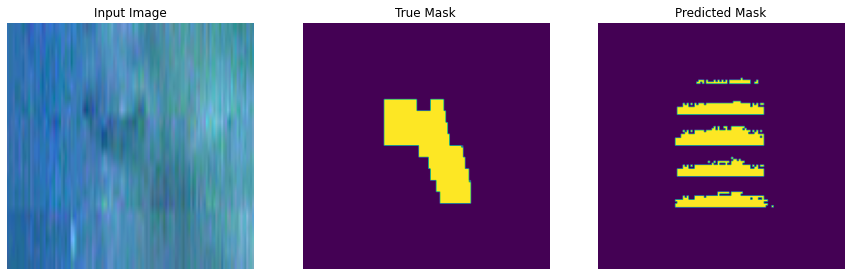

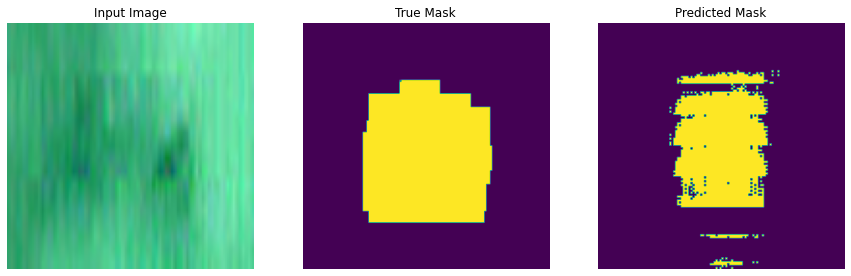

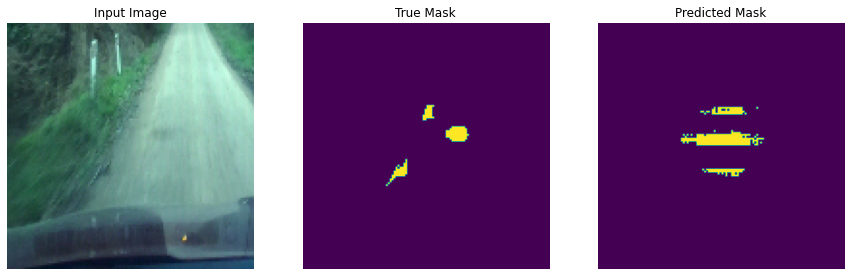

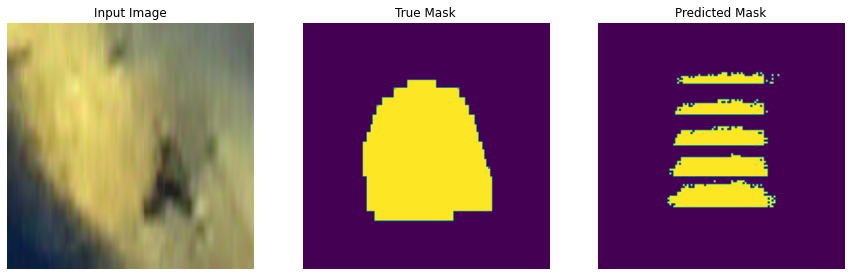

In [47]:
if DEBUG:
    print(len(test_batches))
show_predictions(test_batches, len(test_batches))

Create the images:
- ver_batch_prediction-n_1.png

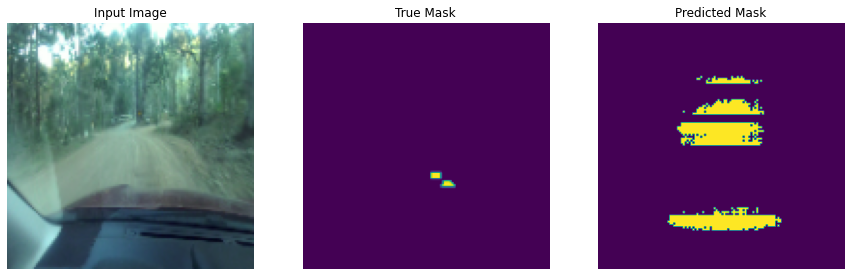

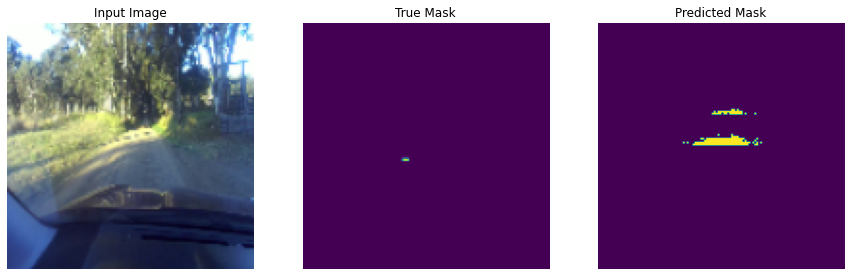

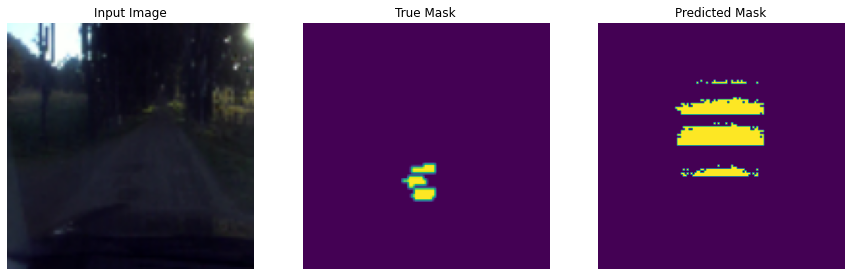

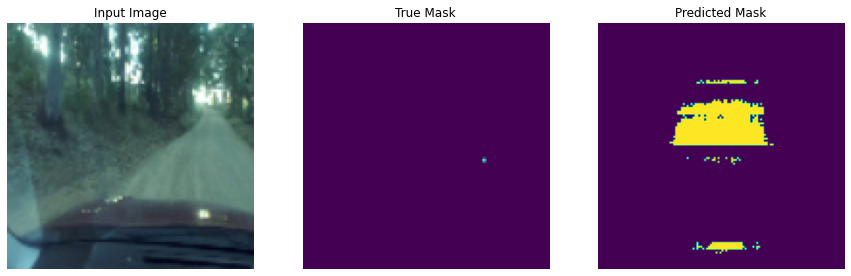

In [48]:
if DEBUG:
    pass
show_predictions(ver_batches, 4)

## Time predictions

In [49]:
import time
from statistics import mean, median, mode
# time.time_ns()
num_pred = 10
flt_pt = 4

pred_accuracy = []
pred_precision = []
pred_recall = []
pred_f1 = []
pred_conf = []

"""
            pred_mask = model.predict(image_and_depth)
            displayImages([image_and_depth[0][0], image_and_depth[1][0], mask[0], create_mask(pred_mask)])
"""

def timePredictions(dataset, num_predictions=10, show_images=False):
    timings = []
    for image_and_depth, mask in dataset.take(num_predictions):
        start_time = time.time_ns()
        pred_mask = model.predict(image_and_depth)
        stop_time = time.time_ns()
        
        created_pred_mask = tf.cast(create_mask(pred_mask), tf.float32)
        
        timings.append(stop_time-start_time)
        pred_accuracy.append(accuracy(mask[0], created_pred_mask).numpy())
        pred_precision.append(precision(mask[0], created_pred_mask).numpy())
        pred_recall.append(recall(mask[0], created_pred_mask).numpy())
        pred_f1.append(f1(mask[0], created_pred_mask).numpy())
        pred_conf.append(confusion_matrix(mask[0], created_pred_mask))
        
        print(f"Show number {len(timings)} prediction...")
        if show_images:
            displayImages([image_and_depth[0][0], image_and_depth[1][0], mask[0], created_pred_mask])
        print(f"Number {len(timings)}'s prediction took: {timings[-1]} ns.")
        print(f"Number {len(timings)}'s prediction has:\n\t" +
              f"accuracy {pred_accuracy[-1]:.{flt_pt}f}, precision {pred_precision[-1]:.{flt_pt}f}, " +
              f"recall {pred_recall[-1]:.{flt_pt}f}, f1score {pred_f1[-1]:.{flt_pt}f}")
        print(f"Number {len(timings)}'s confusion matrix: {pred_conf[-1]}")
        print()

    print()
    print(f"Min time to predict = {min(timings):.{flt_pt}f} ns.")
    print(f"Max time to predict = {max(timings):.{flt_pt}f} ns.")
    print(f"Mean/Avg. time to predict = {mean(timings):.{flt_pt}f} ns.")
    print(f"Median time to predict = {median(timings):.{flt_pt}f} ns.")
    
    print()
    print(f"accuracy = {pred_accuracy}")
    print(f"precision = {pred_precision}")
    print(f"recall = {pred_recall}")
    print(f"f1score = {pred_f1}")
    

In [50]:
num_predictions = 100
timePredictions(ver_batches, num_predictions=num_predictions)

Show number 1 prediction...
Number 1's prediction took: 28199278 ns.
Number 1's prediction has:
	accuracy 0.9335, precision 0.0000, recall 0.0000, f1score 0.0000
Number 1's confusion matrix: {'tp': 0.0, 'fp': 1053.0, 'fn': 37.0, 'tn': 15294.0}

Show number 2 prediction...
Number 2's prediction took: 28337380 ns.
Number 2's prediction has:
	accuracy 0.9939, precision 0.0000, recall 0.0000, f1score 0.0000
Number 2's confusion matrix: {'tp': 0.0, 'fp': 93.0, 'fn': 7.0, 'tn': 16284.0}

Show number 3 prediction...
Number 3's prediction took: 27296786 ns.
Number 3's prediction has:
	accuracy 0.9165, precision 0.0000, recall 0.0000, f1score 0.0000
Number 3's confusion matrix: {'tp': 0.0, 'fp': 1367.0, 'fn': 1.0, 'tn': 15016.0}

Show number 4 prediction...
Number 4's prediction took: 27043865 ns.
Number 4's prediction has:
	accuracy 0.9427, precision 0.0467, recall 0.2167, f1score 0.0768
Number 4's confusion matrix: {'tp': 39.0, 'fp': 797.0, 'fn': 141.0, 'tn': 15407.0}

Show number 5 predictio

Show number 37 prediction...
Number 37's prediction took: 27696356 ns.
Number 37's prediction has:
	accuracy 0.9440, precision 0.0289, recall 0.1361, f1score 0.0477
Number 37's confusion matrix: {'tp': 23.0, 'fp': 772.0, 'fn': 146.0, 'tn': 15443.0}

Show number 38 prediction...
Number 38's prediction took: 27417917 ns.
Number 38's prediction has:
	accuracy 0.9890, precision 0.0000, recall 0.0000, f1score 0.0000
Number 38's confusion matrix: {'tp': 0.0, 'fp': 172.0, 'fn': 8.0, 'tn': 16204.0}

Show number 39 prediction...
Number 39's prediction took: 27389495 ns.
Number 39's prediction has:
	accuracy 0.9664, precision 0.0000, recall 0.0000, f1score 0.0000
Number 39's confusion matrix: {'tp': 0.0, 'fp': 492.0, 'fn': 59.0, 'tn': 15833.0}

Show number 40 prediction...
Number 40's prediction took: 30383738 ns.
Number 40's prediction has:
	accuracy 0.8569, precision 0.0004, recall 1.0000, f1score 0.0009
Number 40's confusion matrix: {'tp': 1.0, 'fp': 2344.0, 'fn': 0.0, 'tn': 14039.0}

Show nu

Show number 73 prediction...
Number 73's prediction took: 28958195 ns.
Number 73's prediction has:
	accuracy 0.8684, precision 0.0005, recall 1.0000, f1score 0.0009
Number 73's confusion matrix: {'tp': 1.0, 'fp': 2156.0, 'fn': 0.0, 'tn': 14227.0}

Show number 74 prediction...
Number 74's prediction took: 30971981 ns.
Number 74's prediction has:
	accuracy 0.9417, precision 0.0242, recall 0.1170, f1score 0.0402
Number 74's confusion matrix: {'tp': 20.0, 'fp': 805.0, 'fn': 151.0, 'tn': 15408.0}

Show number 75 prediction...
Number 75's prediction took: 27352228 ns.
Number 75's prediction has:
	accuracy 0.9546, precision 0.0000, recall 0.0000, f1score 0.0000
Number 75's confusion matrix: {'tp': 0.0, 'fp': 739.0, 'fn': 5.0, 'tn': 15640.0}

Show number 76 prediction...
Number 76's prediction took: 27559840 ns.
Number 76's prediction has:
	accuracy 0.9434, precision 0.0000, recall 0.0000, f1score 0.0000
Number 76's confusion matrix: {'tp': 0.0, 'fp': 926.0, 'fn': 1.0, 'tn': 15457.0}

Show num